**1. Initial Data Assessment & Preprocessing**

In [ ]:
!pip install nltk

[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


Tabular Data Shape: (6388, 28)
Textual Data Shape: (6388, 4)
Merged Data Shape: (6388, 31)

Missing values in tabular data:
Age                      296
Weight_kg                774
BMI                      651
Daily_Caloric_Intake    1296
Protein_Intake          1029
Fat_Intake              1569
Carbohydrate_Intake     1600
Water_Intake            1144
Metabolic_Rate          1325
Heart_Rate              1072
Respiratory_Rate         941
CRP_mg_L                 319
Leptin_ng_mL             315
Ghrelin_pg_mL            339
Insulin_uU_mL            332
Glucose_mg_dL            302
Insulin_Resistance       313
Cortisol_ug_dL           333
Albumin_g_dL             328
Triglycerides_mg_dL      326
Cholesterol_mg_dL        312
Vitamin_E_IU             325
Bone_Tscore              310
Ambient_Humidity         317
dtype: int64


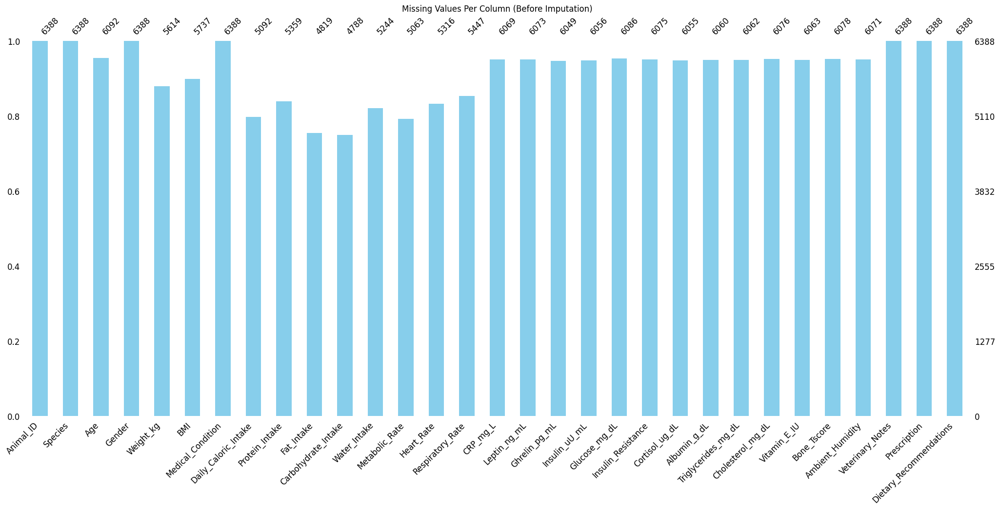

In [ ]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.feature_selection import SelectKBest, f_classif, mutual_info_classif
from statsmodels.stats.outliers_influence import variance_inflation_factor
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
import re
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import TruncatedSVD
from wordcloud import WordCloud
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import missingno as msno
import warnings
warnings.filterwarnings('ignore')

# Download NLTK resources
nltk.download('punkt_tab')
nltk.download('stopwords')
nltk.download('wordnet')

# Load datasets
tabular_data = pd.read_csv('/content/synthetic_tabular_dataset.csv')
textual_data = pd.read_csv('/content/synthetic_textual_dataset.csv')

# Display basic information
print("Tabular Data Shape:", tabular_data.shape)
print("Textual Data Shape:", textual_data.shape)

# Merge datasets on Animal_ID
merged_data = pd.merge(tabular_data, textual_data, on='Animal_ID', how='inner')
print("Merged Data Shape:", merged_data.shape)

# Check for missing values in tabular data
print("\nMissing values in tabular data:")
missing_values_tabular = merged_data.isnull().sum()
print(missing_values_tabular[missing_values_tabular > 0])
plt.figure(figsize=(10, 6))
msno.bar(merged_data, fontsize=12, color='skyblue')
plt.title("Missing Values Per Column (Before Imputation)")
plt.show()


**Preprocessing Tabular Data**

===== Starting Tabular Data Preprocessing =====
Initial shape: (6388, 31)
Identified Numerical Columns: ['Age', 'Weight_kg', 'BMI', 'Daily_Caloric_Intake', 'Protein_Intake', 'Fat_Intake', 'Carbohydrate_Intake', 'Water_Intake', 'Metabolic_Rate', 'Heart_Rate', 'Respiratory_Rate', 'CRP_mg_L', 'Leptin_ng_mL', 'Ghrelin_pg_mL', 'Insulin_uU_mL', 'Glucose_mg_dL', 'Insulin_Resistance', 'Cortisol_ug_dL', 'Albumin_g_dL', 'Triglycerides_mg_dL', 'Cholesterol_mg_dL', 'Vitamin_E_IU', 'Bone_Tscore', 'Ambient_Humidity']
Identified Categorical Columns: ['Species', 'Gender', 'Medical_Condition', 'Activity_Level']

Missing values in numerical columns have been imputed using median.
Missing Values After Imputation:
Age                     0
Weight_kg               0
BMI                     0
Daily_Caloric_Intake    0
Protein_Intake          0
Fat_Intake              0
Carbohydrate_Intake     0
Water_Intake            0
Metabolic_Rate          0
Heart_Rate              0
Respiratory_Rate        0
CRP_mg_L  

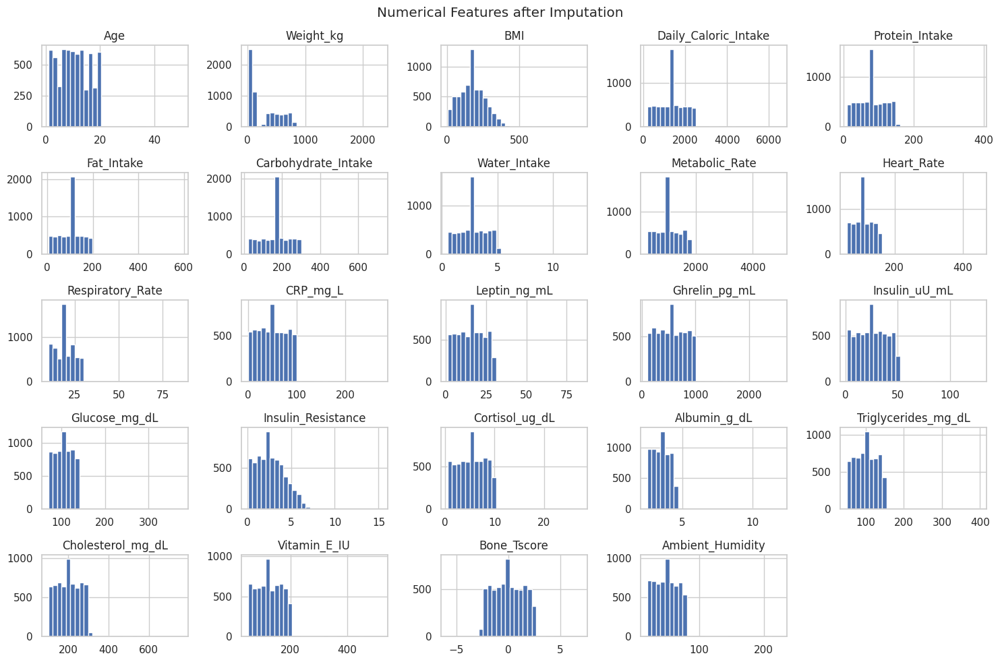

Missing values after imputation:
Animal_ID                  0
Species                    0
Age                        0
Gender                     0
Weight_kg                  0
BMI                        0
Medical_Condition          0
Daily_Caloric_Intake       0
Protein_Intake             0
Fat_Intake                 0
Carbohydrate_Intake        0
Water_Intake               0
Metabolic_Rate             0
Heart_Rate                 0
Respiratory_Rate           0
CRP_mg_L                   0
Leptin_ng_mL               0
Ghrelin_pg_mL              0
Insulin_uU_mL              0
Glucose_mg_dL              0
Insulin_Resistance         0
Cortisol_ug_dL             0
Albumin_g_dL               0
Triglycerides_mg_dL        0
Cholesterol_mg_dL          0
Vitamin_E_IU               0
Bone_Tscore                0
Ambient_Humidity           0
Veterinary_Notes           0
Prescription               0
Dietary_Recommendations    0
dtype: int64


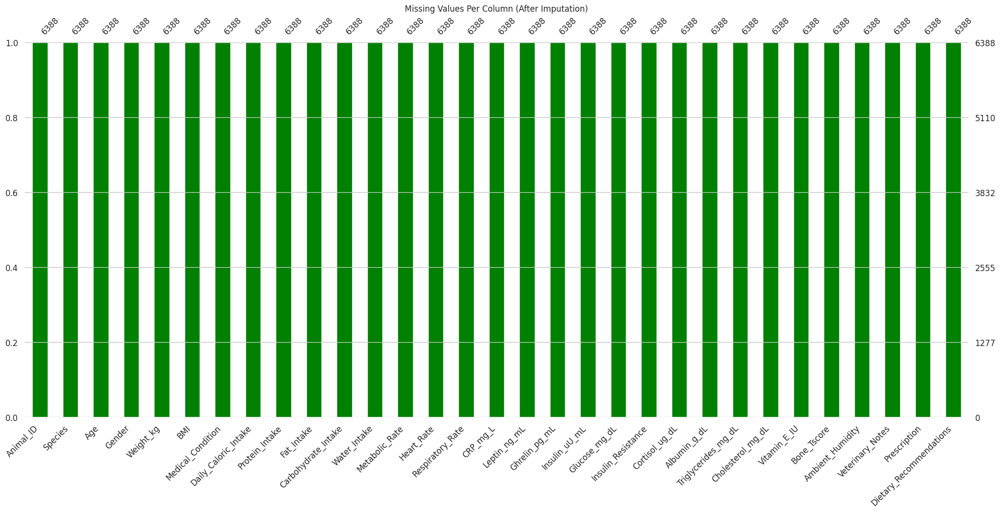

Missing values in categorical columns have been filled with the mode.


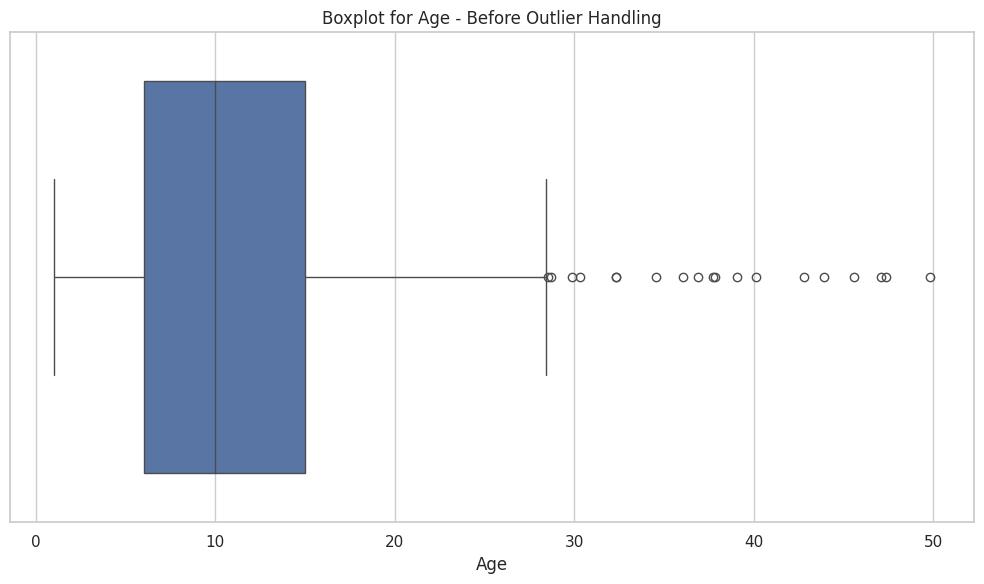

Found 19 outliers in Age


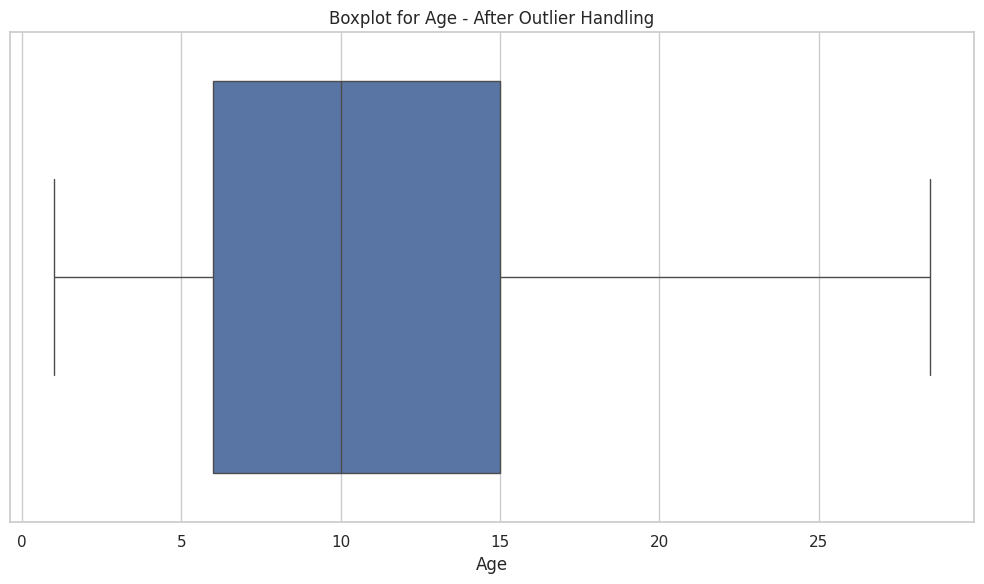

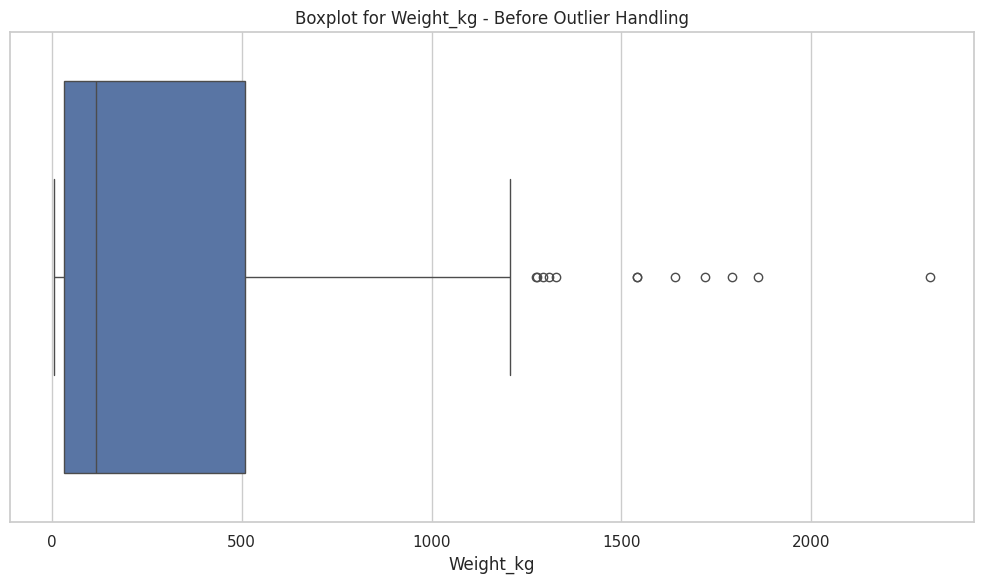

Found 12 outliers in Weight_kg


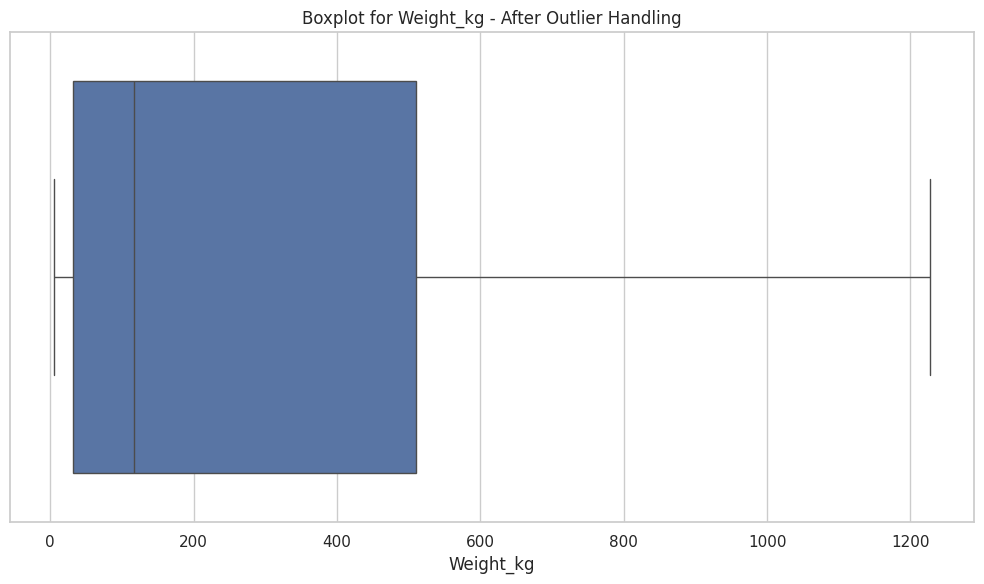

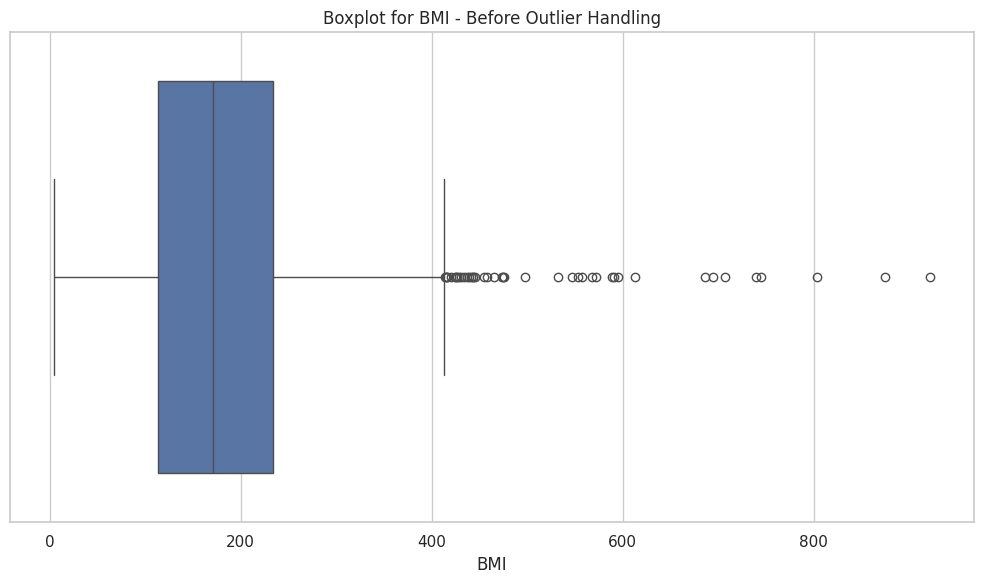

Found 42 outliers in BMI


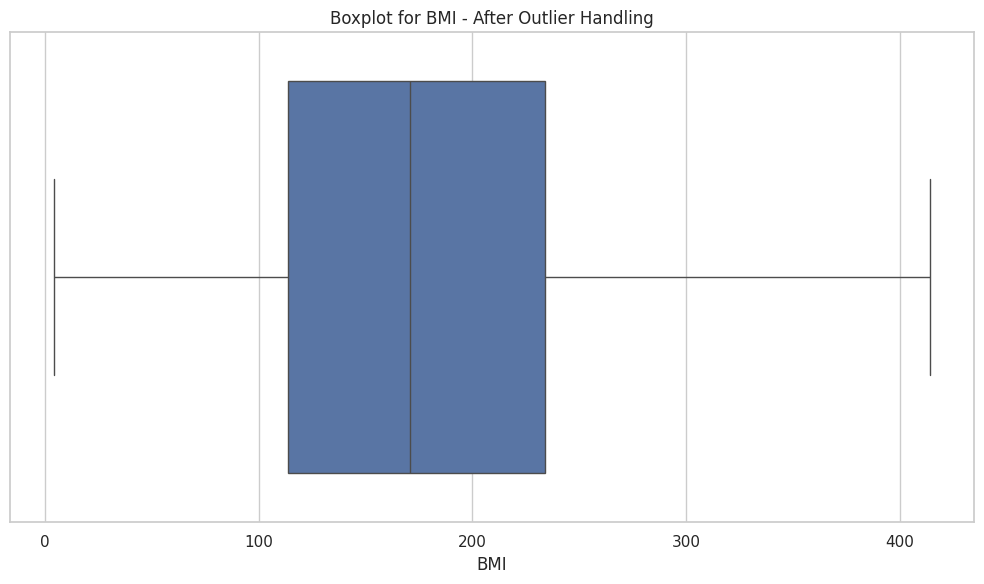

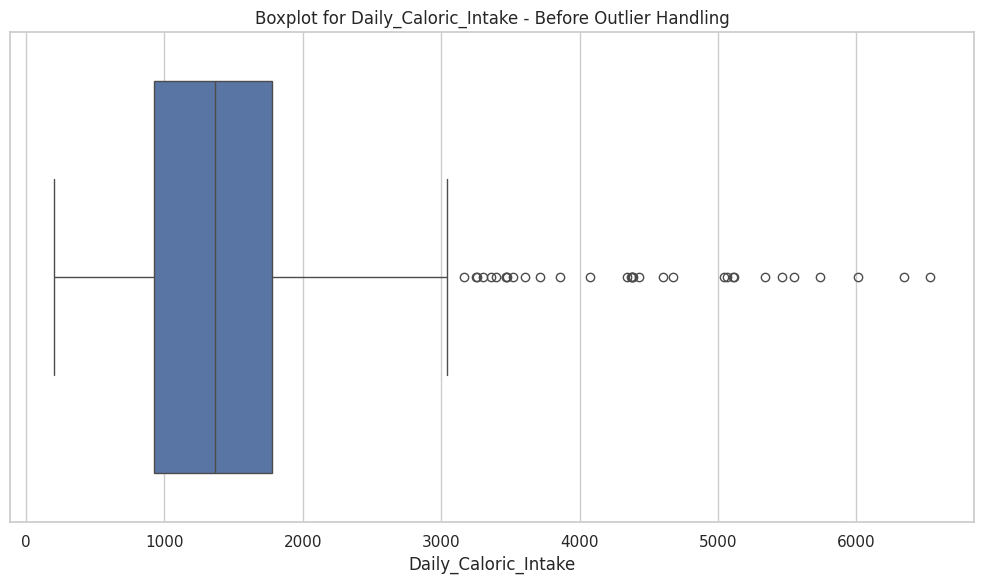

Found 33 outliers in Daily_Caloric_Intake


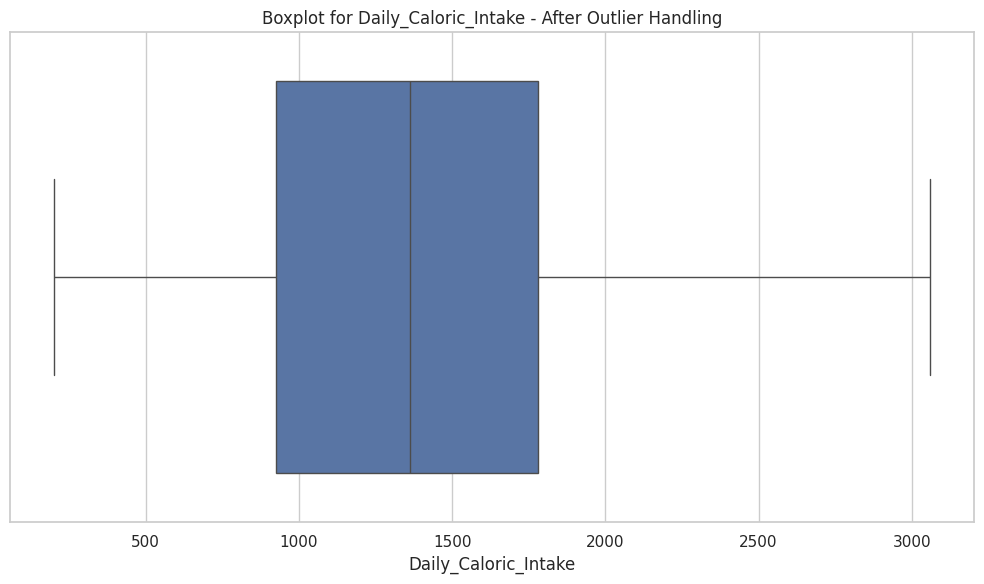

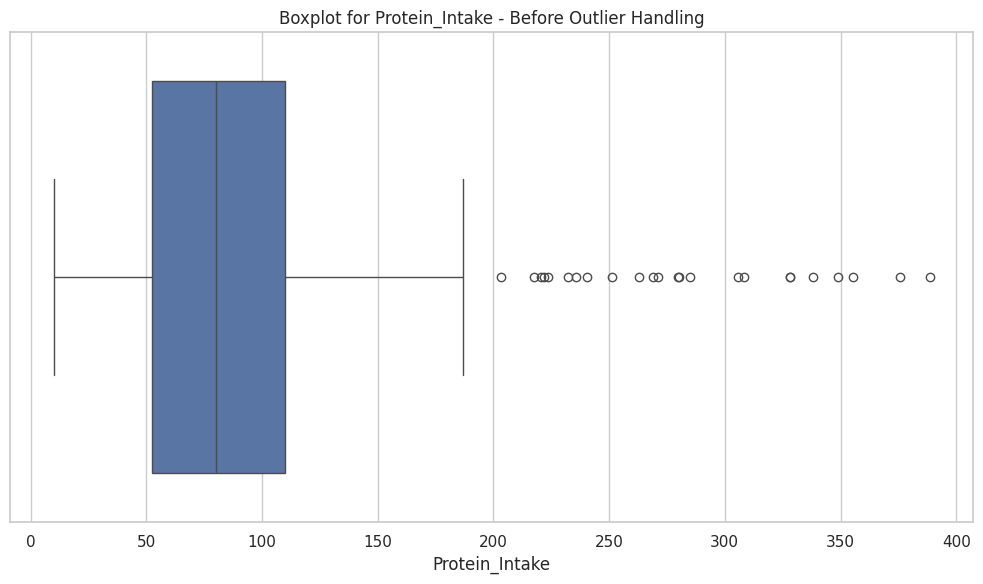

Found 24 outliers in Protein_Intake


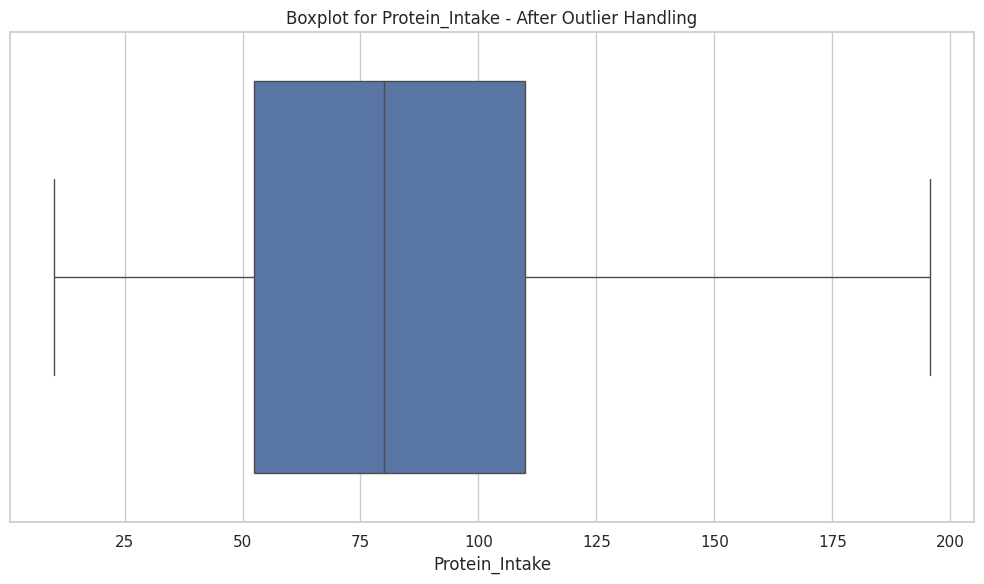

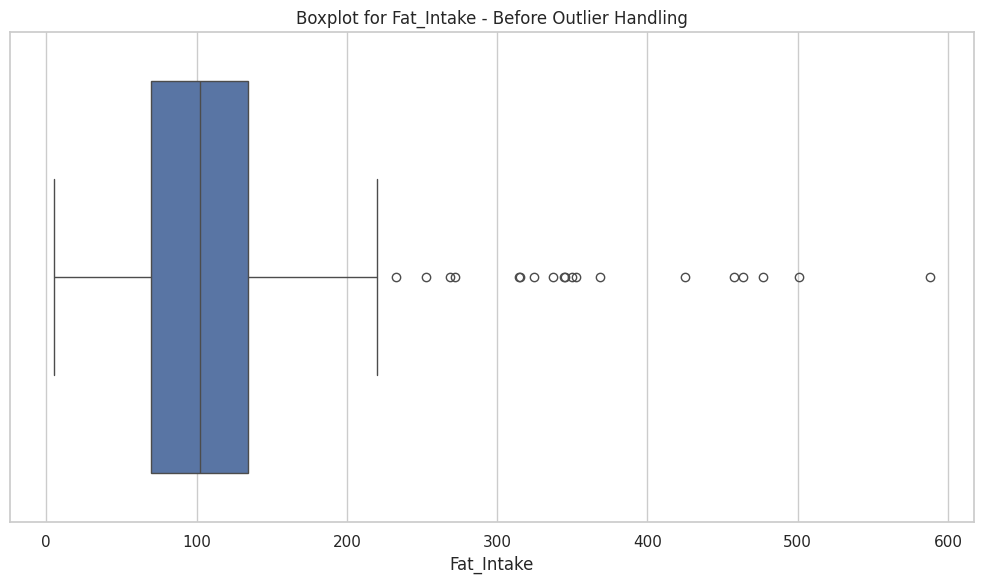

Found 19 outliers in Fat_Intake


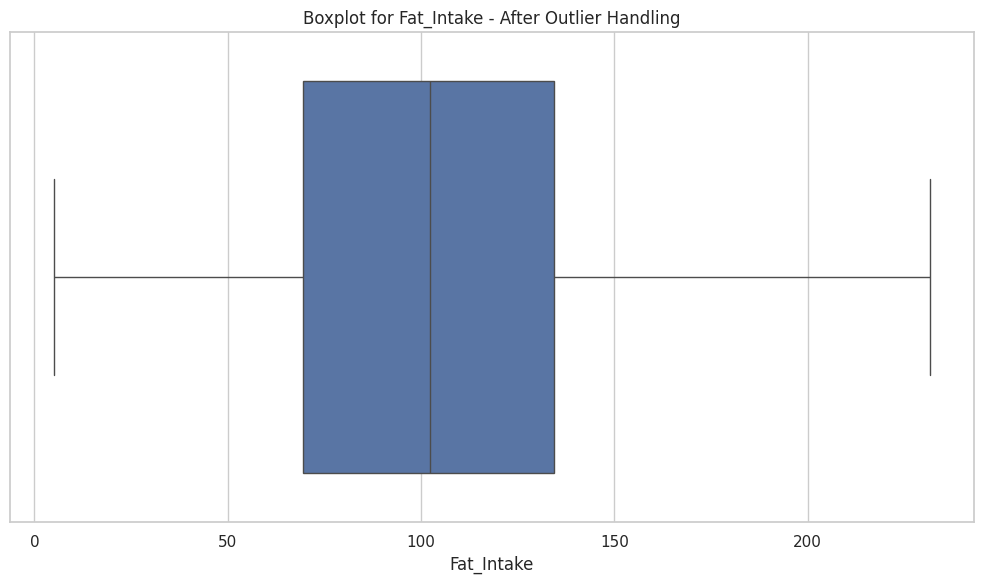

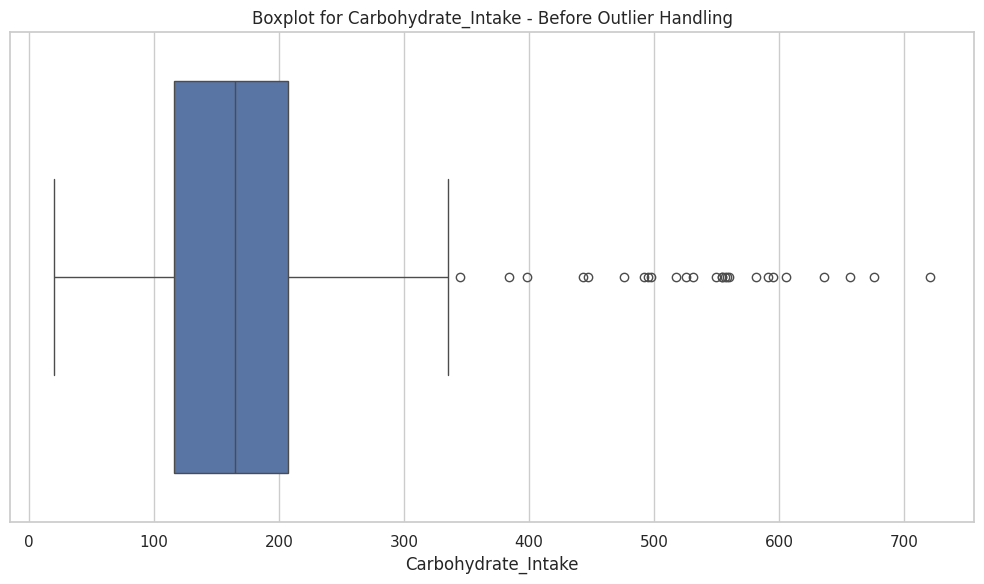

Found 26 outliers in Carbohydrate_Intake


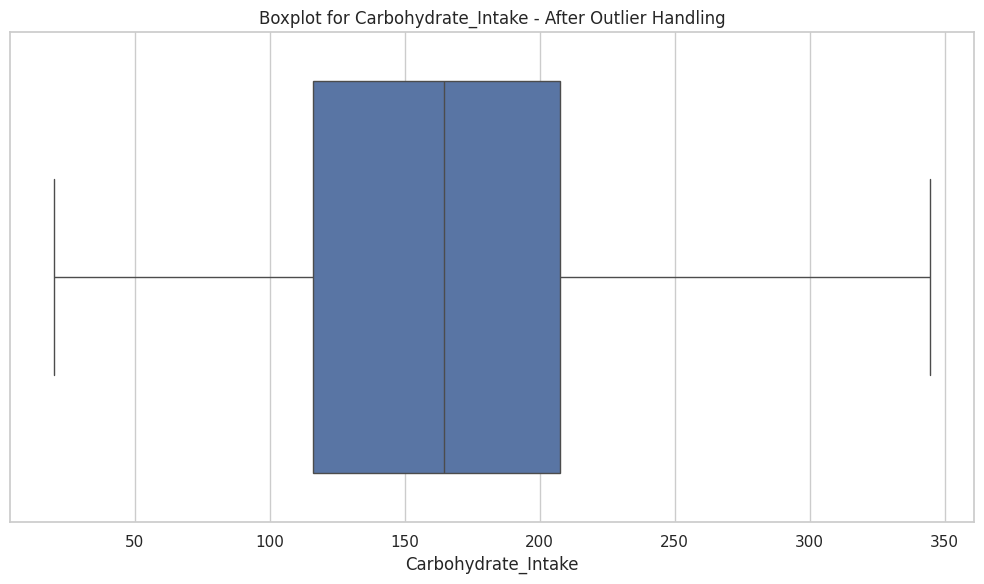

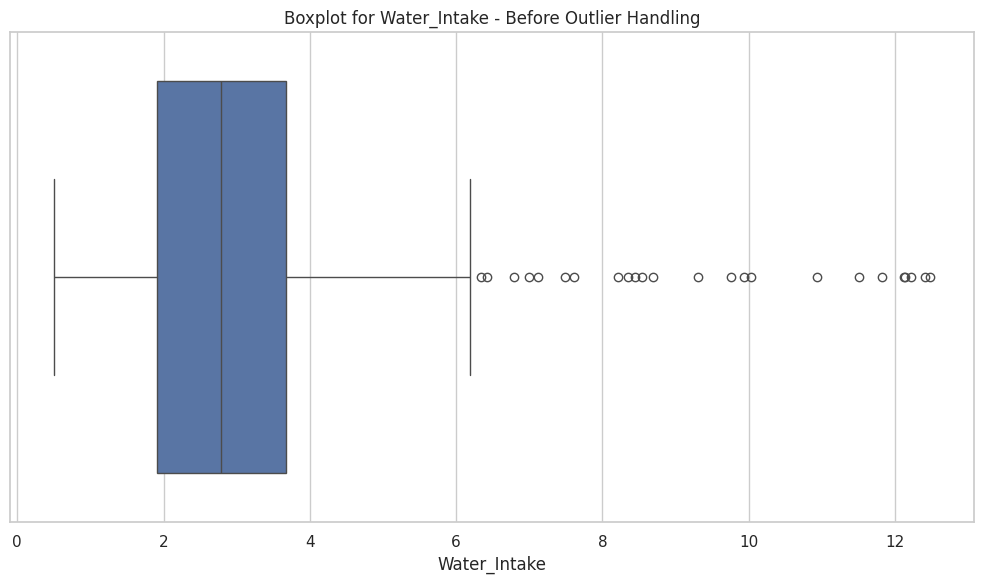

Found 24 outliers in Water_Intake


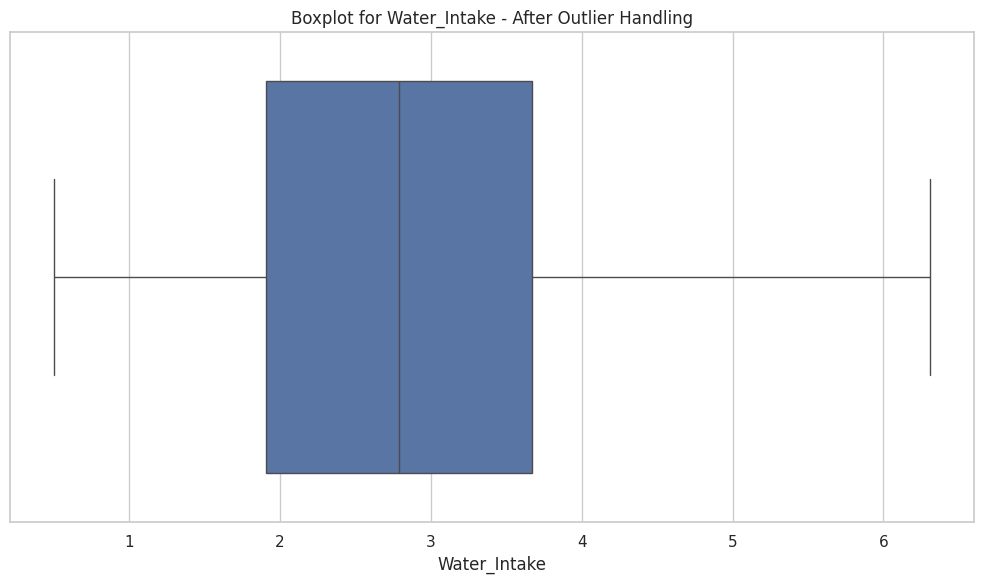

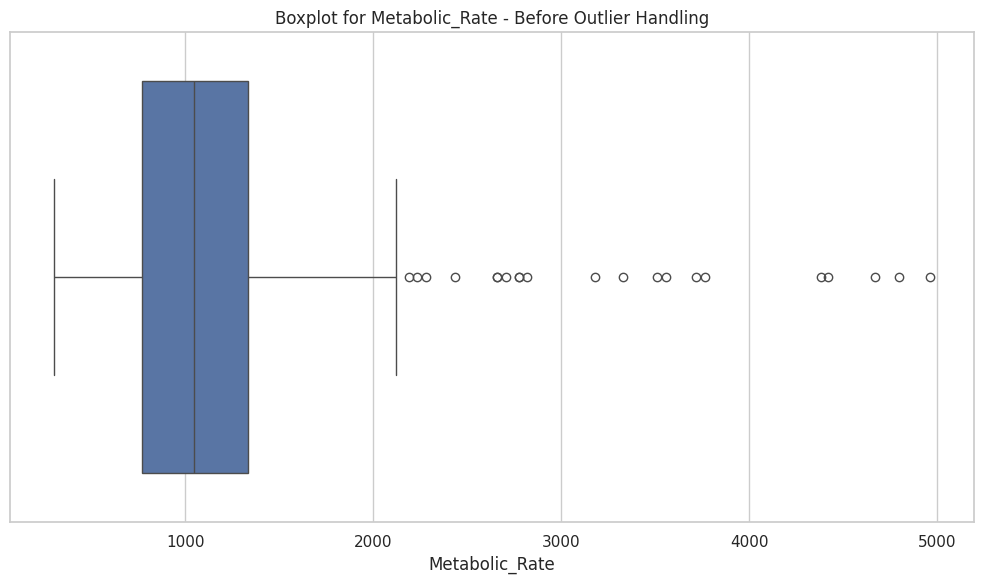

Found 21 outliers in Metabolic_Rate


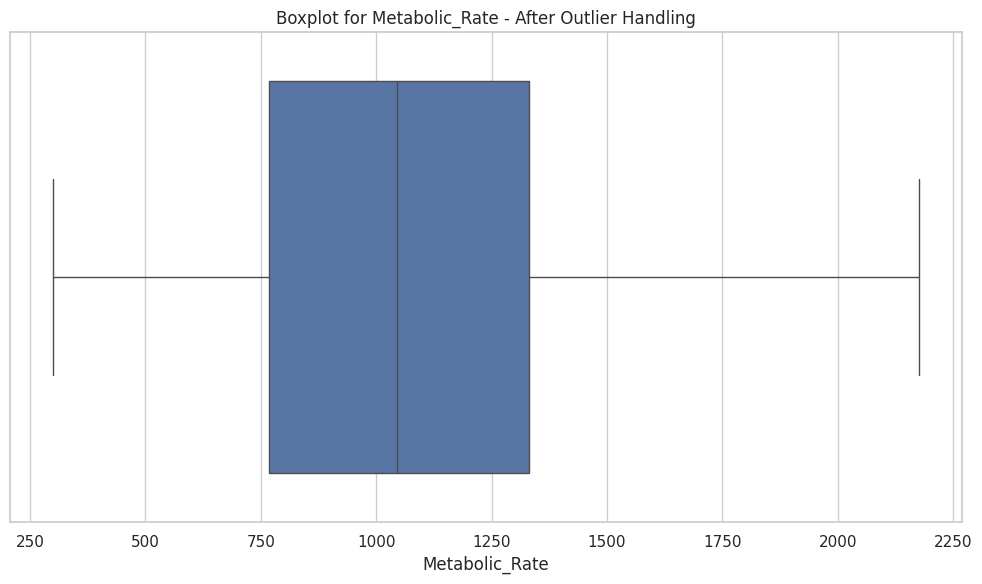

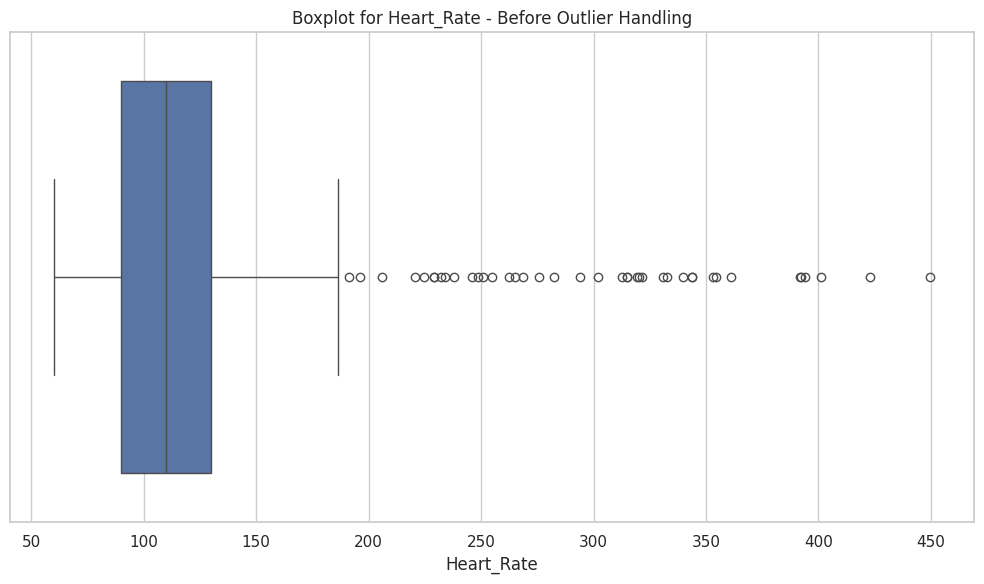

Found 41 outliers in Heart_Rate


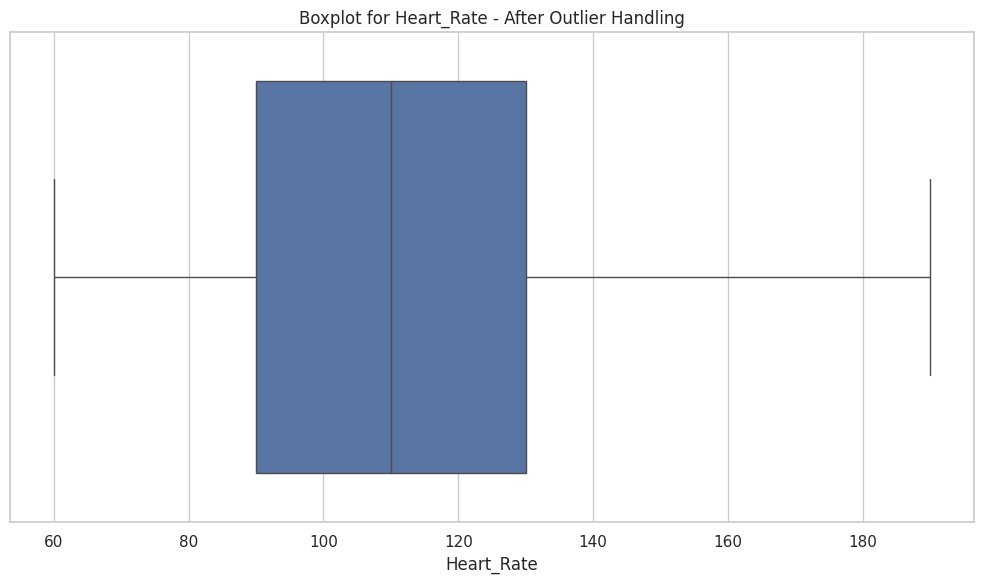

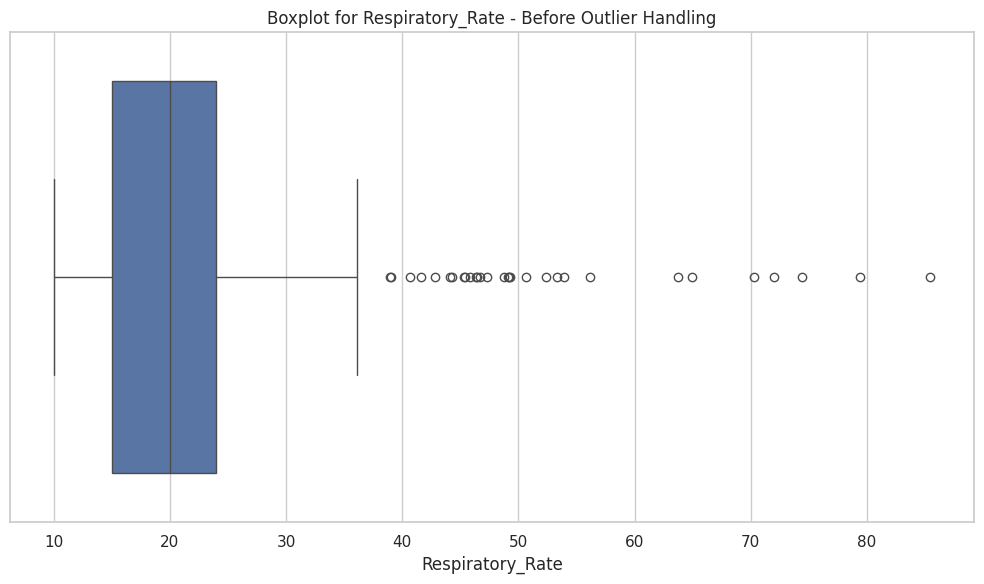

Found 30 outliers in Respiratory_Rate


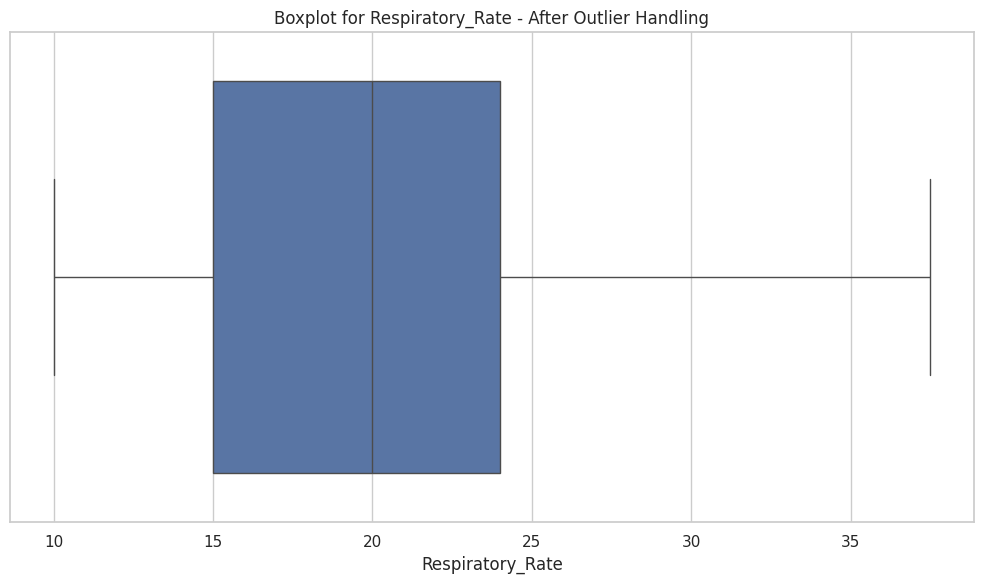

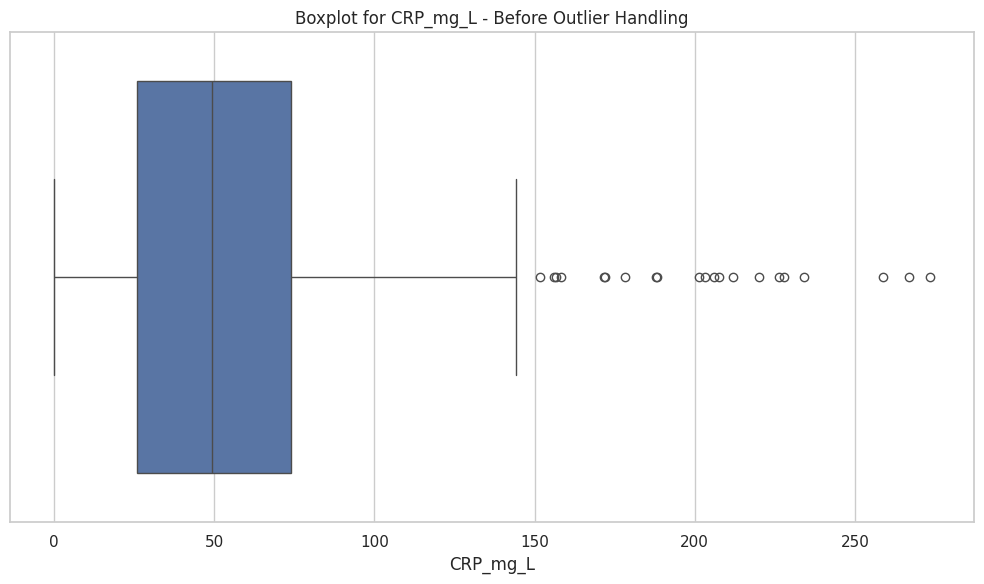

Found 21 outliers in CRP_mg_L


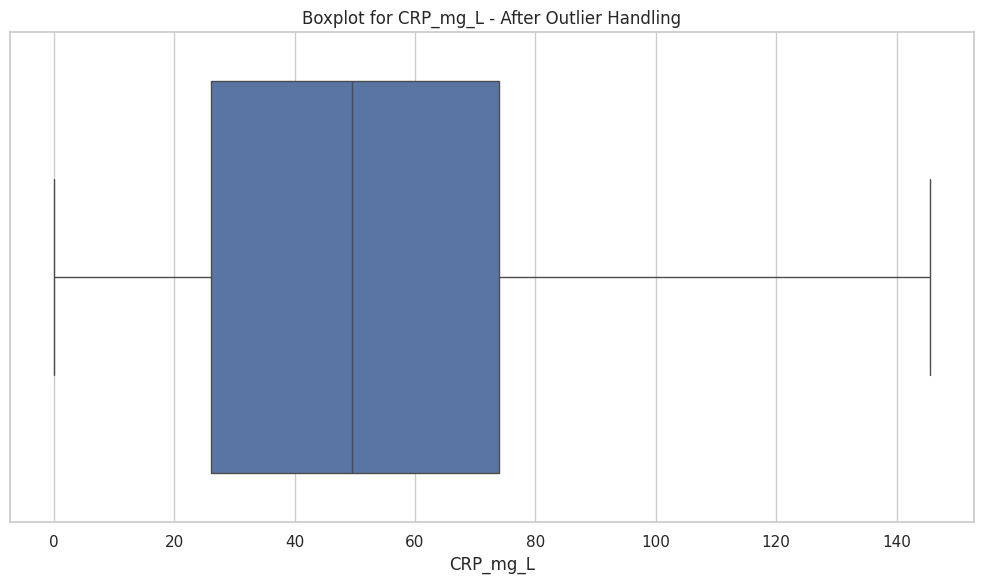

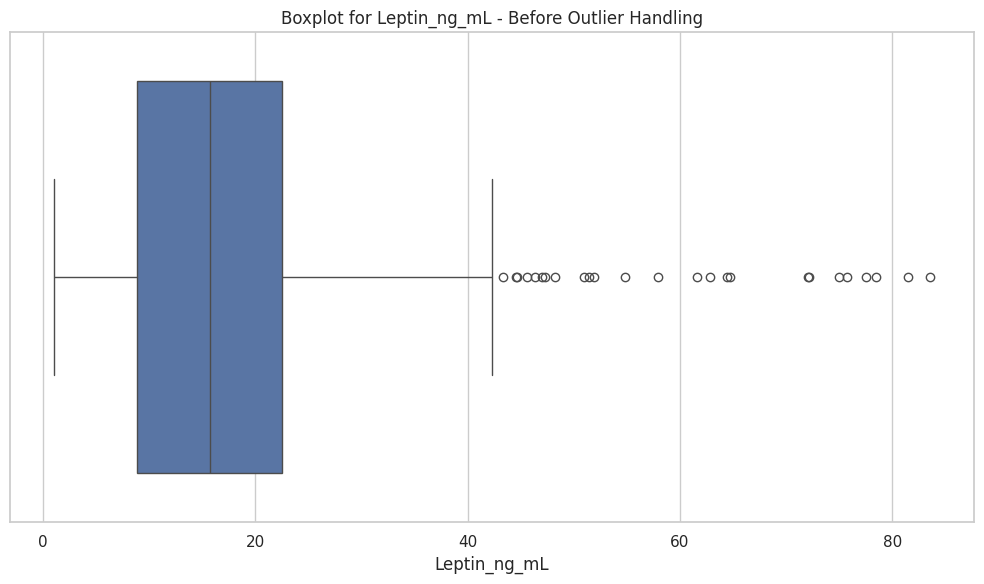

Found 25 outliers in Leptin_ng_mL


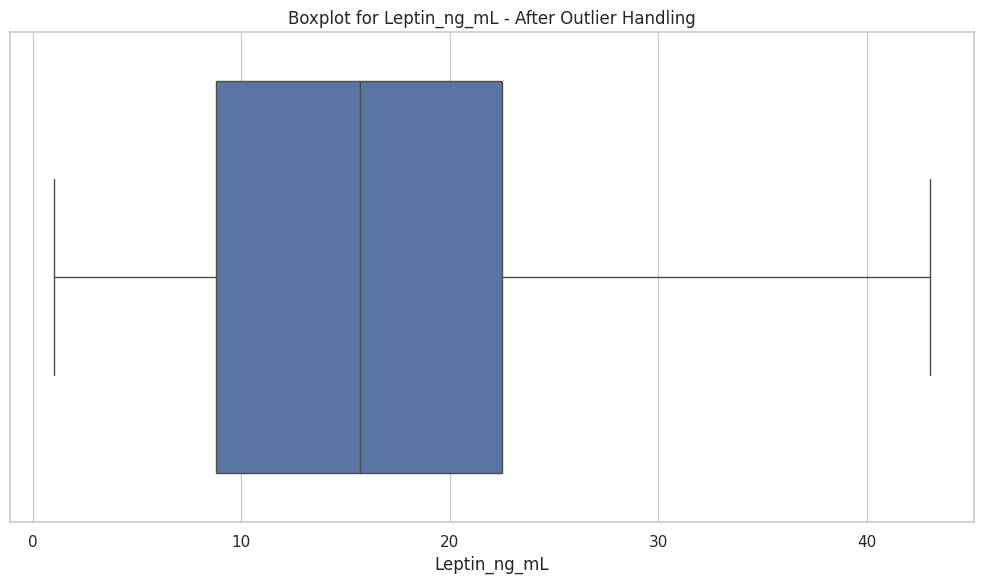

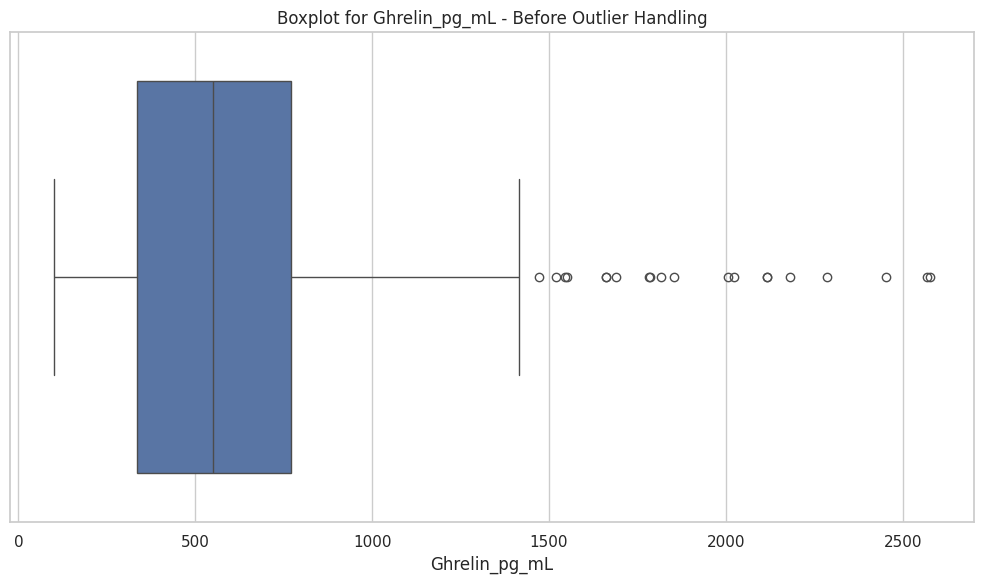

Found 20 outliers in Ghrelin_pg_mL


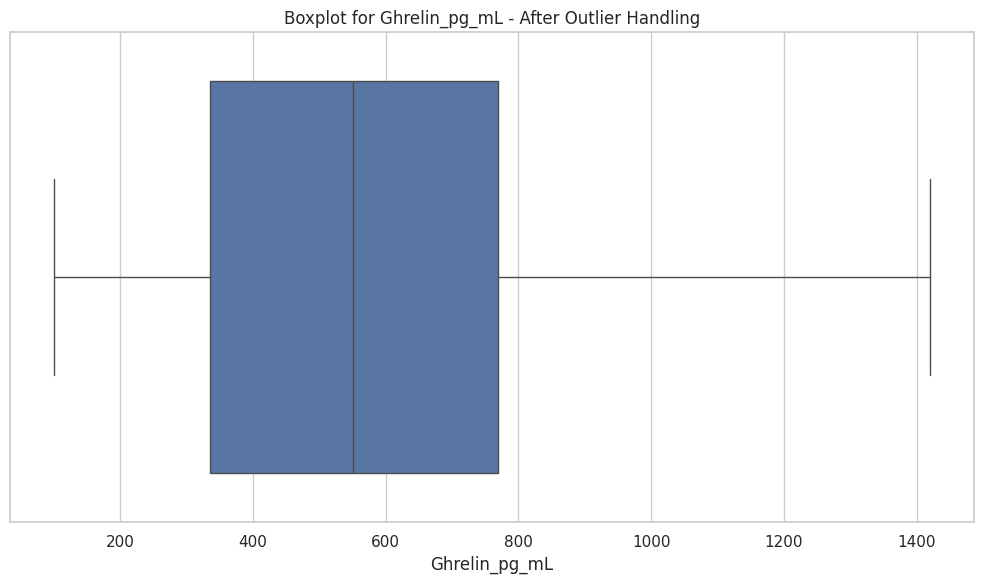

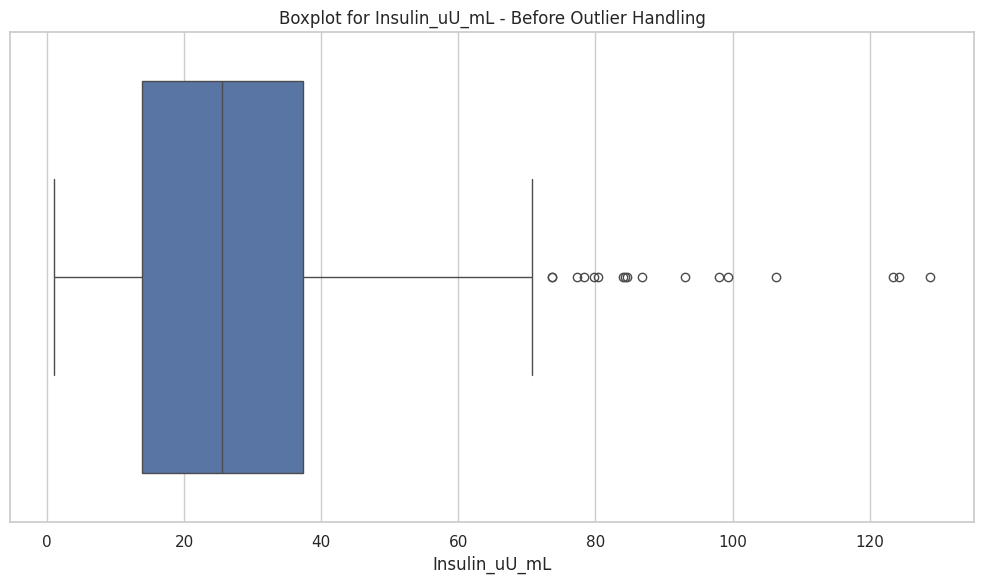

Found 17 outliers in Insulin_uU_mL


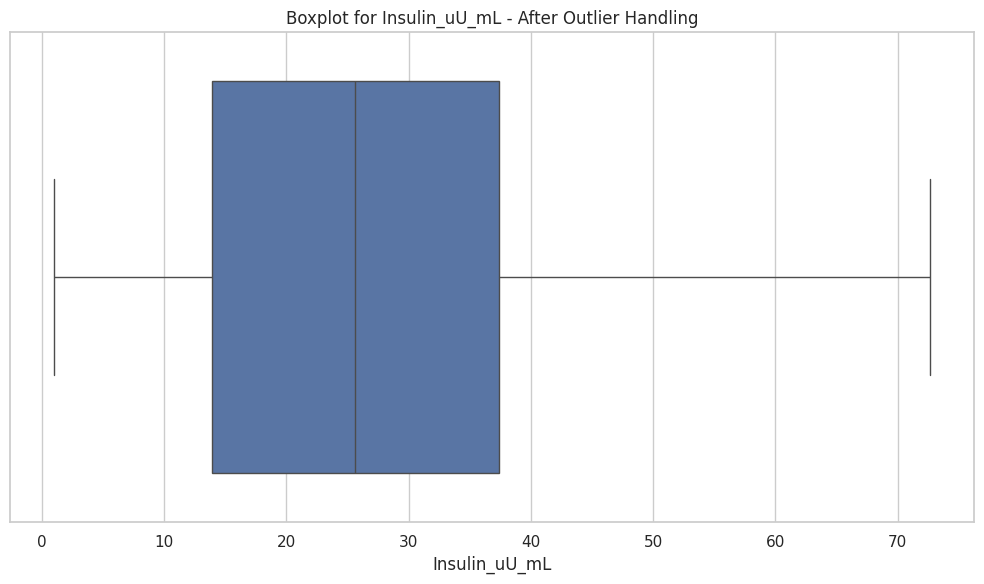

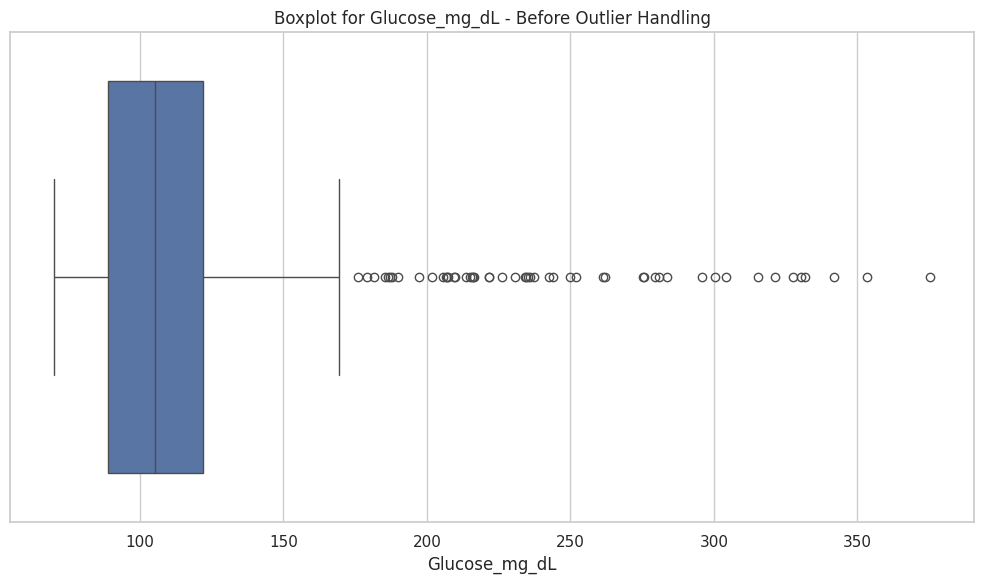

Found 52 outliers in Glucose_mg_dL


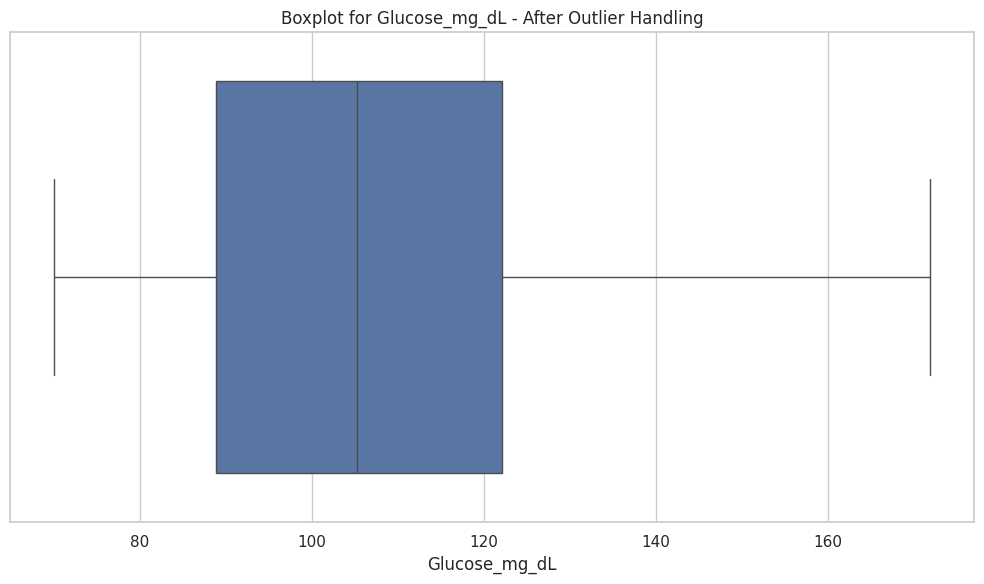

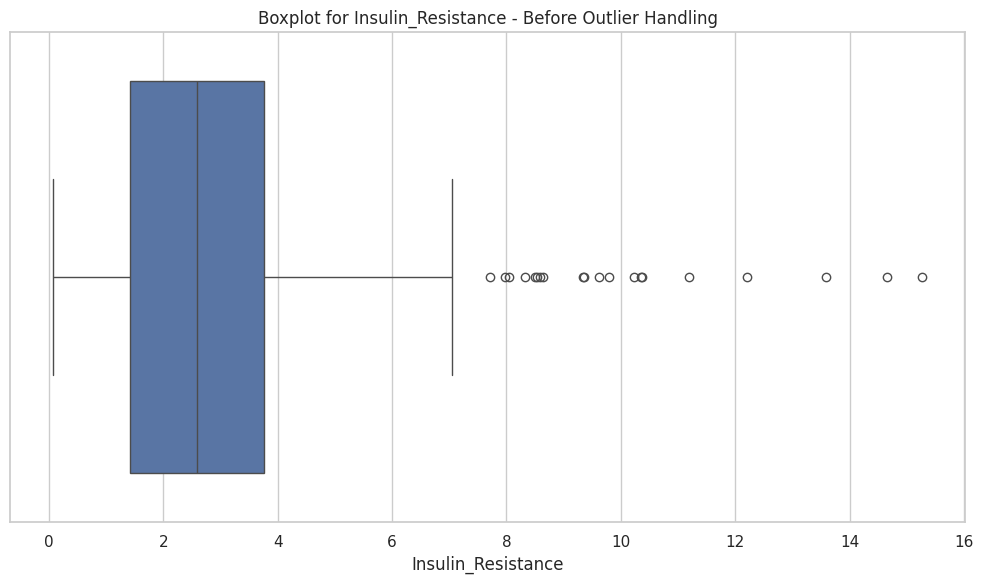

Found 20 outliers in Insulin_Resistance


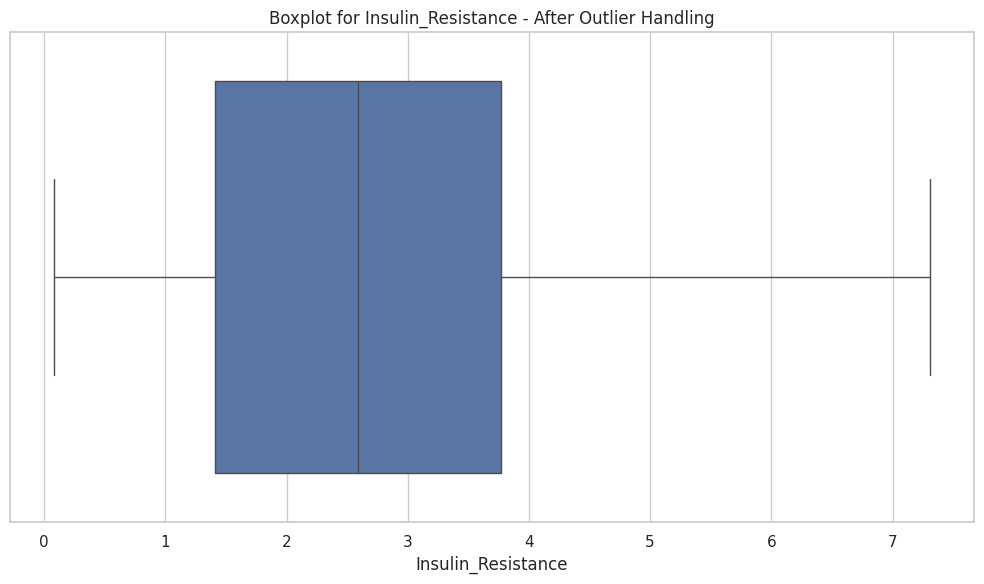

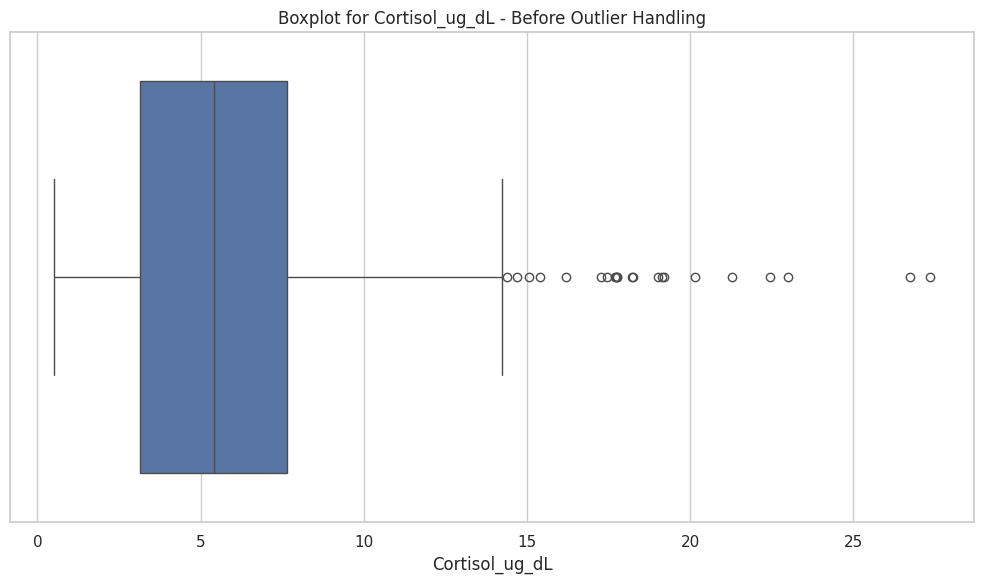

Found 22 outliers in Cortisol_ug_dL


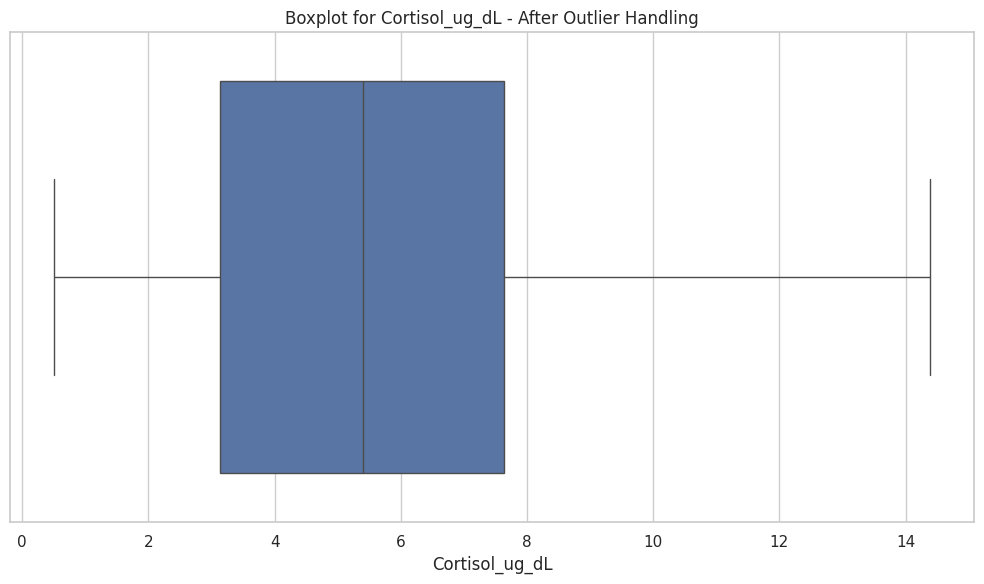

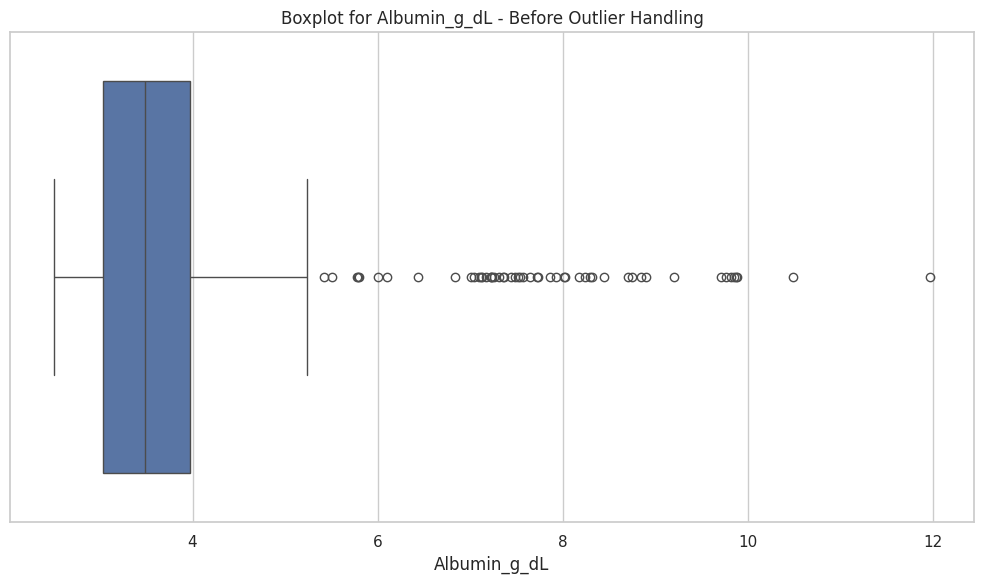

Found 52 outliers in Albumin_g_dL


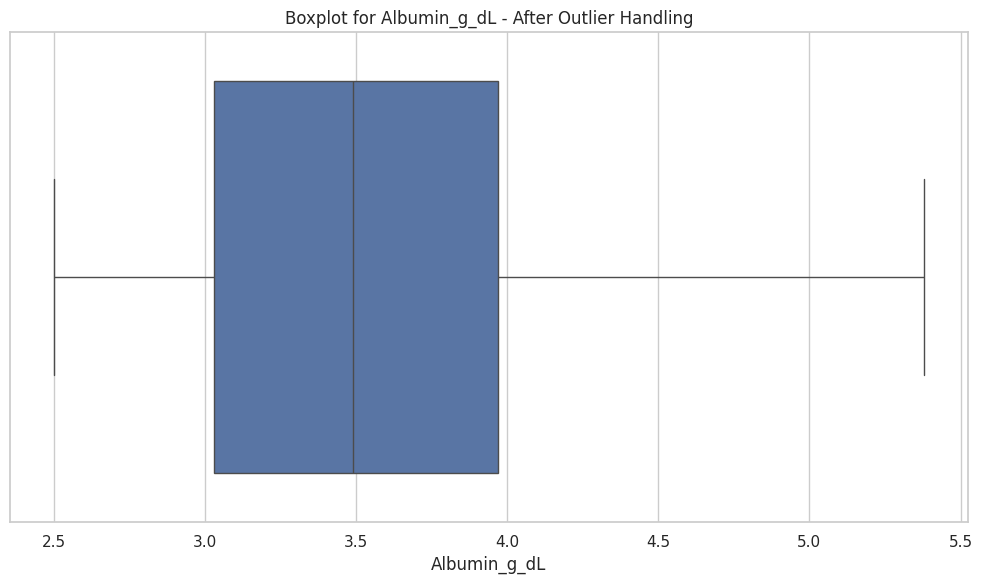

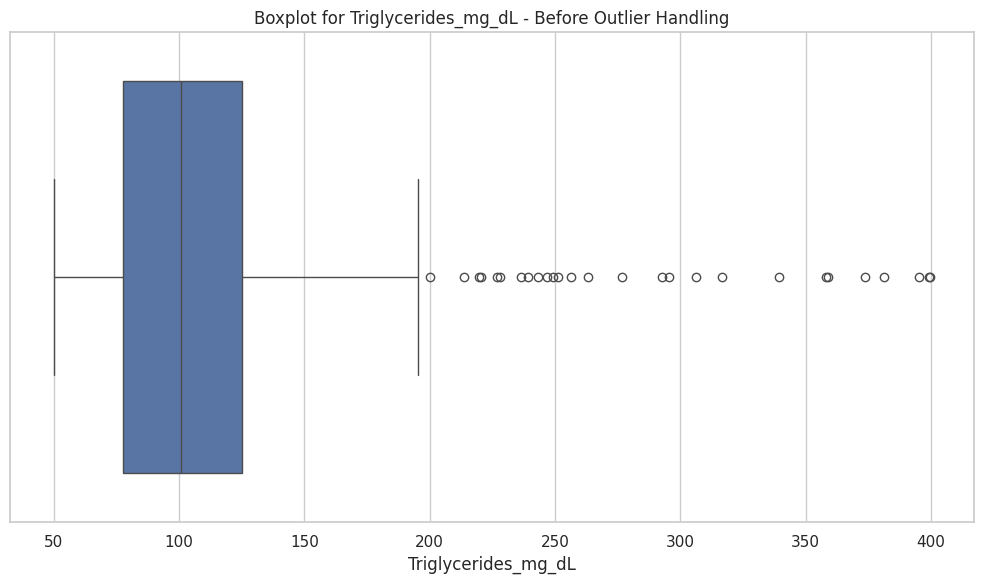

Found 27 outliers in Triglycerides_mg_dL


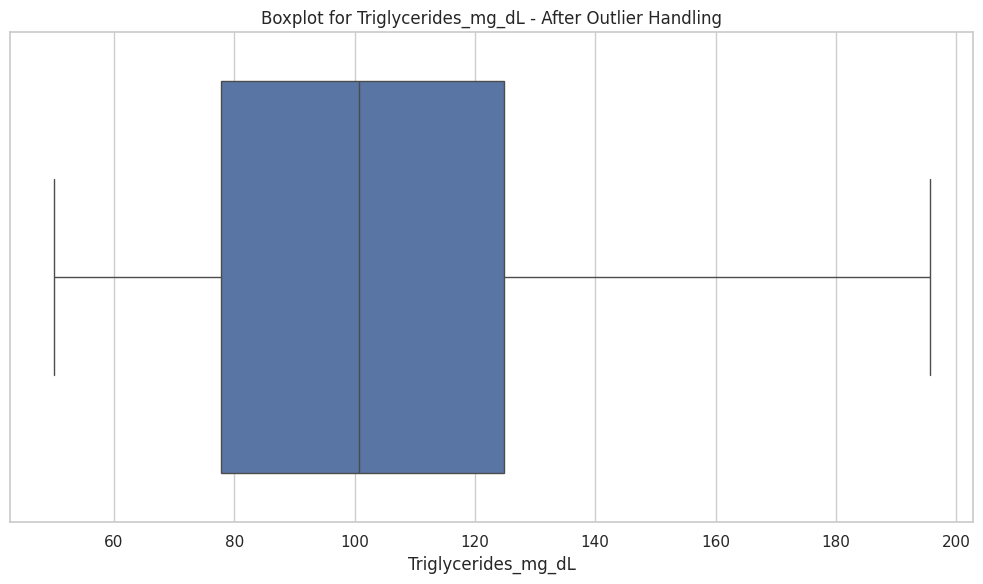

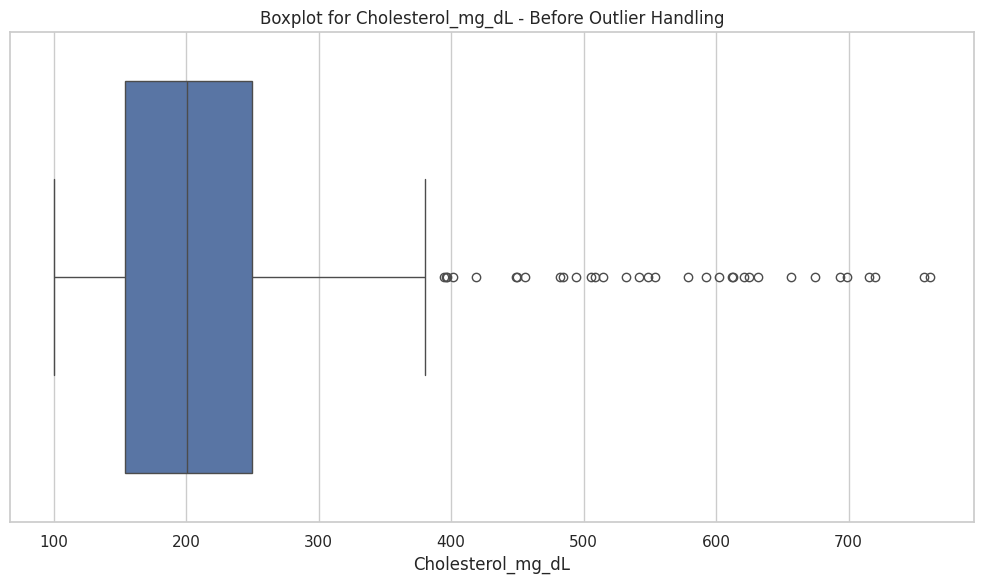

Found 34 outliers in Cholesterol_mg_dL


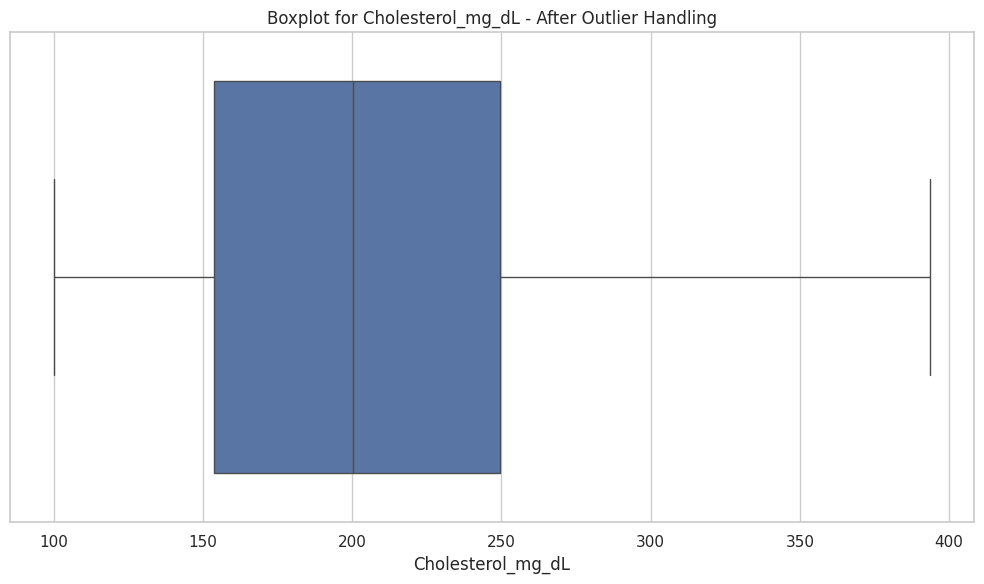

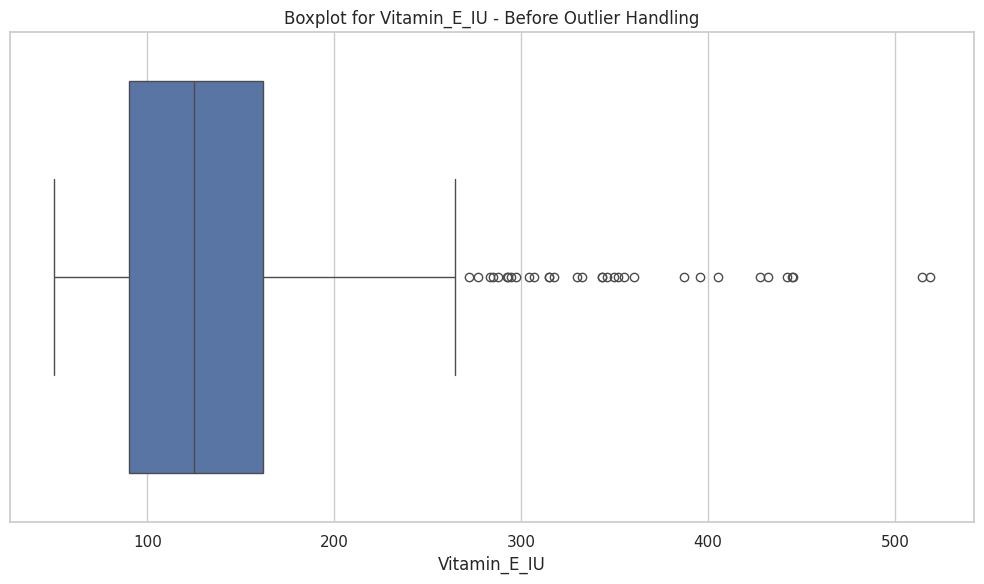

Found 33 outliers in Vitamin_E_IU


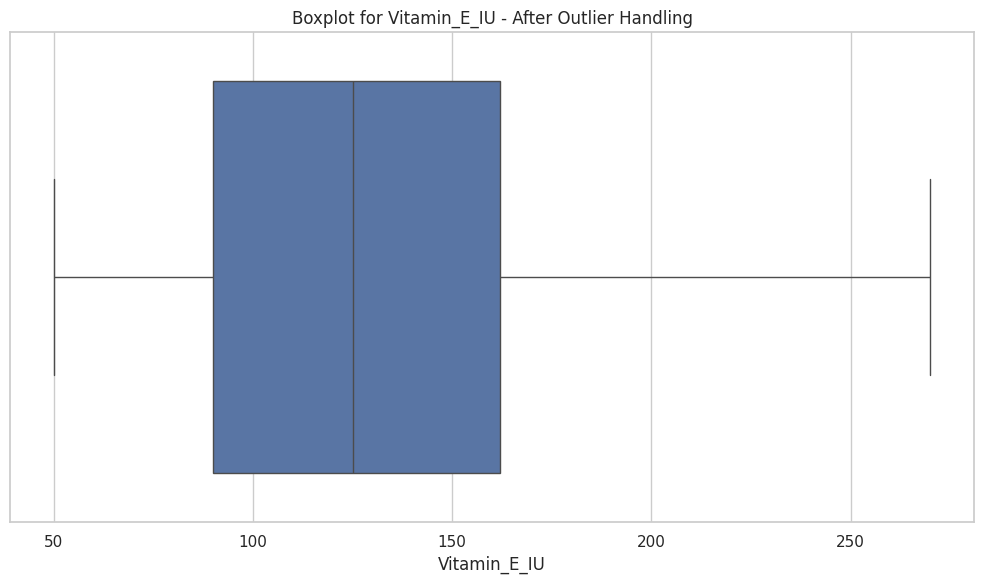

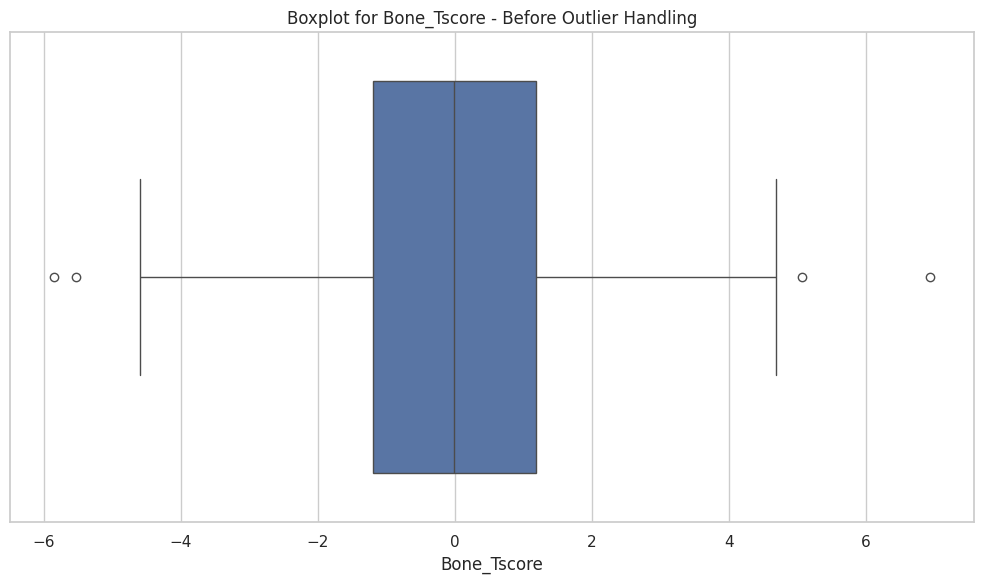

Found 4 outliers in Bone_Tscore


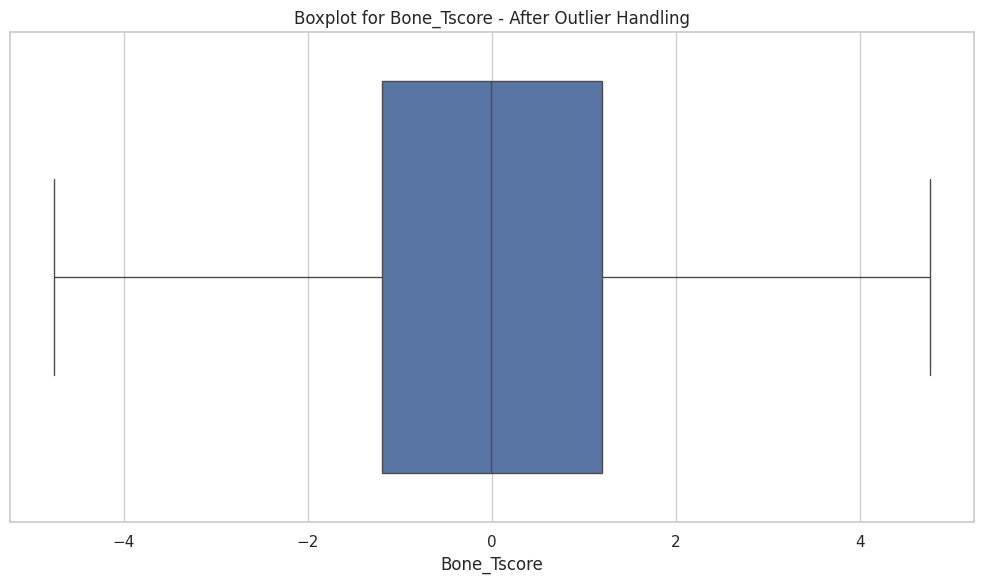

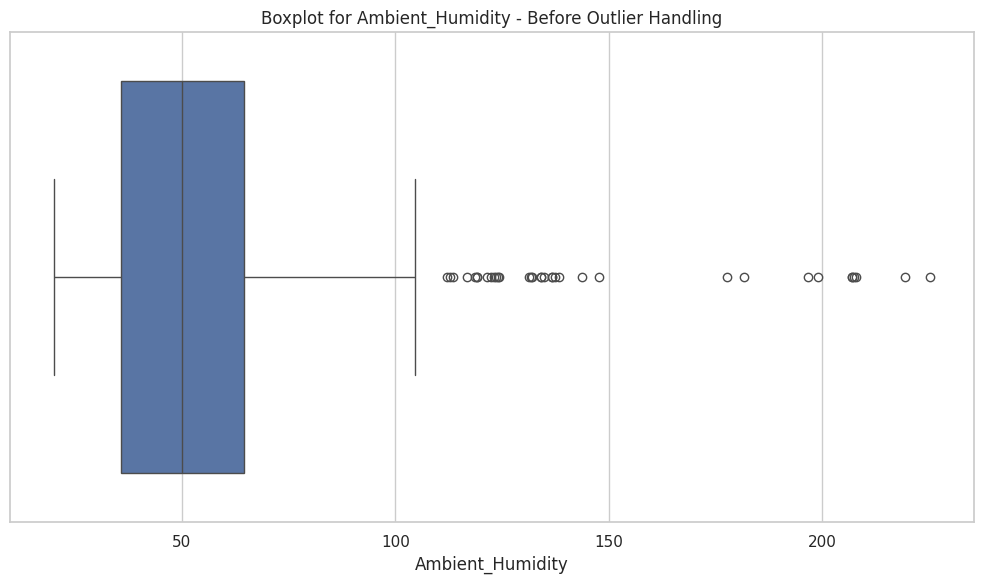

Found 35 outliers in Ambient_Humidity


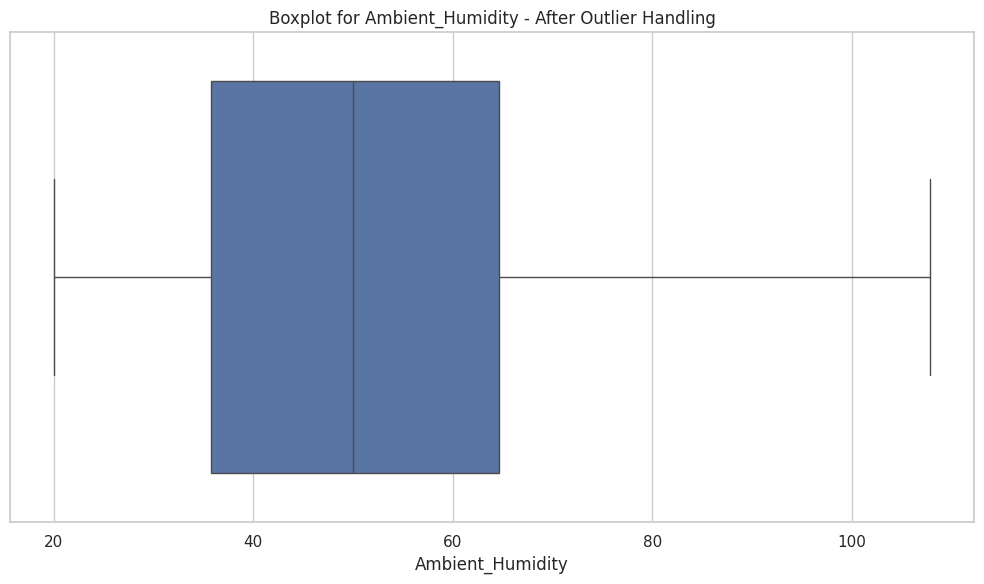


----- Scaling Numerical Features -----
Scaling complete.


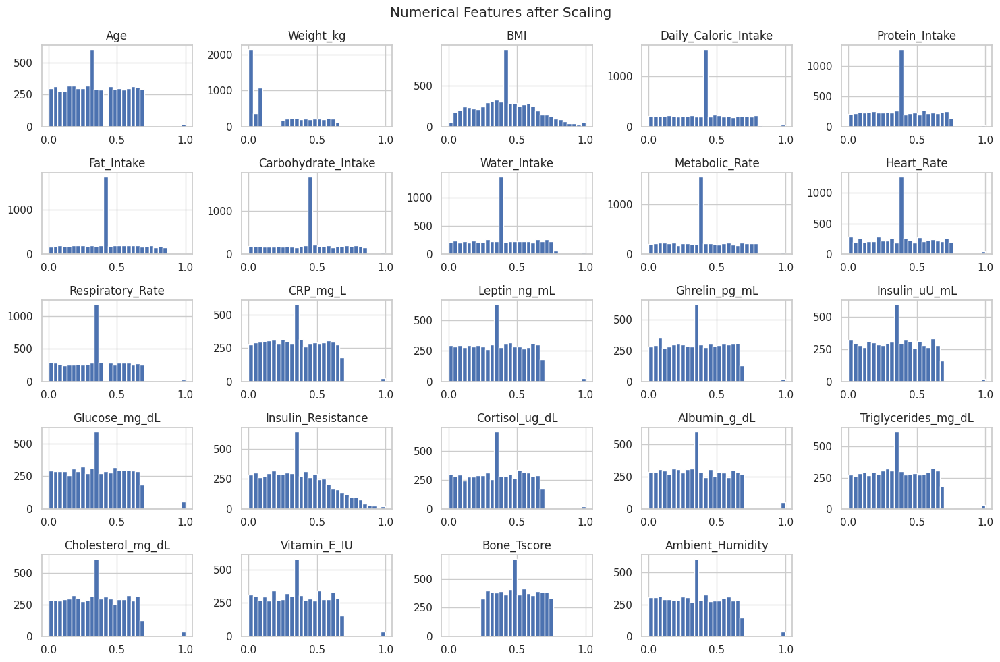


----- Encoding Categorical Variables -----
Encoding column: Species
Encoded Data Sample:
   Species_Cow  Species_Dog  Species_Horse  Species_Rabbit  Species_Sheep
0          0.0          0.0            0.0             0.0            0.0
1          0.0          0.0            0.0             0.0            1.0
2          0.0          0.0            0.0             0.0            0.0
3          0.0          1.0            0.0             0.0            0.0
4          1.0          0.0            0.0             0.0            0.0
Encoding column: Gender
Encoded Data Sample:
   Gender_Male
0          0.0
1          1.0
2          0.0
3          0.0
4          0.0
Encoding column: Medical_Condition
Encoded Data Sample:
   Medical_Condition_Colic  Medical_Condition_EMS  Medical_Condition_FIV  \
0                      0.0                    0.0                    0.0   
1                      0.0                    0.0                    0.0   
2                      0.0                    0

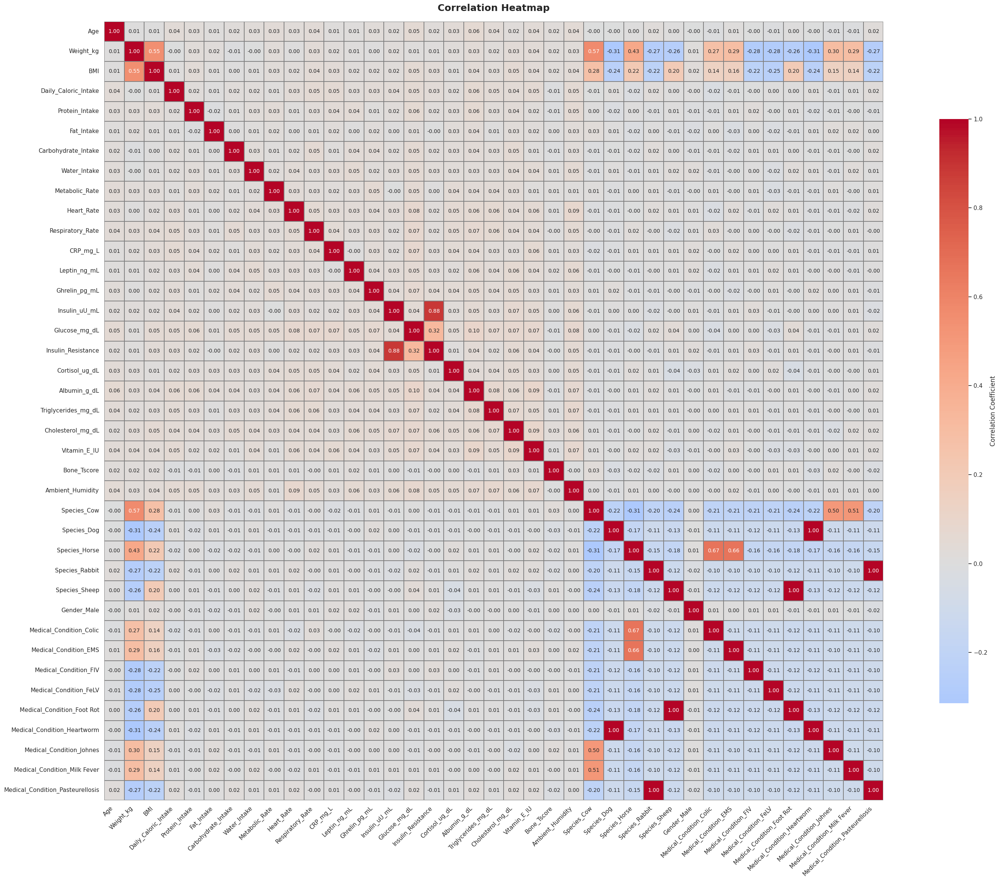


----- Multicollinearity Check (VIF) -----
Dropped columns: ['Animal_ID', 'Dietary_Recommendations', 'Veterinary_Notes', 'Prescription']
Top 10 Features with highest VIF:
                             Feature        VIF
25                       Species_Dog        inf
28                     Species_Sheep        inf
27                    Species_Rabbit        inf
30           Medical_Condition_Colic        inf
38  Medical_Condition_Pasteurellosis        inf
34        Medical_Condition_Foot Rot        inf
31             Medical_Condition_EMS        inf
26                     Species_Horse        inf
35       Medical_Condition_Heartworm        inf
24                       Species_Cow  20.736879


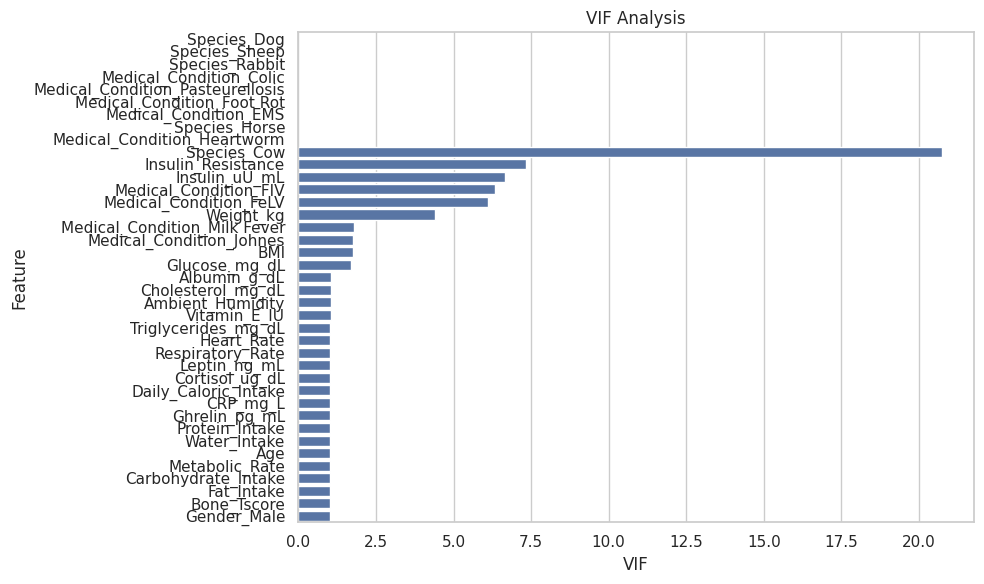

Removing features with VIF > 10: ['Species_Cow', 'Species_Dog', 'Species_Horse', 'Species_Rabbit', 'Species_Sheep', 'Medical_Condition_Colic', 'Medical_Condition_EMS', 'Medical_Condition_Foot Rot', 'Medical_Condition_Heartworm', 'Medical_Condition_Pasteurellosis']
Final shape of processed data: (6388, 29)
===== Preprocessing Completed =====


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder, MinMaxScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Set visualization style
sns.set(style='whitegrid')
plt.rcParams['figure.figsize'] = (10, 6)

def preprocess_tabular_data(df):
    print("===== Starting Tabular Data Preprocessing =====")

    # Create a copy to avoid modifying the original dataframe
    processed_df = df.copy()
    print("Initial shape:", processed_df.shape)

    # Identify numerical and categorical columns
    numerical_cols = processed_df.select_dtypes(include=['int64', 'float64']).columns.tolist()
    numerical_cols = [col for col in numerical_cols if col != 'Animal_ID']
    categorical_cols = ['Species', 'Gender', 'Medical_Condition', 'Activity_Level']
    print("Identified Numerical Columns:", numerical_cols)
    print("Identified Categorical Columns:", categorical_cols)

    # ----- Missing Value Handling ----- #
    # Handle missing values in numerical columns
    if numerical_cols:
        imputer = SimpleImputer(strategy='median')
        processed_df[numerical_cols] = imputer.fit_transform(processed_df[numerical_cols])
        print("\nMissing values in numerical columns have been imputed using median.")
        print("Missing Values After Imputation:")
        print(processed_df[numerical_cols].isnull().sum())

        # Visualize distributions after imputation
        processed_df[numerical_cols].hist(bins=30, figsize=(15, 10))
        plt.suptitle("Numerical Features after Imputation")
        plt.tight_layout()
        plt.show()

        print("Missing values after imputation:")
        print(processed_df.isnull().sum())

        plt.figure(figsize=(10, 6))
        msno.bar(processed_df, fontsize=12, color='green')
        plt.title("Missing Values Per Column (After Imputation)")
        plt.show()

    # Handle missing values in categorical columns
    for col in categorical_cols:
        if col in processed_df.columns:
            processed_df[col].fillna(processed_df[col].mode()[0], inplace=True)
    print("Missing values in categorical columns have been filled with the mode.")

    # ----- Outlier Detection and Handling ----- #
    for col in numerical_cols:
        Q1 = processed_df[col].quantile(0.25)
        Q3 = processed_df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        # Visualize the outliers before removal
        plt.figure(figsize=(10, 6))
        sns.boxplot(x=processed_df[col])
        plt.title(f'Boxplot for {col} - Before Outlier Handling')
        plt.tight_layout()
        plt.savefig(f'boxplot_{col}_before.png')
        plt.show()
        plt.close()

        # Identify and cap outliers
        outliers = ((processed_df[col] < lower_bound) | (processed_df[col] > upper_bound))
        outlier_count = outliers.sum()

        if outlier_count > 0:
            print(f"Found {outlier_count} outliers in {col}")
            processed_df[col] = processed_df[col].clip(lower=lower_bound, upper=upper_bound)

        # Visualize after outlier handling
        plt.figure(figsize=(10, 6))
        sns.boxplot(x=processed_df[col])
        plt.title(f'Boxplot for {col} - After Outlier Handling')
        plt.tight_layout()
        plt.savefig(f'boxplot_{col}_after.png')
        plt.show()
        plt.close()

    # ----- Scaling ----- #
    print("\n----- Scaling Numerical Features -----")
    scaler = MinMaxScaler()
    processed_df[numerical_cols] = scaler.fit_transform(processed_df[numerical_cols])
    print("Scaling complete.")

    # Visualize distributions after scaling
    processed_df[numerical_cols].hist(bins=30, figsize=(15, 10))
    plt.suptitle("Numerical Features after Scaling")
    plt.tight_layout()
    plt.show()

    # ----- Categorical Encoding ----- #
    print("\n----- Encoding Categorical Variables -----")
    for col in categorical_cols:
        if col in processed_df.columns:
            encoder = OneHotEncoder(sparse_output=False, drop='first', handle_unknown='ignore')
            encoded = pd.DataFrame(
                encoder.fit_transform(processed_df[[col]]),
                columns=encoder.get_feature_names_out([col])
            )
            print(f"Encoding column: {col}")
            print("Encoded Data Sample:")
            print(encoded.head())
            processed_df = pd.concat([processed_df, encoded], axis=1)
            processed_df.drop(col, axis=1, inplace=True)
    print("Categorical encoding complete.")
    print("Shape after encoding:", processed_df.shape)

    # ----- Correlation Heatmap ----- #
    if 'Animal_ID' in processed_df.columns:
        processed_df = processed_df.drop(columns=['Animal_ID'])

    numeric_df = processed_df.select_dtypes(include='number')
    corr_matrix = numeric_df.corr()
    mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

    fig, ax = plt.subplots(figsize=(max(10, 0.8 * len(corr_matrix)), max(8, 0.6 * len(corr_matrix))))
    sns.heatmap(
        corr_matrix,
        # mask=mask,
        cmap='coolwarm',
        center=0,
        annot=True,
        fmt=".2f",
        square=True,
        linewidths=0.3,
        linecolor='gray',
        cbar_kws={"shrink": 0.75, 'label': 'Correlation Coefficient'},
        annot_kws={"size": 10}
    )
    plt.title('Correlation Heatmap', fontsize=18, weight='bold', pad=20)
    plt.xticks(rotation=45, ha='right', fontsize=11)
    plt.yticks(rotation=0, fontsize=11)
    plt.tight_layout()
    plt.show()

    # ----- Multicollinearity Check (VIF) ----- #
    print("\n----- Multicollinearity Check (VIF) -----")
    columns_to_drop = ['Animal_ID', 'Dietary_Recommendations', 'Veterinary_Notes', 'Prescription']
    for col in columns_to_drop:
        if col in processed_df.columns:
            processed_df.drop(col, axis=1, inplace=True)
    print("Dropped columns:", columns_to_drop)

    X_for_vif = processed_df.copy()
    vif_data = pd.DataFrame()
    vif_data["Feature"] = X_for_vif.columns
    vif_data["VIF"] = [variance_inflation_factor(X_for_vif.values, i) for i in range(X_for_vif.shape[1])]

    print("Top 10 Features with highest VIF:")
    print(vif_data.sort_values('VIF', ascending=False).head(10))

    plt.figure()
    sns.barplot(x="VIF", y="Feature", data=vif_data.sort_values('VIF', ascending=False))
    plt.title("VIF Analysis")
    plt.tight_layout()
    plt.show()

    # Remove features with VIF > 10
    high_vif_features = vif_data[vif_data["VIF"] > 10]["Feature"].tolist()
    if high_vif_features:
        print("Removing features with VIF > 10:", high_vif_features)
        processed_df.drop(high_vif_features, axis=1, inplace=True)
    else:
        print("No features with VIF > 10 found.")

    print("Final shape of processed data:", processed_df.shape)
    print("===== Preprocessing Completed =====")
    return processed_df

# Apply preprocessing to tabular data
processed_tabular = preprocess_tabular_data(merged_data)


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


===== Starting Textual Data Preprocessing =====

Processing column: Veterinary_Notes
Sample processed Veterinary_Notes:
0    cat diagnosed felv show significant symptom im...
1    sheep diagnosed foot rot show significant symp...
2    cat diagnosed fiv stable condition requires di...
3    dog diagnosed heartworm show significant sympt...
4    cow diagnosed milk fever exhibit mild symptom ...
Name: processed_Veterinary_Notes, dtype: object


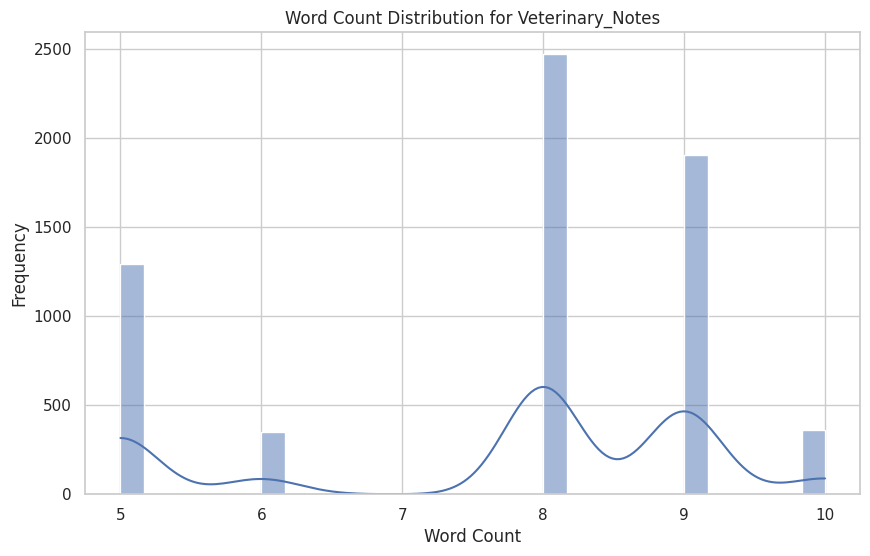


Processing column: Prescription
Sample processed Prescription:
0           cat felv ensure hydration nutrient support
1     sheep foot rot ensure hydration nutrient support
2    cat fiv administer appropriate medication per ...
3      dog heartworm ensure hydration nutrient support
4    cow milk fever administer appropriate medicati...
Name: processed_Prescription, dtype: object


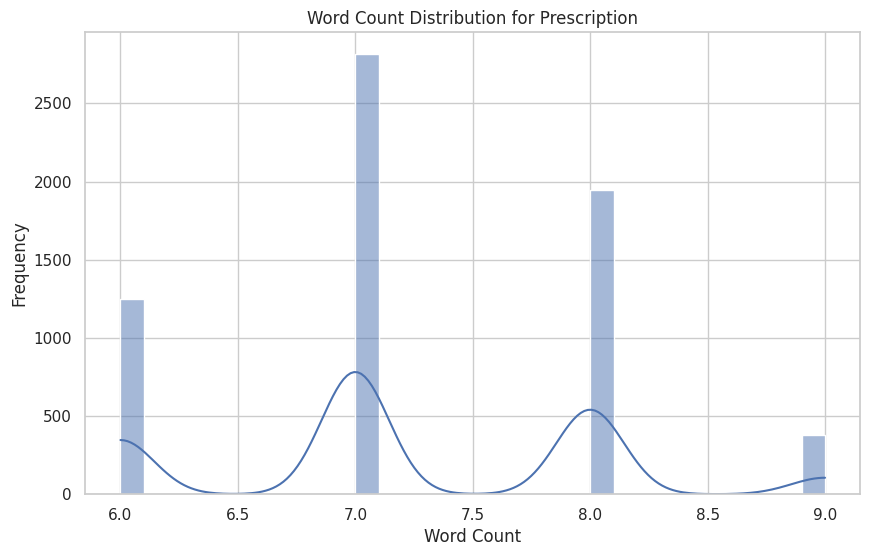


Converting processed 'Veterinary_Notes' to TF-IDF features...
TF-IDF (Veterinary_Notes) shape: (6388, 36)
   notes_tfidf_0  notes_tfidf_1  notes_tfidf_2  notes_tfidf_3  notes_tfidf_4  \
0       0.000000       0.000000            0.0       0.336681       0.369707   
1       0.000000       0.000000            0.0       0.305048       0.000000   
2       0.347693       0.000000            0.0       0.000000       0.380491   
3       0.000000       0.000000            0.0       0.327597       0.000000   
4       0.000000       0.325976            0.0       0.000000       0.000000   

   notes_tfidf_5  notes_tfidf_6  notes_tfidf_7  notes_tfidf_8  notes_tfidf_9  \
0            0.0            0.0       0.000000       0.000000       0.140710   
1            0.0            0.0       0.000000       0.000000       0.127489   
2            0.0            0.0       0.347693       0.000000       0.144814   
3            0.0            0.0       0.000000       0.000000       0.136913   
4           

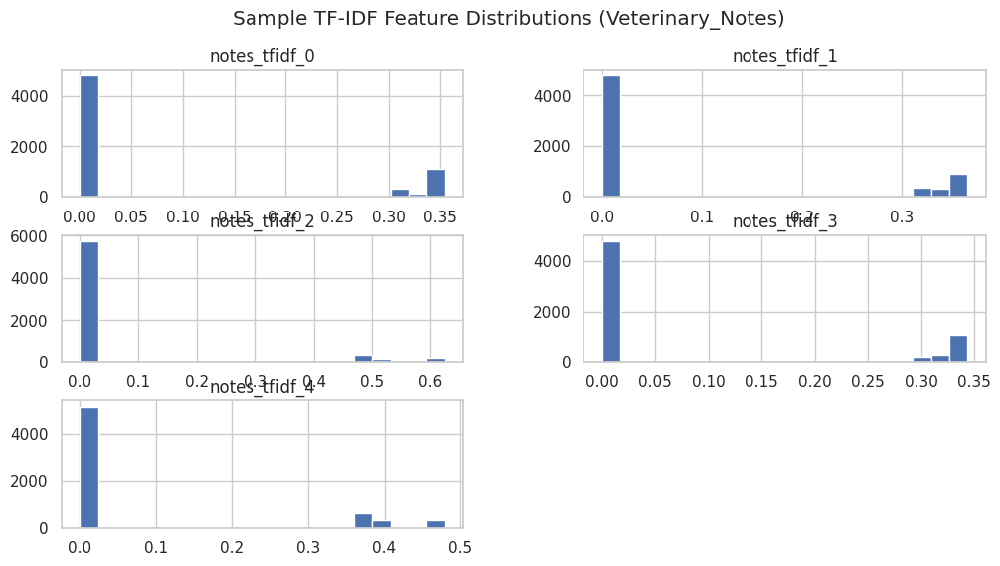


Converting processed 'Prescription' to TF-IDF features...
TF-IDF (Prescription) shape: (6388, 38)
   prescription_tfidf_0  prescription_tfidf_1  prescription_tfidf_2  \
0              0.000000              0.000000                   0.0   
1              0.000000              0.000000                   0.0   
2              0.330035              0.330035                   0.0   
3              0.000000              0.000000                   0.0   
4              0.303839              0.303839                   0.0   

   prescription_tfidf_3  prescription_tfidf_4  prescription_tfidf_5  \
0                   0.0              0.409371                   0.0   
1                   0.0              0.000000                   0.0   
2                   0.0              0.365934                   0.0   
3                   0.0              0.000000                   0.0   
4                   0.0              0.000000                   0.0   

   prescription_tfidf_6  prescription_tfidf_7  

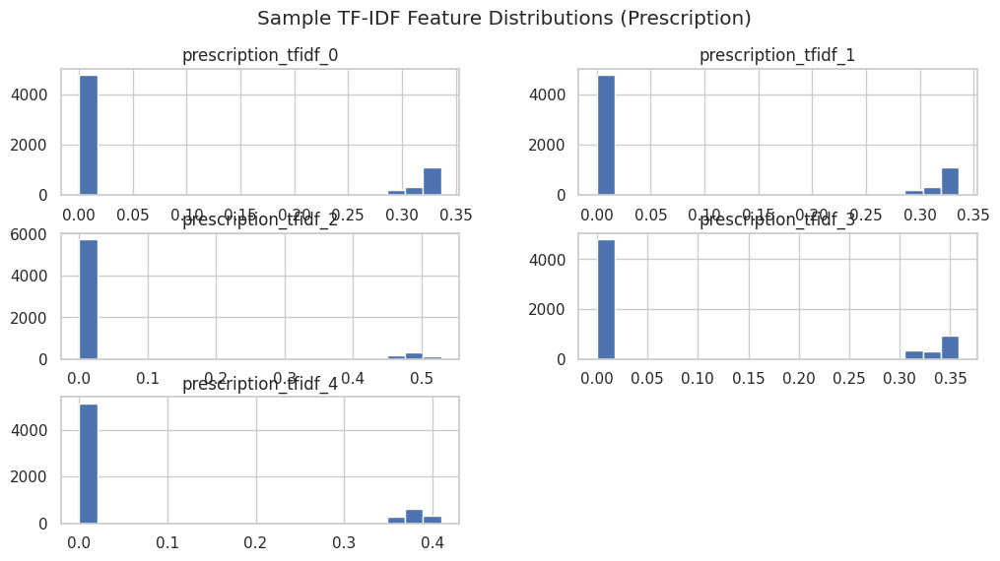


Applying Truncated SVD on TF-IDF features for Veterinary_Notes...
Reduced TF-IDF shape: (6388, 36)


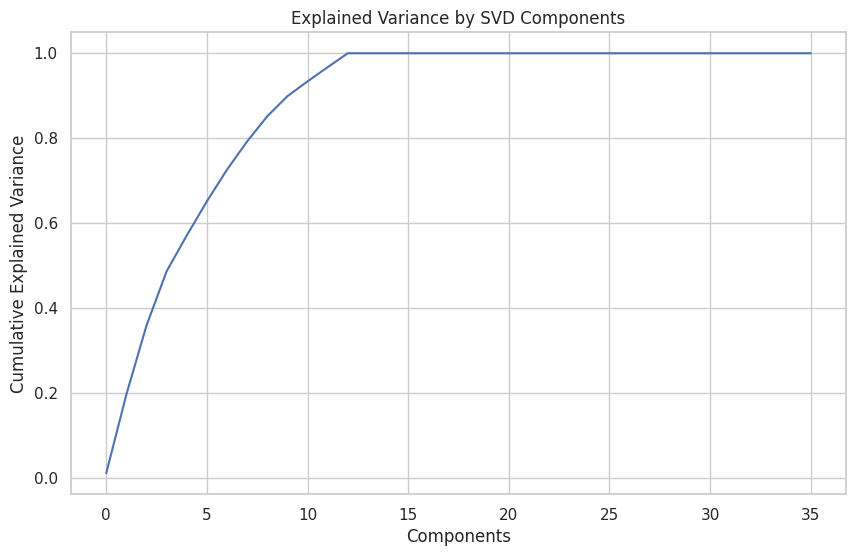

Dropped original TF-IDF columns: []

Final shape of processed textual data: (6388, 82)
===== Textual Data Preprocessing Completed =====


In [ ]:
import pandas as pd
import numpy as np
import re
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import TruncatedSVD

# Enable inline plotting for Google Colab
%matplotlib inline

# Download required NLTK resources
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')

sns.set(style='whitegrid')
plt.rcParams['figure.figsize'] = (10, 6)

def preprocess_text(text):
    if pd.isna(text):
        return ""

    text = text.lower()
    text = re.sub(r'[^a-zA-Z\s]', '', text)
    tokens = word_tokenize(text)
    stop_words = set(stopwords.words('english'))
    tokens = [token for token in tokens if token not in stop_words]
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(token) for token in tokens]
    return ' '.join(tokens)


print("===== Starting Textual Data Preprocessing =====")
processed_dff = textual_data.copy()

for col in ['Veterinary_Notes', 'Prescription']:
    if col in processed_dff.columns:
        print(f"\nProcessing column: {col}")
        processed_dff[f'processed_{col}'] = processed_dff[col].apply(preprocess_text)
        print(f"Sample processed {col}:")
        print(processed_dff[f'processed_{col}'].head())

        # Word count distribution
        processed_dff[f'{col}_word_count'] = processed_dff[f'processed_{col}'].apply(lambda x: len(x.split()))
        sns.histplot(processed_dff[f'{col}_word_count'], bins=30, kde=True)
        plt.title(f"Word Count Distribution for {col}")
        plt.xlabel("Word Count")
        plt.ylabel("Frequency")
        plt.show()

# TF-IDF for Veterinary_Notes
print("\nConverting processed 'Veterinary_Notes' to TF-IDF features...")
tfidf_vectorizer = TfidfVectorizer(max_features=100)
if 'processed_Veterinary_Notes' in processed_dff.columns:
    tfidf_notes = tfidf_vectorizer.fit_transform(processed_dff['processed_Veterinary_Notes'])
    print("TF-IDF (Veterinary_Notes) shape:", tfidf_notes.shape)
    tfidf_notes_df = pd.DataFrame(tfidf_notes.toarray(), columns=[f'notes_tfidf_{i}' for i in range(tfidf_notes.shape[1])])
    print(tfidf_notes_df.head())
    processed_df = pd.concat([processed_dff, tfidf_notes_df], axis=1)

    tfidf_notes_df.iloc[:, :5].hist(bins=20, figsize=(12, 6))
    plt.suptitle("Sample TF-IDF Feature Distributions (Veterinary_Notes)")
    plt.show()

# TF-IDF for Prescription
print("\nConverting processed 'Prescription' to TF-IDF features...")
if 'processed_Prescription' in processed_dff.columns:
    tfidf_prescription = TfidfVectorizer(max_features=100).fit_transform(processed_dff['processed_Prescription'])
    print("TF-IDF (Prescription) shape:", tfidf_prescription.shape)
    tfidf_prescription_df = pd.DataFrame(tfidf_prescription.toarray(), columns=[f'prescription_tfidf_{i}' for i in range(tfidf_prescription.shape[1])])
    print(tfidf_prescription_df.head())
    processed_df = pd.concat([processed_dff, tfidf_prescription_df], axis=1)

    tfidf_prescription_df.iloc[:, :5].hist(bins=20, figsize=(12, 6))
    plt.suptitle("Sample TF-IDF Feature Distributions (Prescription)")
    plt.show()

# Dimensionality Reduction with SVD
if 'processed_Veterinary_Notes' in processed_dff.columns and tfidf_notes.shape[1] > 35:
    print("\nApplying Truncated SVD on TF-IDF features for Veterinary_Notes...")
    svd = TruncatedSVD(n_components=36, random_state=42)
    reduced_tfidf_notes = svd.fit_transform(tfidf_notes)
    reduced_notes_df = pd.DataFrame(reduced_tfidf_notes, columns=[f'notes_svd_{i}' for i in range(reduced_tfidf_notes.shape[1])])
    print("Reduced TF-IDF shape:", reduced_tfidf_notes.shape)
    processed_df = pd.concat([processed_df, reduced_notes_df], axis=1)

    plt.figure()
    plt.plot(np.cumsum(svd.explained_variance_ratio_))
    plt.xlabel("Components")
    plt.ylabel("Cumulative Explained Variance")
    plt.title("Explained Variance by SVD Components")
    plt.grid(True)
    plt.show()

    cols_to_drop = [col for col in processed_df.columns if col.startswith('notes_tfidf_')]
    processed_df.drop(cols_to_drop, axis=1, inplace=True)
    print(f"Dropped original TF-IDF columns: {cols_to_drop}")

print("\nFinal shape of processed textual data:", processed_df.shape)
print("===== Textual Data Preprocessing Completed =====")


In [ ]:
pip install -U kaleido

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 8.2 MB/s eta 0:00:00


**2. Exploratory Data Analysis (EDA)**

In [ ]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
# Multi-dimensional Visualization of Medical Conditions
# Create a bubble chart
medical_diet = pd.crosstab(merged_data['Medical_Condition'], merged_data['Dietary_Recommendations'])

# Calculate totals for bubble size
medical_condition_counts = merged_data['Medical_Condition'].value_counts()

# Create a bubble chart using plotly
fig = go.Figure()

for diet in medical_diet.columns:
    fig.add_trace(go.Scatter(
        x=medical_diet.index,
        y=medical_diet[diet],
        mode='markers',
        name=diet,
        marker=dict(
            size=medical_condition_counts[medical_diet.index] / 10,  # Scale down for better visualization
            sizemode='area',
            sizeref=2.*max(medical_condition_counts)/100**2,
            opacity=0.6
        )
    ))

fig.update_layout(
    title='Medical Conditions vs Dietary Recommendations',
    xaxis=dict(title='Medical Condition'),
    yaxis=dict(title='Count'),
    legend_title='Dietary Recommendation',
    height=600,
    width=1000,
    margin=dict(l=20, r=20, t=40, b=20)
)

import plotly.io as pio

pio.write_image(fig, 'medical_condition_bubble.png')
fig.show()


Correlation Analysis:


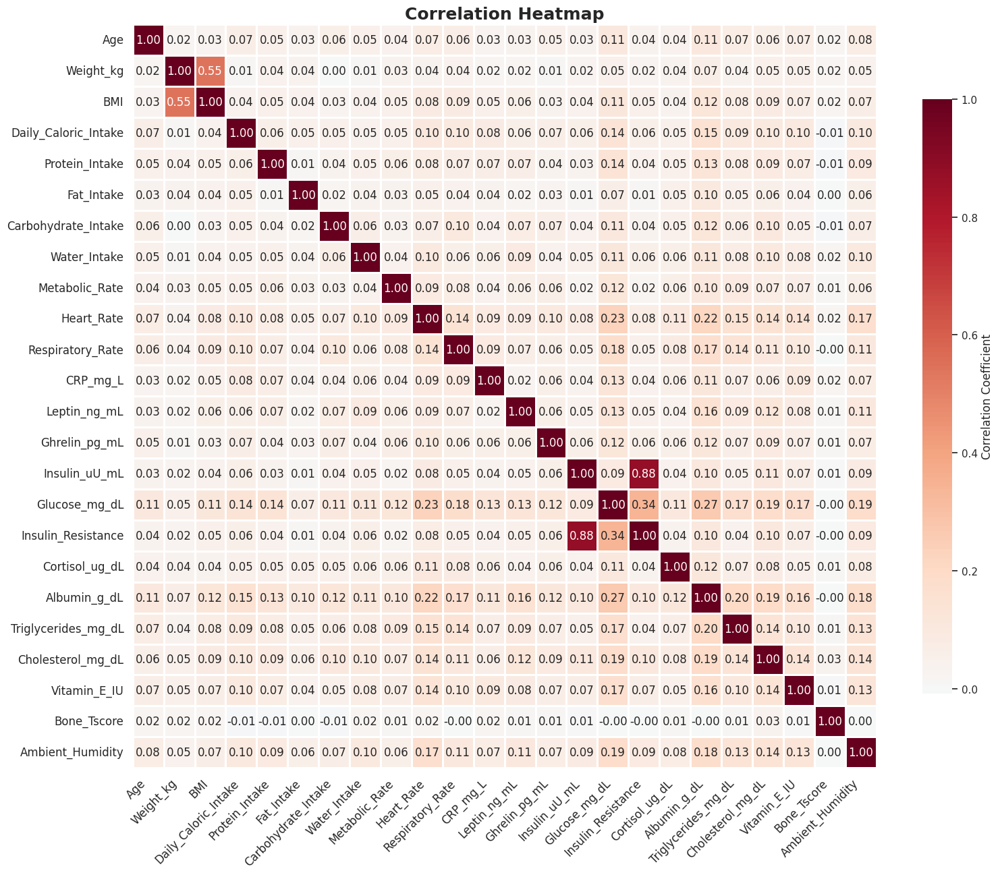

In [ ]:
print("\nCorrelation Analysis:")

# Prepare the correlation data
data_for_corr = merged_data.select_dtypes(include=['int64', 'float64']).drop(columns=['Animal_ID'], errors='ignore')
corr_matrix = data_for_corr.corr()


plt.figure(figsize=(16, 14))


sns.heatmap(
    corr_matrix,
    cmap='RdBu_r',
    center=0,
    annot=True,
    fmt=".2f",
    square=True,
    linewidths=1,
    linecolor='white',
    cbar_kws={"shrink": 0.7, 'label': 'Correlation Coefficient'}
)

plt.title('Correlation Heatmap', fontsize=18, weight='bold')
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(rotation=0, fontsize=12)
plt.tight_layout()
plt.show()

In [ ]:
# Statistical summary of numerical features
print("\nStatistical summary of numerical features:")
numerical_cols = merged_data.select_dtypes(include=['int64', 'float64']).columns.tolist()
numerical_cols = [col for col in numerical_cols if col != 'Animal_ID']
numerical_summary = merged_data[numerical_cols].describe()
print(numerical_summary)


Statistical summary of numerical features:
               Age    Weight_kg          BMI  Daily_Caloric_Intake  \
count  6092.000000  5614.000000  5737.000000           5092.000000   
mean     10.613024   293.654531   176.558823           1368.920145   
std       5.995495   284.666553    95.333116            712.508122   
min       1.000000     5.010000     4.260000            200.100000   
25%       6.000000    28.270000   104.140000            768.350000   
50%      10.000000   116.680000   170.750000           1363.000000   
75%      16.000000   545.652500   241.630000           1932.850000   
max      49.840341  2313.362437   922.133660           6534.660269   

       Protein_Intake   Fat_Intake  Carbohydrate_Intake  Water_Intake  \
count     5359.000000  4819.000000          4788.000000   5244.000000   
mean        81.402771   102.945574           163.390069      2.812463   
std         42.662865    58.378585            85.386334      1.383963   
min         10.000000     5.00000

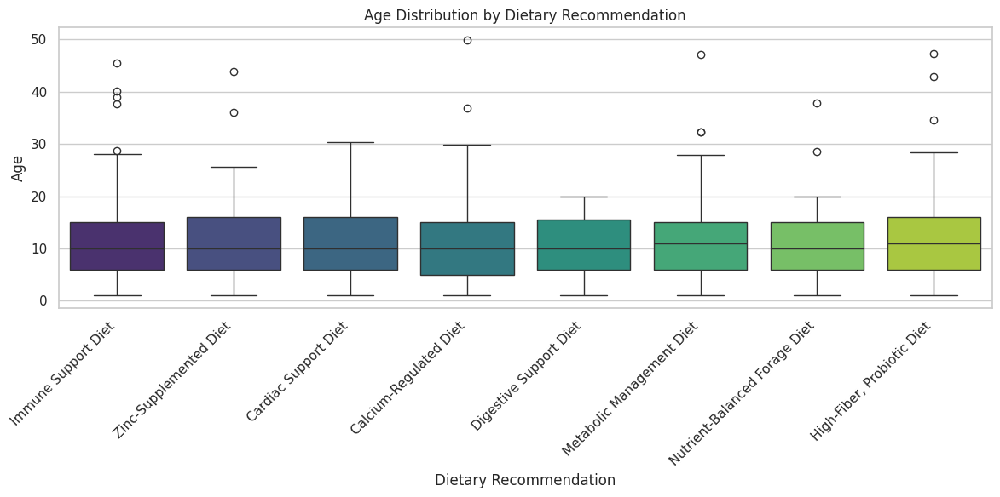


Summary statistics for Age by Dietary Recommendation:
                                count       mean       std  min  25%   50%  \
Dietary_Recommendations                                                      
Calcium-Regulated Diet          594.0  10.419814  6.155357  1.0  5.0  10.0   
Cardiac Support Diet            656.0  10.576375  5.737112  1.0  6.0  10.0   
Digestive Support Diet          587.0  10.332198  5.793108  1.0  6.0  10.0   
High-Fiber, Probiotic Diet      554.0  11.090171  6.507408  1.0  6.0  11.0   
Immune Support Diet            1809.0  10.574379  5.968948  1.0  6.0  10.0   
Metabolic Management Diet       574.0  10.912984  6.112107  1.0  6.0  11.0   
Nutrient-Balanced Forage Diet   576.0  10.455430  5.709611  1.0  6.0  10.0   
Zinc-Supplemented Diet          742.0  10.650515  6.036797  1.0  6.0  10.0   

                                75%        max  
Dietary_Recommendations                         
Calcium-Regulated Diet         15.0  49.840341  
Cardiac Support D

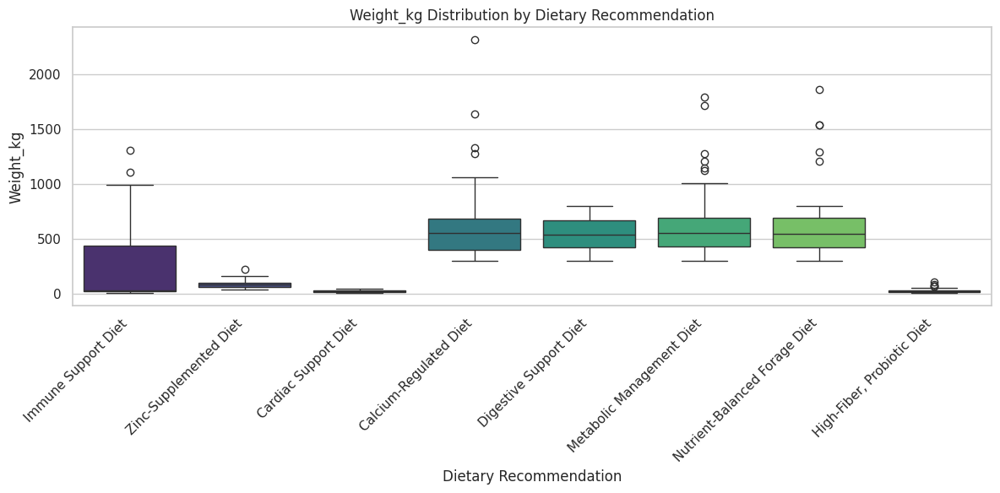


Summary statistics for Weight_kg by Dietary Recommendation:
                                count        mean         std     min  \
Dietary_Recommendations                                                 
Calcium-Regulated Diet          560.0  555.507982  181.928665  300.20   
Cardiac Support Diet            624.0   22.229972    9.821260    5.01   
Digestive Support Diet          550.0  547.302600  144.187554  300.50   
High-Fiber, Probiotic Diet      478.0   23.620642   11.714947    5.03   
Immune Support Diet            1587.0  210.529949  268.972665    5.06   
Metabolic Management Diet       550.0  562.543152  171.877512  301.63   
Nutrient-Balanced Forage Diet   554.0  559.698571  174.278250  300.63   
Zinc-Supplemented Diet          711.0   81.196477   23.946869   40.09   

                                    25%      50%       75%          max  
Dietary_Recommendations                                                  
Calcium-Regulated Diet         401.9275  551.335  682.2400  

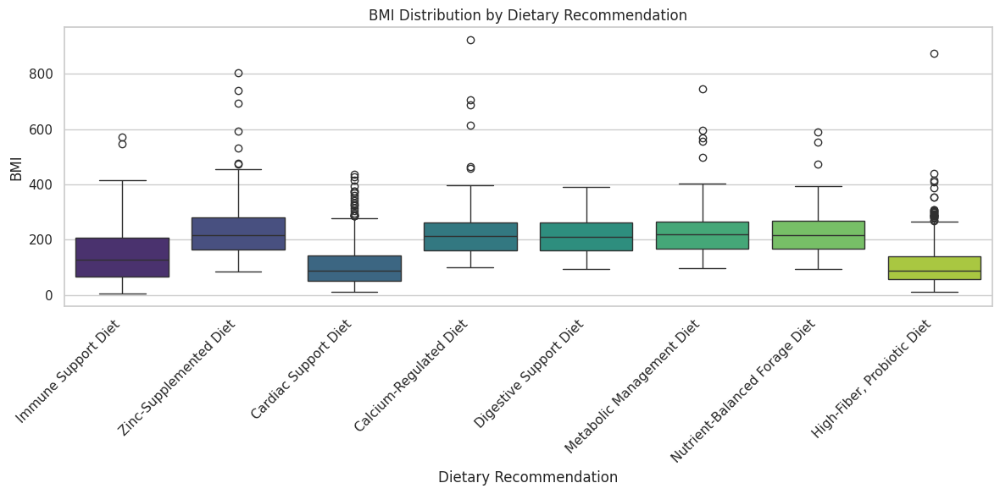


Summary statistics for BMI by Dietary Recommendation:
                                count        mean        std    min       25%  \
Dietary_Recommendations                                                         
Calcium-Regulated Diet          567.0  220.001046  81.622319  98.43  161.7850   
Cardiac Support Diet            609.0  108.347074  78.035318  11.97   50.8000   
Digestive Support Diet          558.0  215.580932  67.854146  94.21  162.3275   
High-Fiber, Probiotic Diet      521.0  108.783315  80.852489  11.52   56.6800   
Immune Support Diet            1702.0  143.698980  90.958953   4.26   67.5075   
Metabolic Management Diet       548.0  224.028810  75.966513  96.27  166.0050   
Nutrient-Balanced Forage Diet   537.0  220.883715  71.373501  94.23  165.8400   
Zinc-Supplemented Diet          695.0  229.159326  89.317139  84.22  163.6400   

                                   50%       75%         max  
Dietary_Recommendations                                       
Calcium-

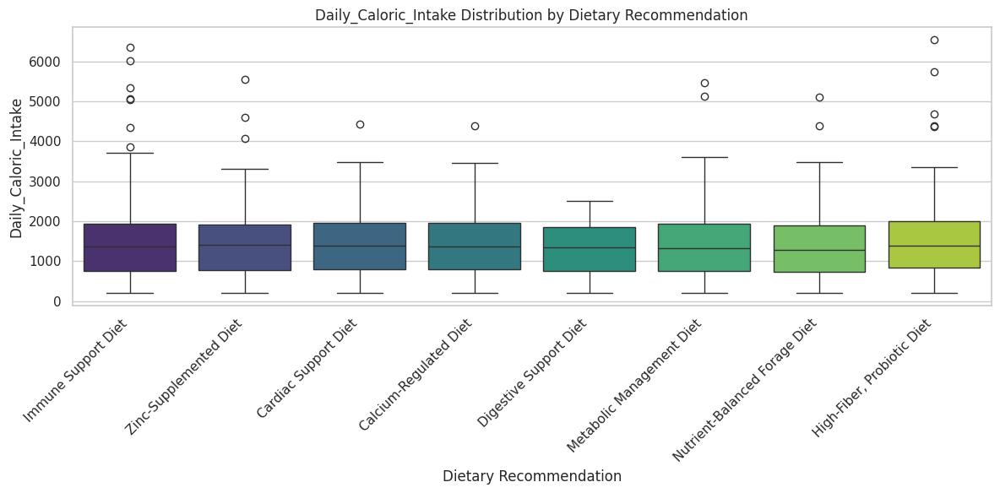


Summary statistics for Daily_Caloric_Intake by Dietary Recommendation:
                                count         mean         std    min  \
Dietary_Recommendations                                                 
Calcium-Regulated Diet          501.0  1379.589160  688.096225  208.1   
Cardiac Support Diet            533.0  1390.774746  689.229989  202.8   
Digestive Support Diet          507.0  1309.910256  646.444301  201.3   
High-Fiber, Probiotic Diet      450.0  1445.312543  777.267919  203.4   
Immune Support Diet            1515.0  1367.181222  724.967275  201.9   
Metabolic Management Diet       502.0  1358.317406  735.420646  200.5   
Nutrient-Balanced Forage Diet   474.0  1336.312357  708.644433  200.5   
Zinc-Supplemented Diet          610.0  1372.134722  705.215784  200.1   

                                   25%      50%       75%          max  
Dietary_Recommendations                                                 
Calcium-Regulated Diet         797.100  1371.10  19

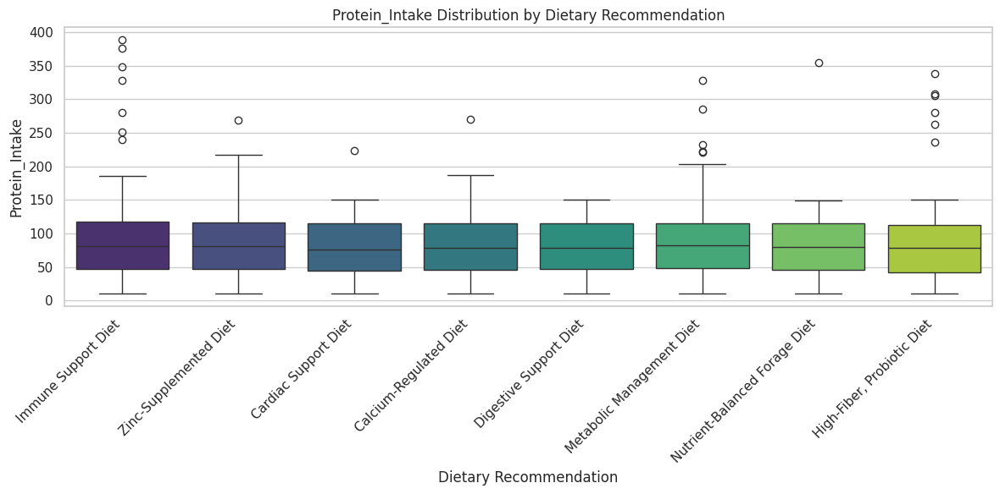


Summary statistics for Protein_Intake by Dietary Recommendation:
                                count       mean        std   min     25%  \
Dietary_Recommendations                                                     
Calcium-Regulated Diet          527.0  80.475895  40.519942  10.1  45.500   
Cardiac Support Diet            573.0  78.642424  41.430702  10.3  44.400   
Digestive Support Diet          514.0  80.190078  40.539465  10.0  47.175   
High-Fiber, Probiotic Diet      490.0  80.898255  46.501874  10.1  42.250   
Immune Support Diet            1584.0  82.805985  44.040661  10.1  46.475   
Metabolic Management Diet       505.0  83.184849  43.534420  10.0  47.900   
Nutrient-Balanced Forage Diet   514.0  80.438985  42.035371  10.5  45.375   
Zinc-Supplemented Diet          652.0  81.883486  40.411899  10.3  47.525   

                                 50%      75%         max  
Dietary_Recommendations                                    
Calcium-Regulated Diet         78.10  114.5

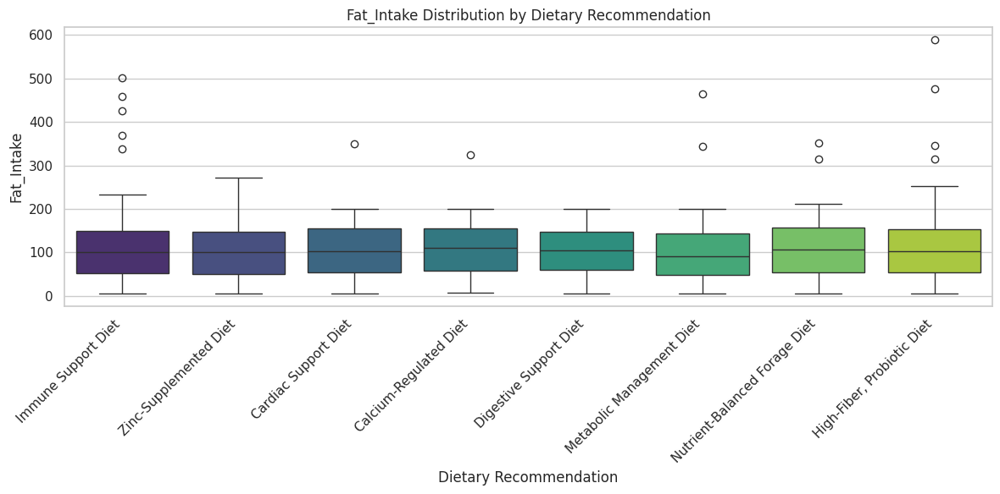


Summary statistics for Fat_Intake by Dietary Recommendation:
                                count        mean        std  min     25%  \
Dietary_Recommendations                                                     
Calcium-Regulated Diet          450.0  106.770314  56.578496  6.6  58.350   
Cardiac Support Diet            527.0  104.097708  58.052110  5.1  54.350   
Digestive Support Diet          475.0  103.085263  54.078106  5.3  59.900   
High-Fiber, Probiotic Diet      456.0  104.250367  63.896191  5.6  53.150   
Immune Support Diet            1432.0  102.481582  58.654564  5.0  52.525   
Metabolic Management Diet       457.0   97.412870  59.951314  5.4  48.900   
Nutrient-Balanced Forage Diet   446.0  107.023421  59.382576  5.9  55.000   
Zinc-Supplemented Diet          576.0  100.140913  55.960436  5.2  51.150   

                                  50%      75%         max  
Dietary_Recommendations                                     
Calcium-Regulated Diet         110.10  154.65

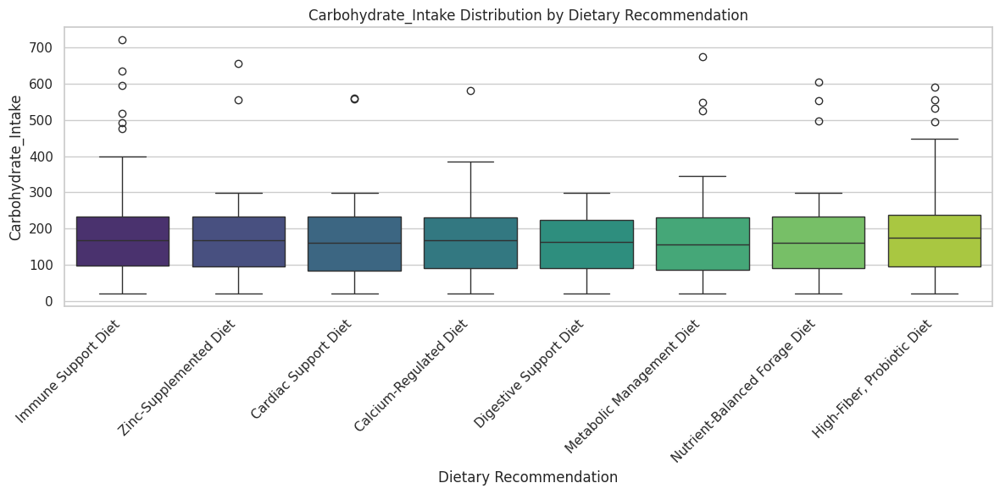


Summary statistics for Carbohydrate_Intake by Dietary Recommendation:
                                count        mean        std   min     25%  \
Dietary_Recommendations                                                      
Calcium-Regulated Diet          474.0  161.747568  83.692165  21.0  91.125   
Cardiac Support Diet            498.0  161.573789  86.753643  20.3  83.775   
Digestive Support Diet          471.0  160.929936  81.940786  20.2  91.500   
High-Fiber, Probiotic Diet      447.0  170.822515  89.985888  20.9  96.050   
Immune Support Diet            1429.0  164.539197  83.090707  20.1  96.800   
Metabolic Management Diet       449.0  159.180114  89.423344  20.1  87.100   
Nutrient-Balanced Forage Diet   447.0  162.036458  87.534893  20.6  91.250   
Zinc-Supplemented Diet          573.0  164.040506  85.486822  20.0  95.300   

                                  50%      75%         max  
Dietary_Recommendations                                     
Calcium-Regulated Diet    

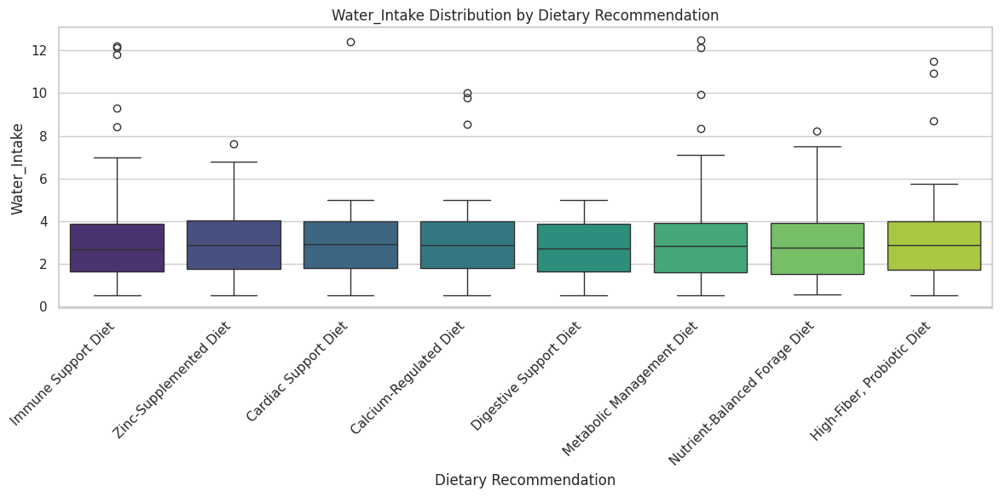


Summary statistics for Water_Intake by Dietary Recommendation:
                                count      mean       std   min     25%  \
Dietary_Recommendations                                                   
Calcium-Regulated Diet          506.0  2.886055  1.376985  0.52  1.8000   
Cardiac Support Diet            583.0  2.862628  1.350075  0.50  1.7900   
Digestive Support Diet          498.0  2.748715  1.312712  0.51  1.6225   
High-Fiber, Probiotic Diet      471.0  2.861333  1.471221  0.52  1.6950   
Immune Support Diet            1543.0  2.766339  1.381396  0.50  1.6350   
Metabolic Management Diet       503.0  2.827541  1.523120  0.51  1.6050   
Nutrient-Balanced Forage Diet   503.0  2.745863  1.343907  0.53  1.5150   
Zinc-Supplemented Diet          637.0  2.874206  1.327579  0.51  1.7300   

                                 50%     75%        max  
Dietary_Recommendations                                  
Calcium-Regulated Diet         2.855  3.9850  10.036169  
Cardiac Sup

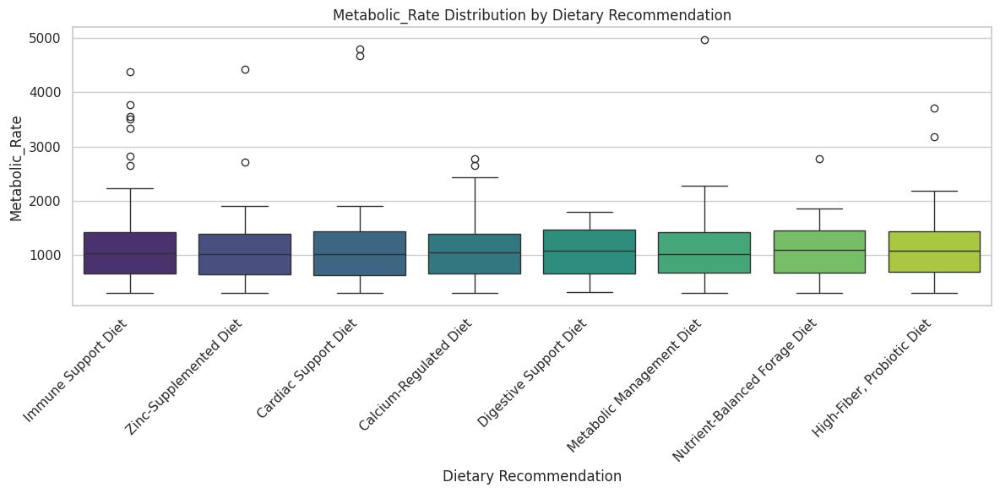


Summary statistics for Metabolic_Rate by Dietary Recommendation:
                                count         mean         std    min     25%  \
Dietary_Recommendations                                                         
Calcium-Regulated Diet          493.0  1050.487661  450.873594  304.2  659.40   
Cardiac Support Diet            529.0  1052.859101  506.332854  302.4  628.20   
Digestive Support Diet          495.0  1067.530303  445.511571  313.1  659.30   
High-Fiber, Probiotic Diet      451.0  1080.197790  462.481641  301.8  695.45   
Immune Support Diet            1496.0  1054.024270  461.982857  300.5  661.65   
Metabolic Management Diet       499.0  1053.376377  468.419771  305.7  678.70   
Nutrient-Balanced Forage Diet   481.0  1070.718911  456.779124  304.0  672.20   
Zinc-Supplemented Diet          619.0  1046.987537  454.747594  302.1  649.15   

                                   50%      75%          max  
Dietary_Recommendations                                     

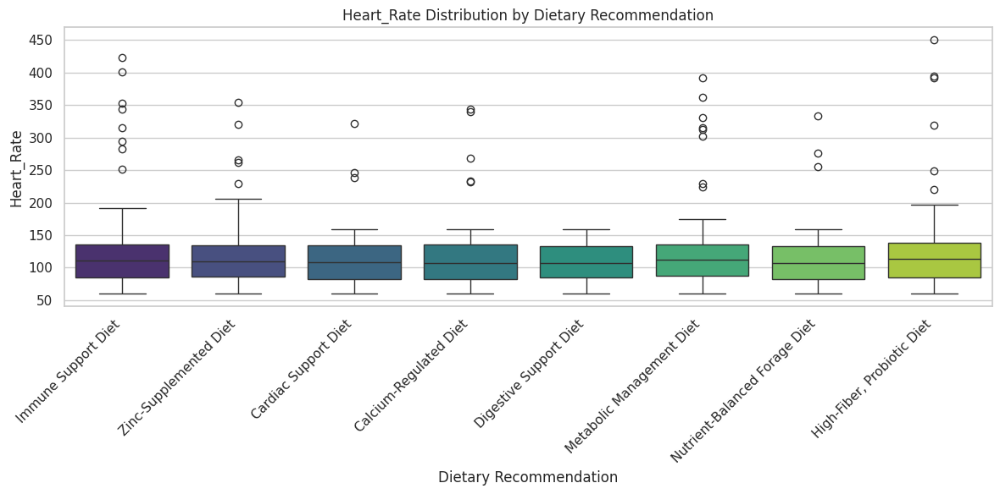


Summary statistics for Heart_Rate by Dietary Recommendation:
                                count        mean        std   min   25%  \
Dietary_Recommendations                                                    
Calcium-Regulated Diet          512.0  109.388548  34.130859  60.0  83.0   
Cardiac Support Diet            560.0  109.306867  31.122176  60.0  82.0   
Digestive Support Diet          508.0  107.816929  28.066067  60.0  85.0   
High-Fiber, Probiotic Diet      489.0  113.530004  40.279139  60.0  85.0   
Immune Support Diet            1578.0  111.408476  33.557787  60.0  85.0   
Metabolic Management Diet       513.0  113.419390  38.225880  60.0  87.0   
Nutrient-Balanced Forage Diet   508.0  109.163107  32.080902  60.0  83.0   
Zinc-Supplemented Diet          648.0  111.771264  32.617454  60.0  86.0   

                                 50%     75%         max  
Dietary_Recommendations                                   
Calcium-Regulated Diet         107.0  135.25  343.573303  


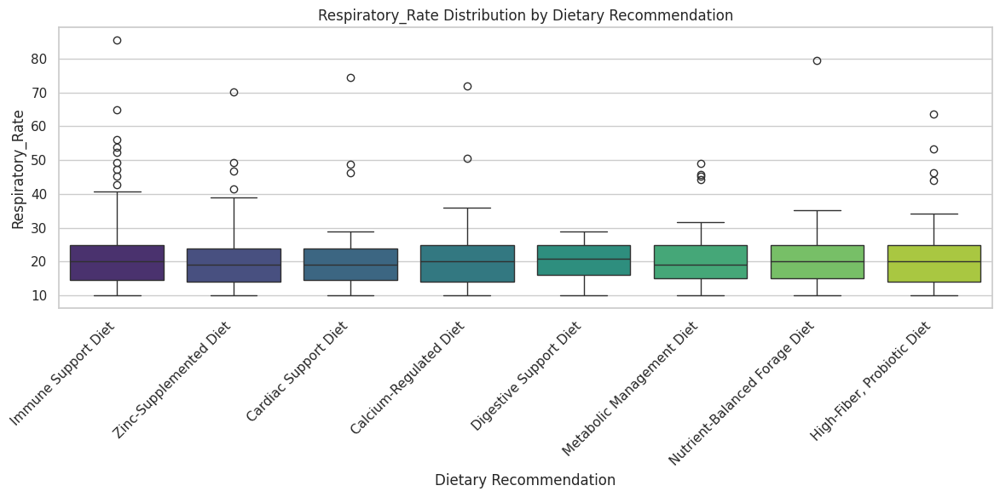


Summary statistics for Respiratory_Rate by Dietary Recommendation:
                                count       mean       std   min   25%   50%  \
Dietary_Recommendations                                                        
Calcium-Regulated Diet          526.0  19.854266  6.496038  10.0  14.0  20.0   
Cardiac Support Diet            591.0  19.584823  6.349497  10.0  14.5  19.0   
Digestive Support Diet          526.0  20.195817  5.665069  10.0  16.0  21.0   
High-Fiber, Probiotic Diet      489.0  19.743841  6.645168  10.0  14.0  20.0   
Immune Support Diet            1603.0  19.729218  6.497490  10.0  14.5  20.0   
Metabolic Management Diet       535.0  19.705566  6.136773  10.0  15.0  19.0   
Nutrient-Balanced Forage Diet   501.0  19.675942  6.444582  10.0  15.0  20.0   
Zinc-Supplemented Diet          676.0  19.415676  6.401643  10.0  14.0  19.0   

                                75%        max  
Dietary_Recommendations                         
Calcium-Regulated Diet         25

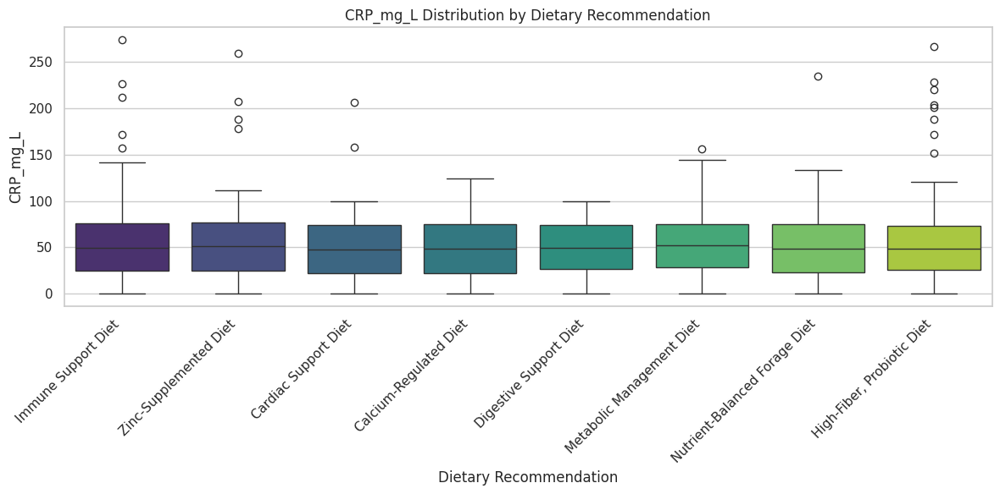


Summary statistics for CRP_mg_L by Dietary Recommendation:
                                count       mean        std  min    25%   50%  \
Dietary_Recommendations                                                         
Calcium-Regulated Diet          591.0  49.116613  29.506067  0.5  21.85  48.2   
Cardiac Support Diet            657.0  49.185251  30.092210  0.0  22.20  47.9   
Digestive Support Diet          596.0  49.775503  28.341284  0.1  26.50  49.9   
High-Fiber, Probiotic Diet      547.0  51.559849  33.310050  0.1  25.60  48.7   
Immune Support Diet            1789.0  50.436109  30.416873  0.2  24.70  49.2   
Metabolic Management Diet       578.0  52.028233  29.258566  0.5  28.45  52.5   
Nutrient-Balanced Forage Diet   580.0  49.601245  30.846644  0.0  22.60  48.2   
Zinc-Supplemented Diet          731.0  51.415092  31.358957  0.1  24.55  51.4   

                                  75%         max  
Dietary_Recommendations                            
Calcium-Regulated Diet   

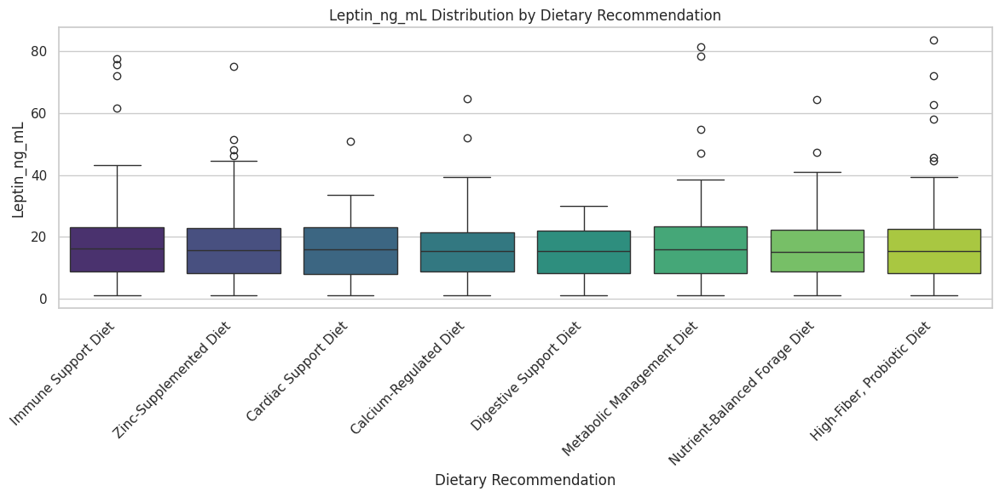


Summary statistics for Leptin_ng_mL by Dietary Recommendation:
                                count       mean       std  min  25%   50%  \
Dietary_Recommendations                                                      
Calcium-Regulated Diet          595.0  15.492737  8.390988  1.0  8.8  15.3   
Cardiac Support Diet            659.0  15.633983  8.697776  1.0  8.0  16.0   
Digestive Support Diet          591.0  15.257022  8.312709  1.2  8.2  15.4   
High-Fiber, Probiotic Diet      546.0  15.898785  9.816602  1.1  8.2  15.5   
Immune Support Diet            1793.0  15.922182  8.791996  1.0  8.8  16.1   
Metabolic Management Diet       578.0  16.023622  9.623130  1.0  8.1  15.9   
Nutrient-Balanced Forage Diet   573.0  15.733732  8.646800  1.1  8.7  15.0   
Zinc-Supplemented Diet          738.0  15.924718  9.062104  1.0  8.2  15.7   

                                75%        max  
Dietary_Recommendations                         
Calcium-Regulated Diet         21.5  64.744750  
Cardiac 

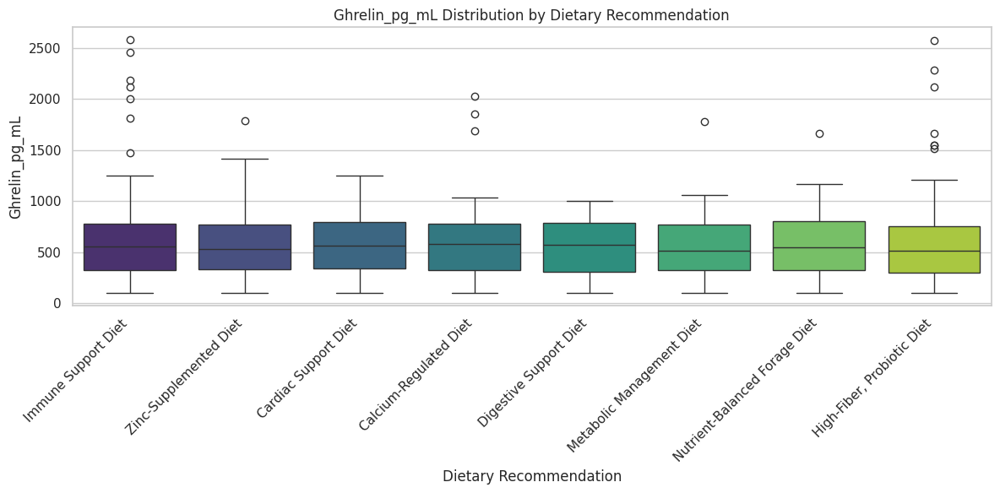


Summary statistics for Ghrelin_pg_mL by Dietary Recommendation:
                                count        mean         std    min      25%  \
Dietary_Recommendations                                                         
Calcium-Regulated Diet          588.0  562.262272  280.089763  100.1  327.200   
Cardiac Support Diet            659.0  570.498920  262.602031  100.7  343.450   
Digestive Support Diet          593.0  551.292243  266.347537  100.2  306.100   
High-Fiber, Probiotic Diet      544.0  547.612223  307.932665  100.3  297.075   
Immune Support Diet            1790.0  558.397573  278.733294  100.2  324.250   
Metabolic Management Diet       577.0  541.017368  264.764724  102.4  321.800   
Nutrient-Balanced Forage Diet   559.0  558.466549  269.621872  101.2  328.400   
Zinc-Supplemented Diet          739.0  551.977988  266.288083  103.4  331.250   

                                  50%      75%          max  
Dietary_Recommendations                                      


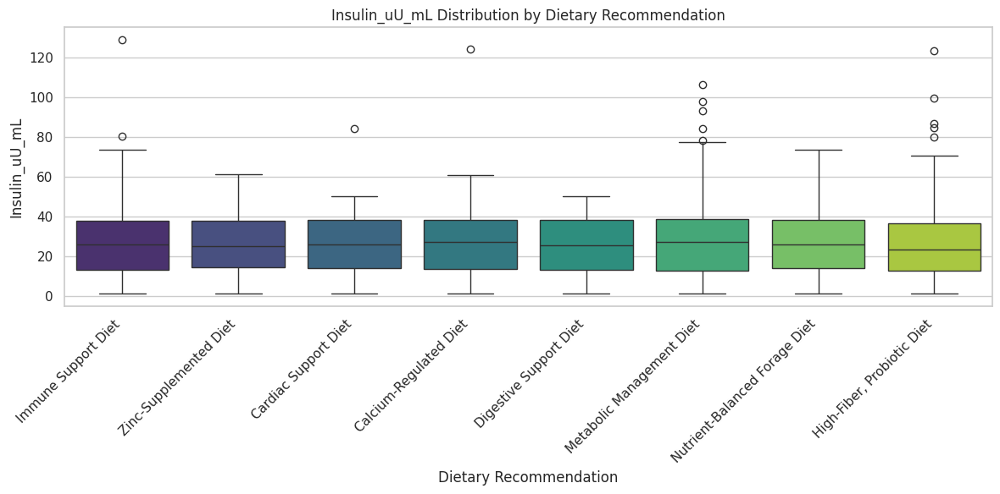


Summary statistics for Insulin_uU_mL by Dietary Recommendation:
                                count       mean        std  min        25%  \
Dietary_Recommendations                                                       
Calcium-Regulated Diet          595.0  26.269213  14.939270  1.0  13.384624   
Cardiac Support Diet            650.0  25.816914  14.224942  1.0  14.000000   
Digestive Support Diet          587.0  25.252300  14.350489  1.1  12.850000   
High-Fiber, Probiotic Diet      543.0  24.923292  15.919650  1.1  12.400000   
Immune Support Diet            1789.0  25.786317  14.661888  1.1  13.200000   
Metabolic Management Diet       574.0  26.525306  16.182370  1.0  12.600000   
Nutrient-Balanced Forage Diet   578.0  25.831850  14.253885  1.2  13.800000   
Zinc-Supplemented Diet          740.0  25.615084  13.846952  1.0  14.300000   

                                 50%    75%         max  
Dietary_Recommendations                                  
Calcium-Regulated Diet      

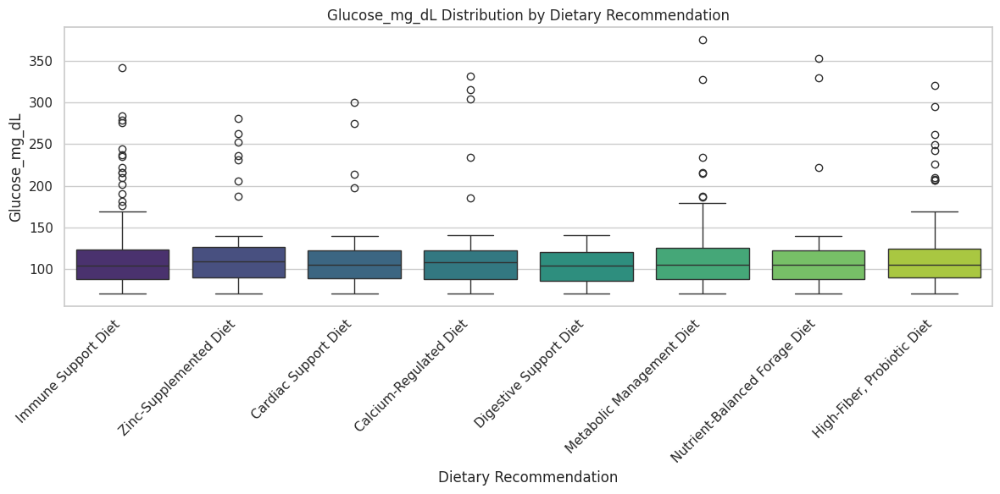


Summary statistics for Glucose_mg_dL by Dietary Recommendation:
                                count        mean        std   min     25%  \
Dietary_Recommendations                                                      
Calcium-Regulated Diet          595.0  107.073021  25.842333  70.3  87.800   
Cardiac Support Diet            664.0  105.872005  22.706544  70.1  88.575   
Digestive Support Diet          586.0  103.492833  20.394691  70.1  85.350   
High-Fiber, Probiotic Diet      552.0  108.567584  27.560473  70.0  90.000   
Immune Support Diet            1788.0  105.932883  23.662183  70.0  87.775   
Metabolic Management Diet       579.0  106.977713  27.185580  70.1  88.050   
Nutrient-Balanced Forage Diet   578.0  105.871473  24.936384  70.1  87.400   
Zinc-Supplemented Diet          744.0  108.473204  24.069884  70.0  89.600   

                                  50%      75%         max  
Dietary_Recommendations                                     
Calcium-Regulated Diet         1

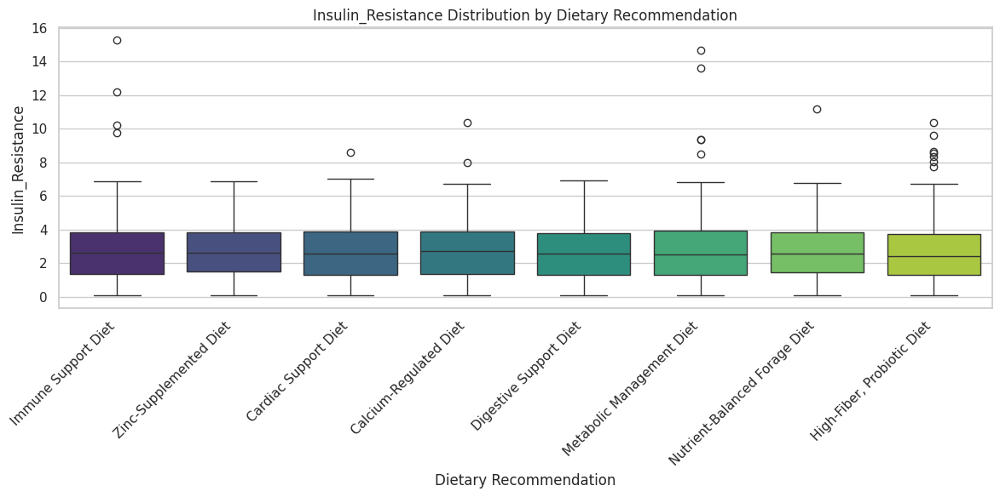


Summary statistics for Insulin_Resistance by Dietary Recommendation:
                                count      mean       std   min     25%  \
Dietary_Recommendations                                                   
Calcium-Regulated Diet          589.0  2.754746  1.656262  0.10  1.3600   
Cardiac Support Diet            664.0  2.674738  1.613548  0.10  1.3250   
Digestive Support Diet          588.0  2.647602  1.631244  0.08  1.2975   
High-Fiber, Probiotic Diet      543.0  2.655536  1.750930  0.09  1.3250   
Immune Support Diet            1815.0  2.705101  1.659062  0.08  1.3400   
Metabolic Management Diet       578.0  2.783177  1.857826  0.09  1.3050   
Nutrient-Balanced Forage Diet   574.0  2.706749  1.587209  0.09  1.4600   
Zinc-Supplemented Diet          724.0  2.760550  1.591773  0.08  1.5100   

                                 50%     75%        max  
Dietary_Recommendations                                  
Calcium-Regulated Diet         2.750  3.8800  10.352725  
Cardi

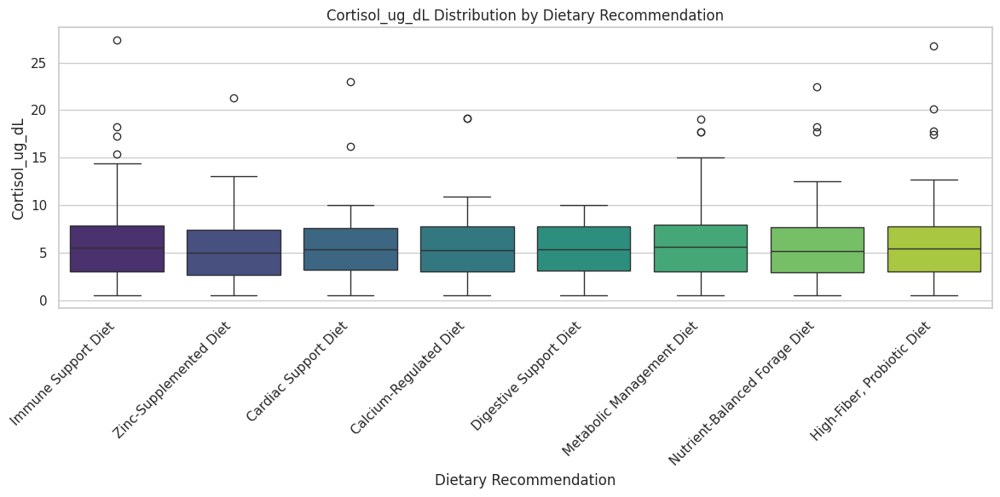


Summary statistics for Cortisol_ug_dL by Dietary Recommendation:
                                count      mean       std   min     25%  \
Dietary_Recommendations                                                   
Calcium-Regulated Diet          594.0  5.370051  2.825474  0.53  3.0200   
Cardiac Support Diet            647.0  5.324890  2.816544  0.51  3.1700   
Digestive Support Diet          587.0  5.431908  2.713234  0.52  3.1550   
High-Fiber, Probiotic Diet      558.0  5.465170  3.052501  0.50  3.0700   
Immune Support Diet            1783.0  5.440107  2.902606  0.51  2.9850   
Metabolic Management Diet       580.0  5.576262  2.953762  0.52  3.0350   
Nutrient-Balanced Forage Diet   574.0  5.369281  3.006998  0.51  2.9575   
Zinc-Supplemented Diet          732.0  5.087547  2.795314  0.50  2.6850   

                                 50%      75%        max  
Dietary_Recommendations                                   
Calcium-Regulated Diet         5.300  7.73000  19.183914  
Cardia

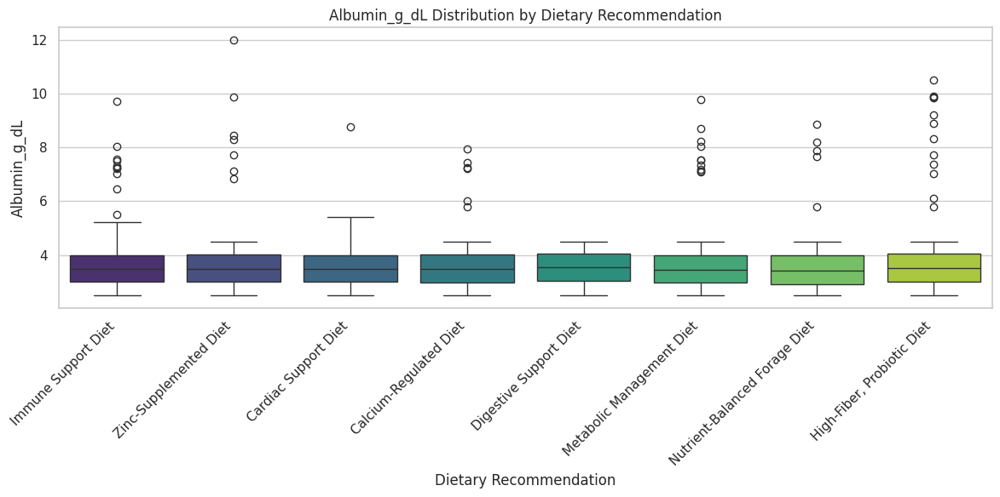


Summary statistics for Albumin_g_dL by Dietary Recommendation:
                                count      mean       std  min    25%   50%  \
Dietary_Recommendations                                                       
Calcium-Regulated Diet          590.0  3.531572  0.692621  2.5  2.980  3.48   
Cardiac Support Diet            652.0  3.506926  0.611213  2.5  3.000  3.49   
Digestive Support Diet          590.0  3.534203  0.583055  2.5  3.050  3.55   
High-Fiber, Probiotic Diet      547.0  3.610957  0.946123  2.5  3.025  3.51   
Immune Support Diet            1781.0  3.509351  0.651105  2.5  3.000  3.48   
Metabolic Management Diet       583.0  3.540252  0.822027  2.5  2.980  3.46   
Nutrient-Balanced Forage Diet   580.0  3.503650  0.712216  2.5  2.930  3.43   
Zinc-Supplemented Diet          737.0  3.552372  0.771773  2.5  3.010  3.50   

                                  75%        max  
Dietary_Recommendations                           
Calcium-Regulated Diet         4.0375   7.9

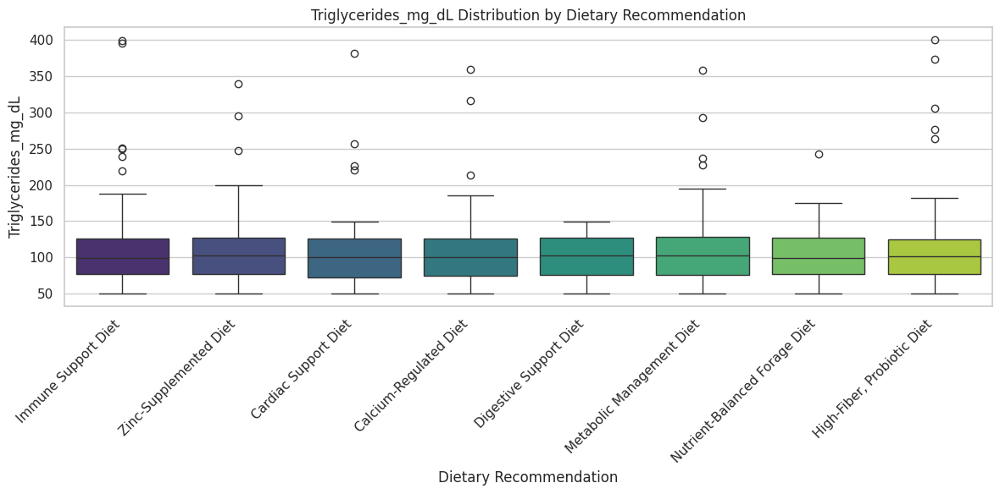


Summary statistics for Triglycerides_mg_dL by Dietary Recommendation:
                                count        mean        std   min     25%  \
Dietary_Recommendations                                                      
Calcium-Regulated Diet          590.0  101.637937  32.738783  50.1  74.425   
Cardiac Support Diet            658.0  100.761745  32.607714  50.2  72.800   
Digestive Support Diet          604.0  101.376325  28.921079  50.1  76.150   
High-Fiber, Probiotic Diet      553.0  103.284938  36.009960  50.0  77.000   
Immune Support Diet            1780.0  101.219782  30.883131  50.0  77.100   
Metabolic Management Diet       582.0  103.161972  33.775613  50.1  76.375   
Nutrient-Balanced Forage Diet   567.0  101.405078  29.178752  50.0  77.300   
Zinc-Supplemented Diet          728.0  102.374759  31.863820  50.2  76.650   

                                  50%      75%         max  
Dietary_Recommendations                                     
Calcium-Regulated Diet    

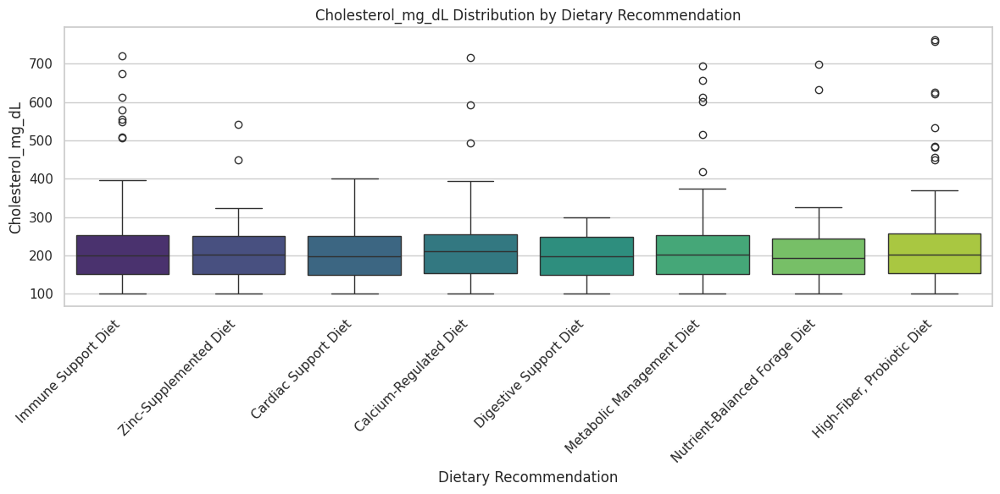


Summary statistics for Cholesterol_mg_dL by Dietary Recommendation:
                                count        mean        std    min     25%  \
Dietary_Recommendations                                                       
Calcium-Regulated Diet          586.0  206.832441  65.559834  100.7  153.45   
Cardiac Support Diet            655.0  199.513014  58.635133  100.0  149.65   
Digestive Support Diet          599.0  198.994658  57.235239  100.2  148.40   
High-Fiber, Probiotic Diet      550.0  209.252304  76.396097  100.3  154.05   
Immune Support Diet            1793.0  202.824878  64.589677  100.1  150.40   
Metabolic Management Diet       581.0  205.934528  70.170268  100.4  152.10   
Nutrient-Balanced Forage Diet   573.0  198.571264  63.130611  100.1  150.40   
Zinc-Supplemented Diet          739.0  200.928503  59.335900  100.2  151.20   

                                  50%      75%         max  
Dietary_Recommendations                                     
Calcium-Regulated 

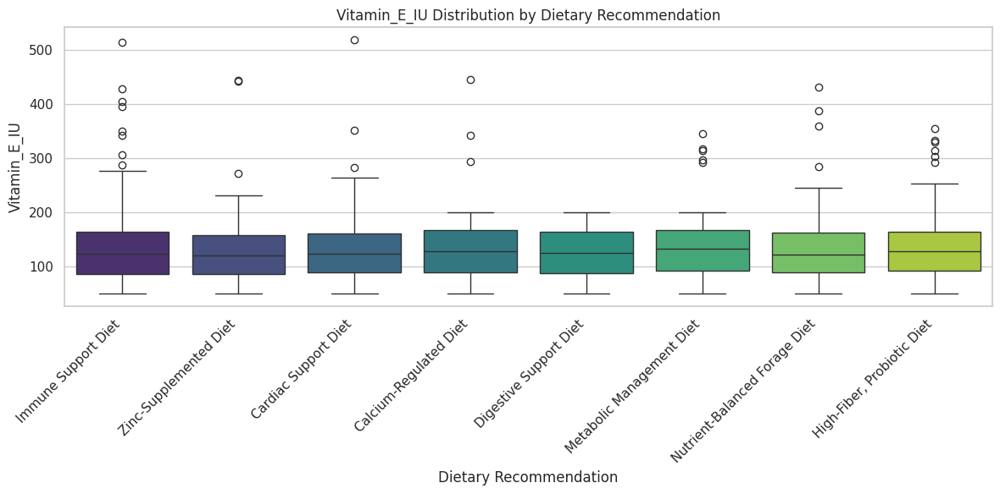


Summary statistics for Vitamin_E_IU by Dietary Recommendation:
                                count        mean        std   min   25%  \
Dietary_Recommendations                                                    
Calcium-Regulated Diet          593.0  128.497267  46.524439  50.0  90.0   
Cardiac Support Diet            653.0  126.280167  47.240912  50.0  89.0   
Digestive Support Diet          593.0  126.359191  45.001473  50.0  88.0   
High-Fiber, Probiotic Diet      548.0  130.049113  47.559544  50.0  93.0   
Immune Support Diet            1785.0  125.704663  48.310728  50.0  86.0   
Metabolic Management Diet       581.0  130.955808  46.157758  51.0  93.0   
Nutrient-Balanced Forage Diet   575.0  127.246445  47.768015  50.0  90.0   
Zinc-Supplemented Diet          735.0  123.053926  46.519534  50.0  86.0   

                                 50%    75%         max  
Dietary_Recommendations                                  
Calcium-Regulated Diet         129.0  167.0  445.171708  
C

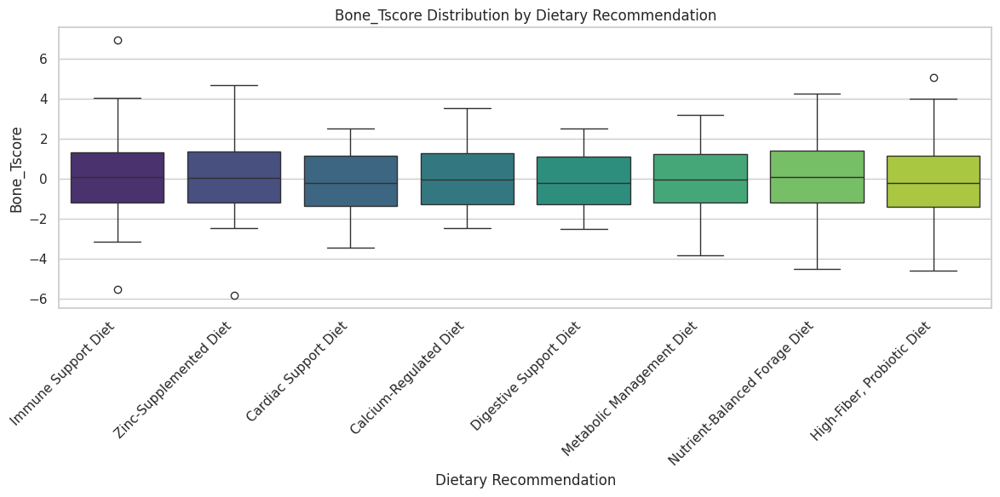


Summary statistics for Bone_Tscore by Dietary Recommendation:
                                count      mean       std       min    25%  \
Dietary_Recommendations                                                      
Calcium-Regulated Diet          594.0 -0.001338  1.444994 -2.490000 -1.270   
Cardiac Support Diet            667.0 -0.106675  1.462781 -3.451106 -1.345   
Digestive Support Diet          591.0 -0.102707  1.402480 -2.500000 -1.270   
High-Fiber, Probiotic Diet      547.0 -0.095072  1.505461 -4.589632 -1.420   
Immune Support Diet            1800.0  0.057108  1.480217 -5.527405 -1.210   
Metabolic Management Diet       575.0  0.006484  1.430442 -3.816319 -1.180   
Nutrient-Balanced Forage Diet   569.0  0.072447  1.495005 -4.510706 -1.180   
Zinc-Supplemented Diet          735.0  0.050318  1.461350 -5.849876 -1.185   

                                50%     75%       max  
Dietary_Recommendations                                
Calcium-Regulated Diet        -0.03  1.2975 

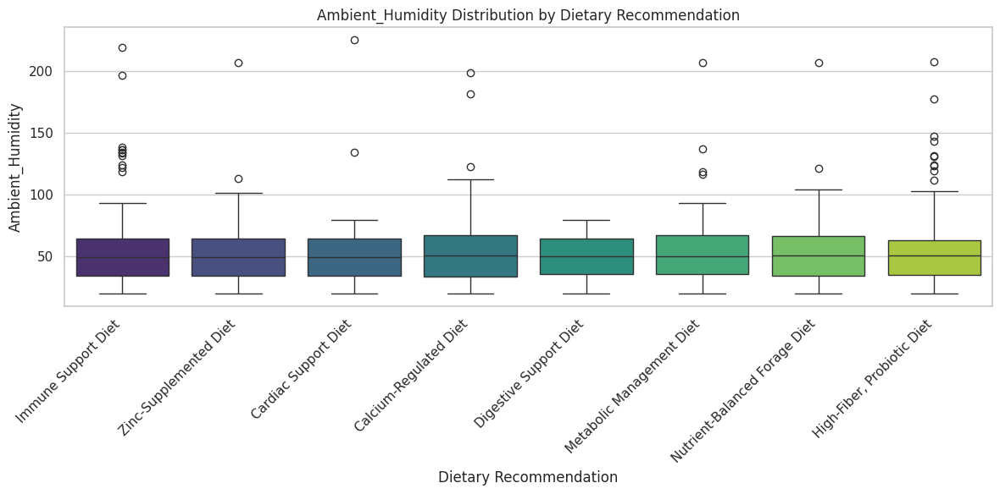


Summary statistics for Ambient_Humidity by Dietary Recommendation:
                                count       mean        std   min     25%  \
Dietary_Recommendations                                                     
Calcium-Regulated Diet          593.0  50.878263  20.052838  20.0  34.100   
Cardiac Support Diet            649.0  50.100234  18.761694  20.0  34.700   
Digestive Support Diet          592.0  50.181588  17.210059  20.0  35.725   
High-Fiber, Probiotic Diet      553.0  50.937206  21.261187  20.0  35.100   
Immune Support Diet            1794.0  50.044207  18.924491  20.0  34.800   
Metabolic Management Diet       576.0  51.347588  19.735176  20.1  35.575   
Nutrient-Balanced Forage Diet   572.0  50.943890  19.134915  20.0  34.375   
Zinc-Supplemented Diet          742.0  50.108448  19.014384  20.0  34.700   

                                 50%     75%         max  
Dietary_Recommendations                                   
Calcium-Regulated Diet         50.80  67.30

In [ ]:
# 4. Box Plot for Key Variables
features_to_plot = numerical_cols
count_order = merged_data['Dietary_Recommendations'].value_counts().index
for feature in features_to_plot:
    plt.figure(figsize=(12, 6))
    sns.boxplot(
        x='Dietary_Recommendations',
        y=feature,
        data=merged_data,
        palette='viridis',
        order=count_order
    )
    plt.title(f'{feature} Distribution by Dietary Recommendation')
    plt.xlabel('Dietary Recommendation')
    plt.ylabel(feature)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()
    print(f"\nSummary statistics for {feature} by Dietary Recommendation:")
    print(merged_data.groupby('Dietary_Recommendations')[feature].describe())



Numeric Feature Distributions:


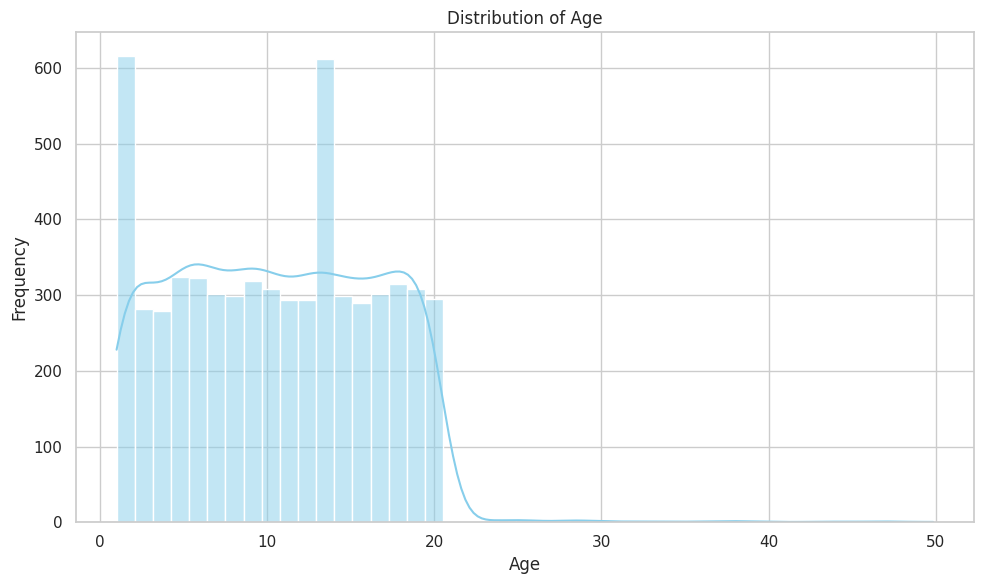

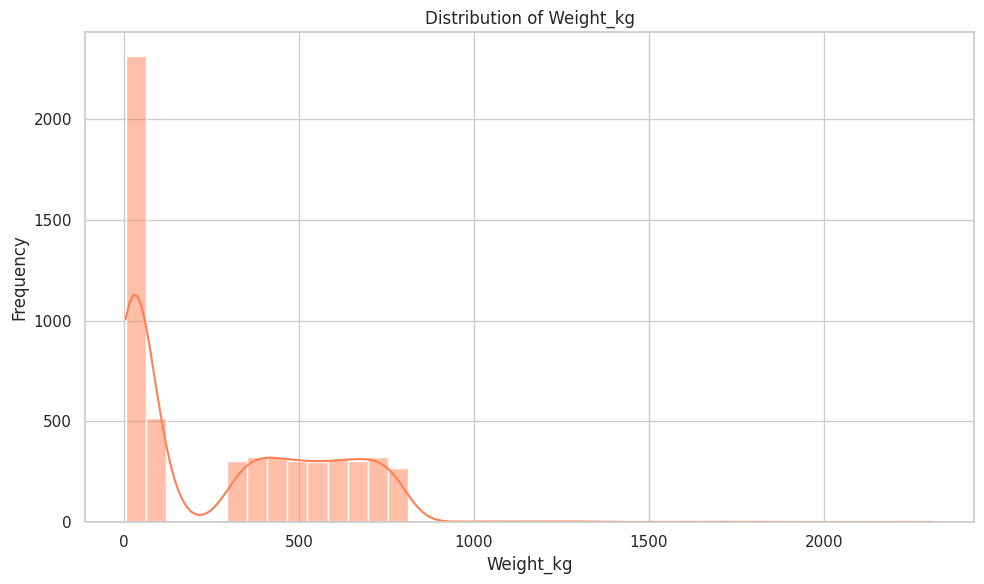

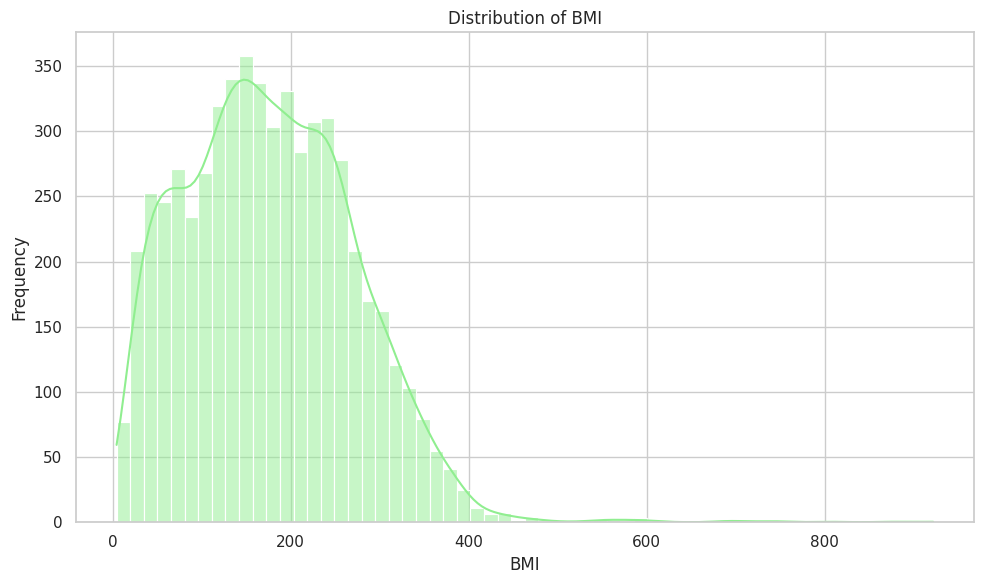

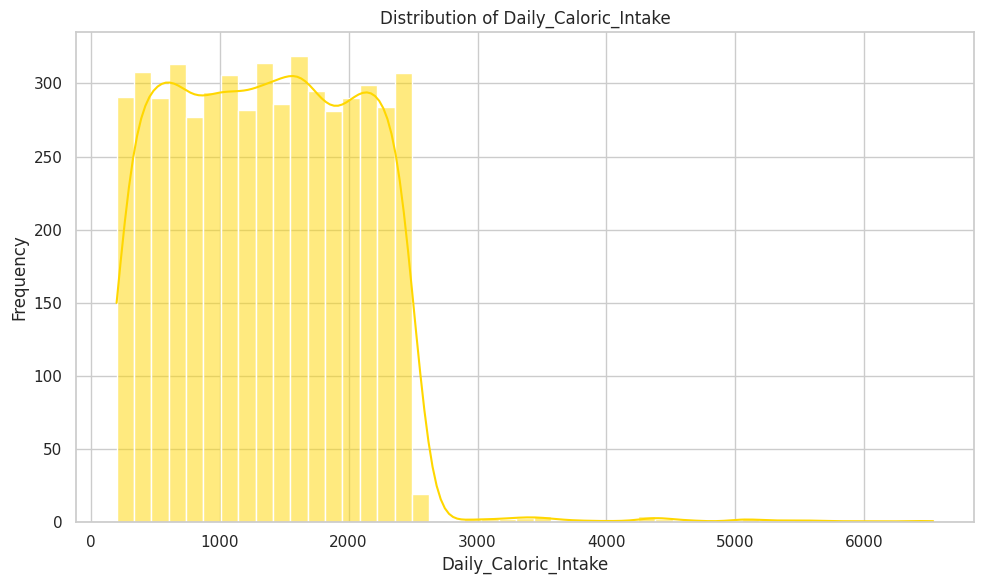

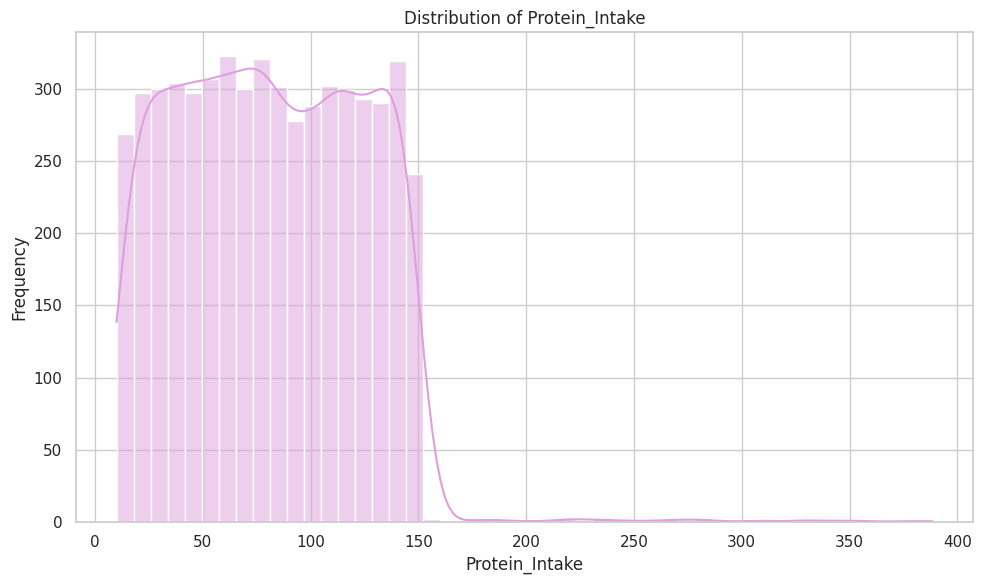

...

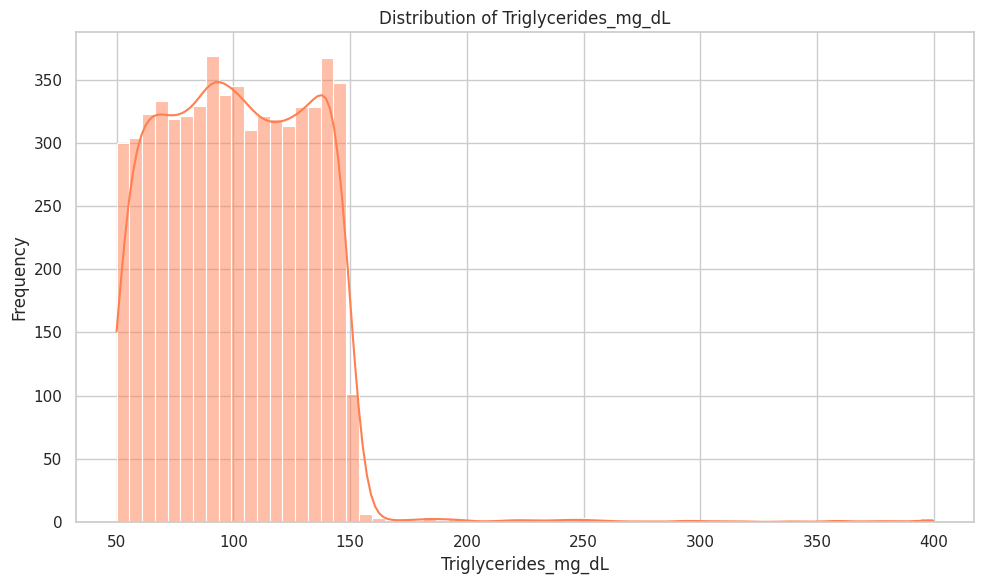

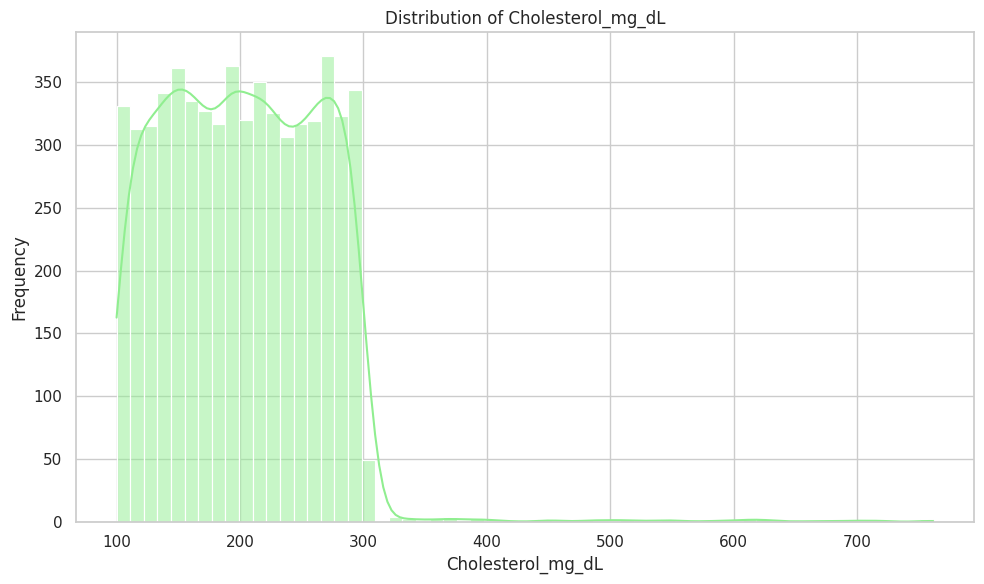

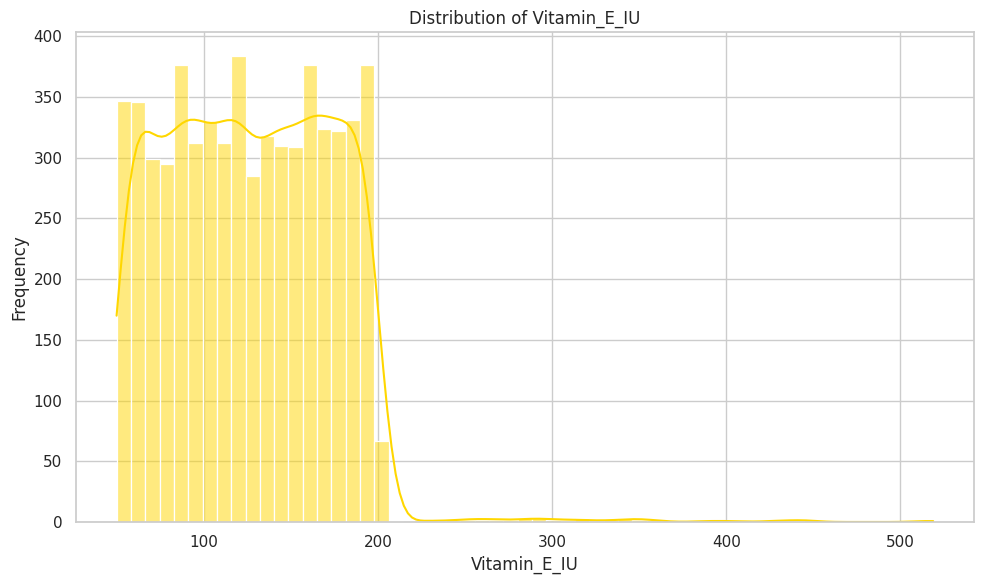

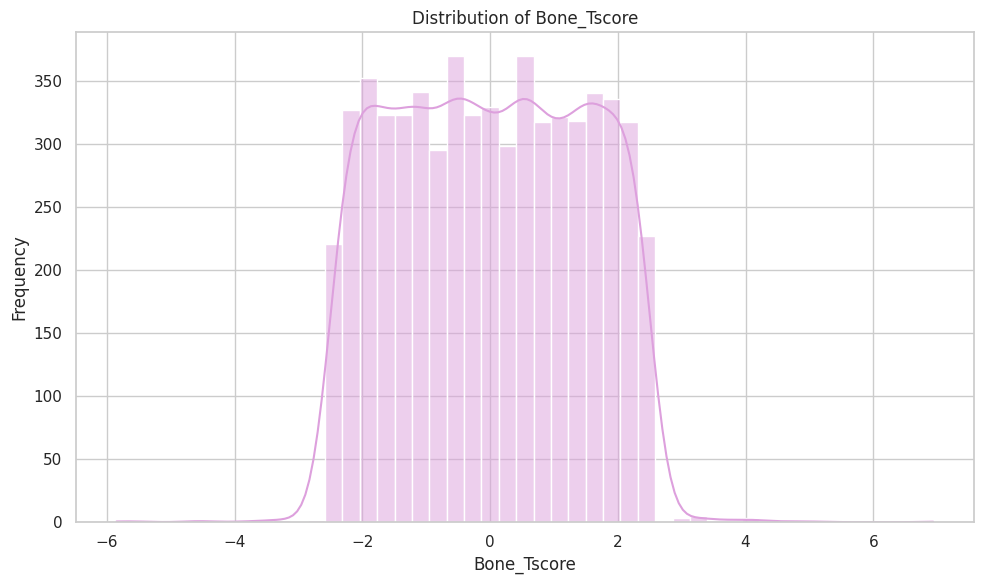

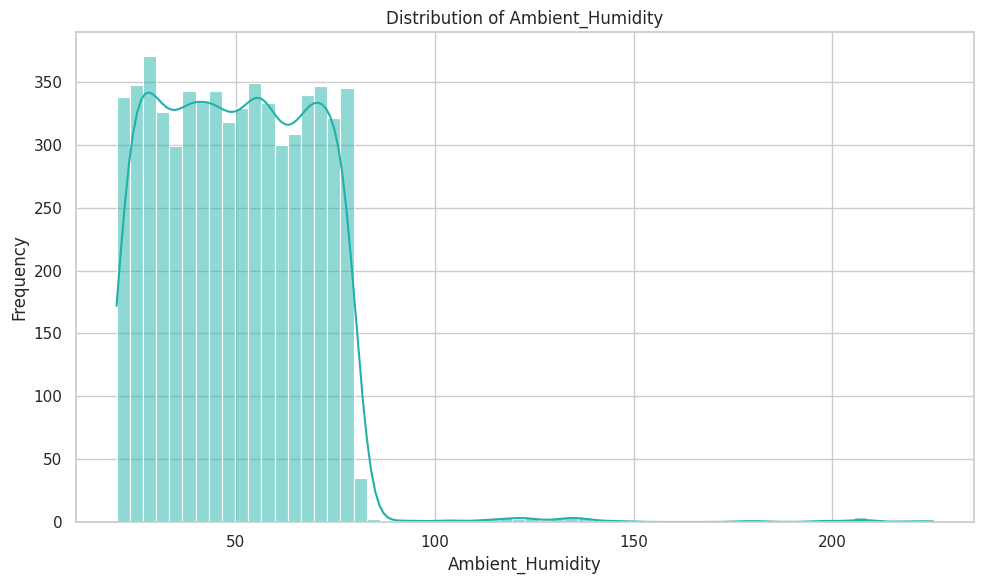

In [ ]:
# 5. Histograms for Numeric Features
print("\nNumeric Feature Distributions:")
colors = ['skyblue', 'coral', 'lightgreen', 'gold', 'plum', 'lightseagreen']
for i, feature in enumerate(numerical_cols[:25]):
    if feature != 'Animal_ID':
        plt.figure(figsize=(10, 6))
        sns.histplot(
            merged_data[feature],
            kde=True,
            color=colors[i % len(colors)]
        )
        plt.title(f'Distribution of {feature}')
        plt.xlabel(feature)
        plt.ylabel('Frequency')
        plt.tight_layout()
        plt.show()

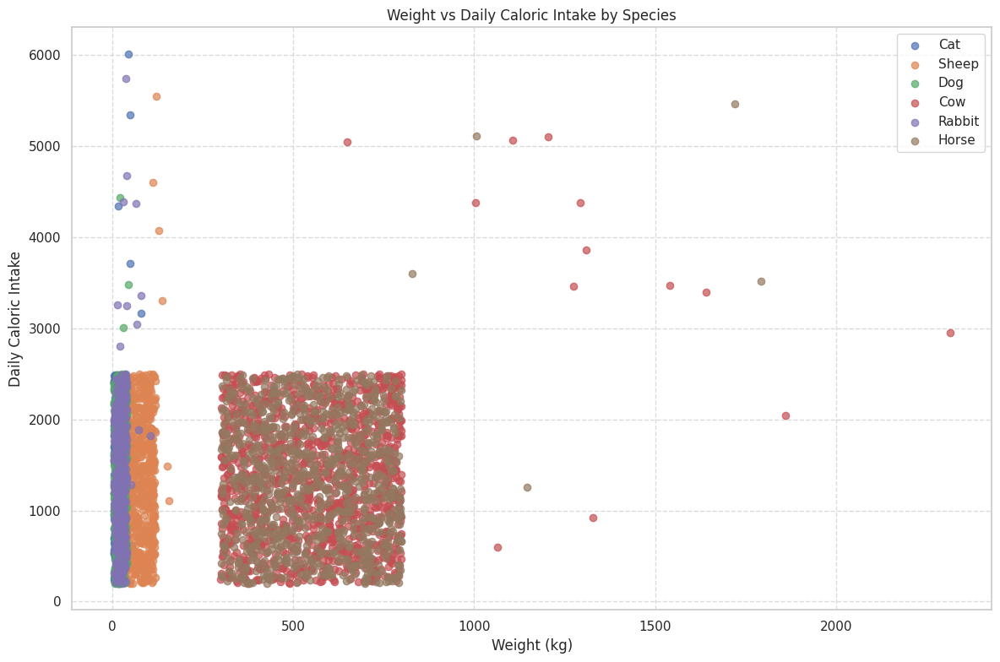

In [ ]:
# Scatter plot: Weight vs Daily Caloric Intake colored by Species
plt.figure(figsize=(12, 8))
for species in merged_data['Species'].unique():
    subset = merged_data[merged_data['Species'] == species]
    plt.scatter(subset['Weight_kg'], subset['Daily_Caloric_Intake'], label=species, alpha=0.7)
plt.title('Weight vs Daily Caloric Intake by Species')
plt.xlabel('Weight (kg)')
plt.ylabel('Daily Caloric Intake')
plt.legend()
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.savefig('weight_vs_caloric_intake.png')
plt.show()
plt.close()


Groubed Bar Chart Analysis:


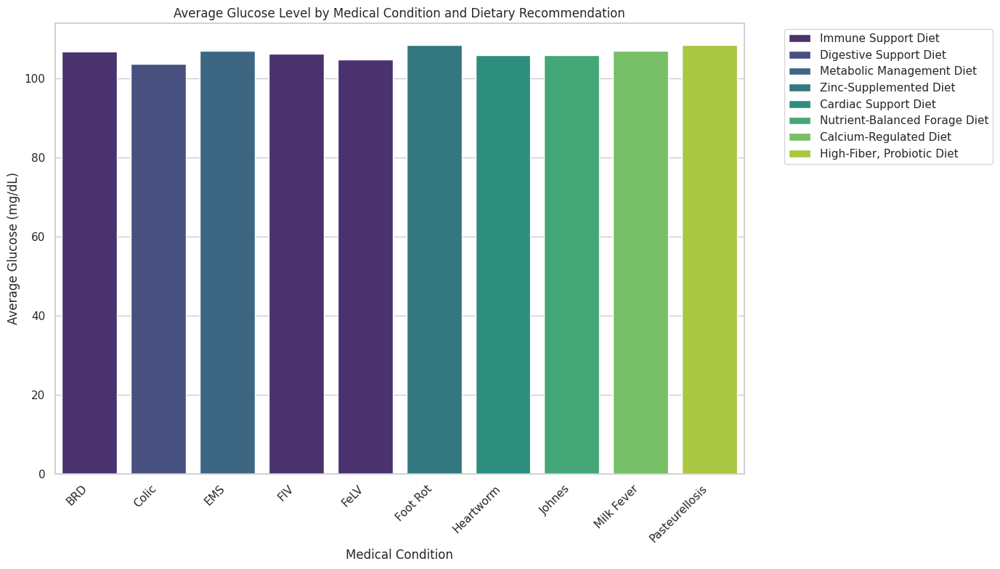

In [ ]:
# 7. Grouped Bar Chart
print("\nGroubed Bar Chart Analysis:")
grouped_data = merged_data.groupby(['Medical_Condition', 'Dietary_Recommendations'])['Glucose_mg_dL'].mean().reset_index()
plt.figure(figsize=(14, 8))
sns.barplot(
    x='Medical_Condition',
    y='Glucose_mg_dL',
    hue='Dietary_Recommendations',
    data=grouped_data,
    palette='viridis'
)
plt.title('Average Glucose Level by Medical Condition and Dietary Recommendation')
plt.xlabel('Medical Condition')
plt.ylabel('Average Glucose (mg/dL)')
plt.xticks(rotation=45, ha='right')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


3D Scatter Plot with PCA:


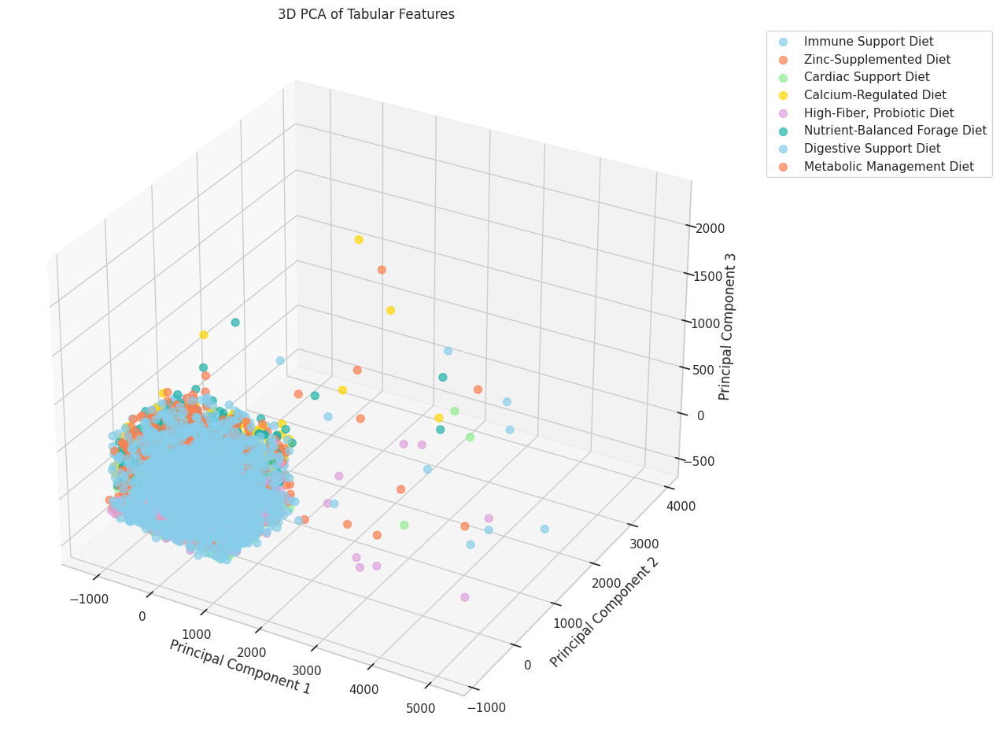

Explained variance by PCA components: [0.54469595 0.22798678 0.09908007]
Total explained variance: 0.87


In [ ]:
## 8. 3D Scatter Plot with PCA
print("\n3D Scatter Plot with PCA:")

# Select numeric features for PCA
pca_features = merged_data.select_dtypes(include=['int64', 'float64']).columns.tolist()
if 'Animal_ID' in pca_features:
    pca_features.remove('Animal_ID')
if 'Dietary_Recommendations' in pca_features:
    pca_features.remove('Dietary_Recommendations')

# *** Impute missing values before applying PCA ***
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy='mean')
merged_data[pca_features] = imputer.fit_transform(merged_data[pca_features])
from sklearn.decomposition import PCA
# Apply PCA
pca = PCA(n_components=3)
pca_result = pca.fit_transform(merged_data[pca_features])
pca_df = pd.DataFrame(
    data=pca_result,
    columns=['PC1', 'PC2', 'PC3']
)
pca_df['Dietary_Recommendations'] = merged_data['Dietary_Recommendations']

# Create 3D scatter plot
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

# Get unique dietary recommendations for coloring
unique_recommendations = pca_df['Dietary_Recommendations'].unique()
for i, recommendation in enumerate(unique_recommendations):
    indices = pca_df['Dietary_Recommendations'] == recommendation
    ax.scatter(
        pca_df.loc[indices, 'PC1'],
        pca_df.loc[indices, 'PC2'],
        pca_df.loc[indices, 'PC3'],
        label=recommendation,
        alpha=0.7,
        s=50,
        c=[colors[i % len(colors)]]
    )

ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')
ax.set_title('3D PCA of Tabular Features')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

print(f"Explained variance by PCA components: {pca.explained_variance_ratio_}")
print(f"Total explained variance: {sum(pca.explained_variance_ratio_):.2f}")


Text Data Dimensionality Reduction:
Running t-SNE...


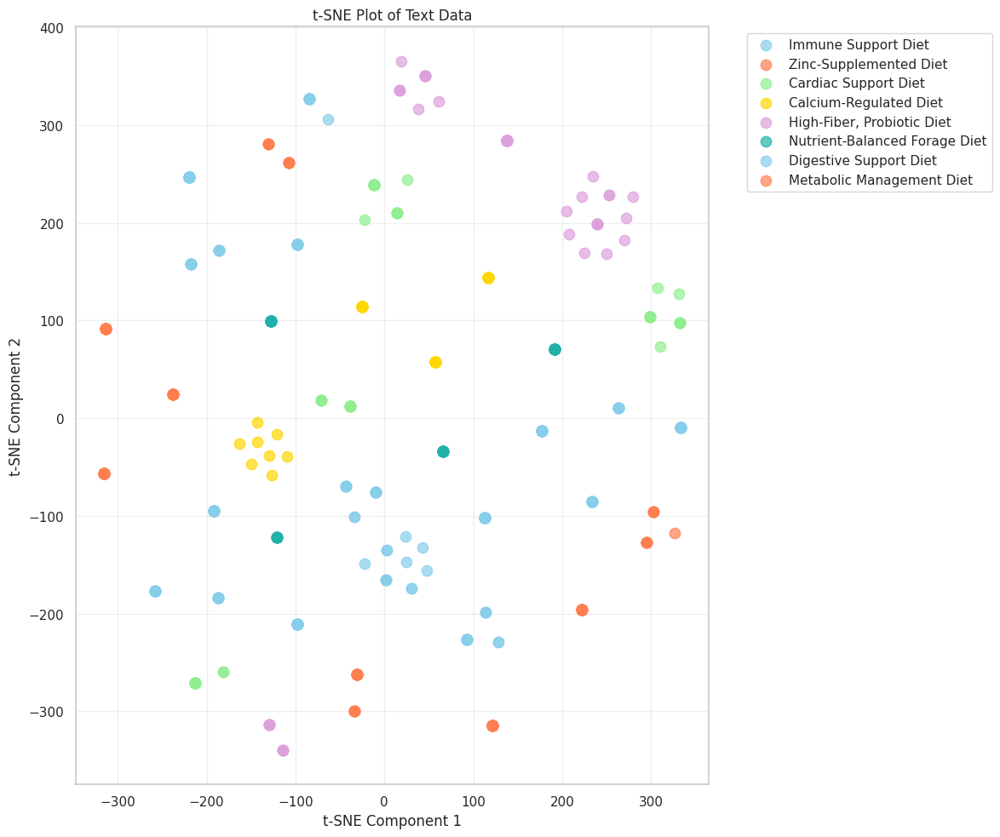

Running UMAP...


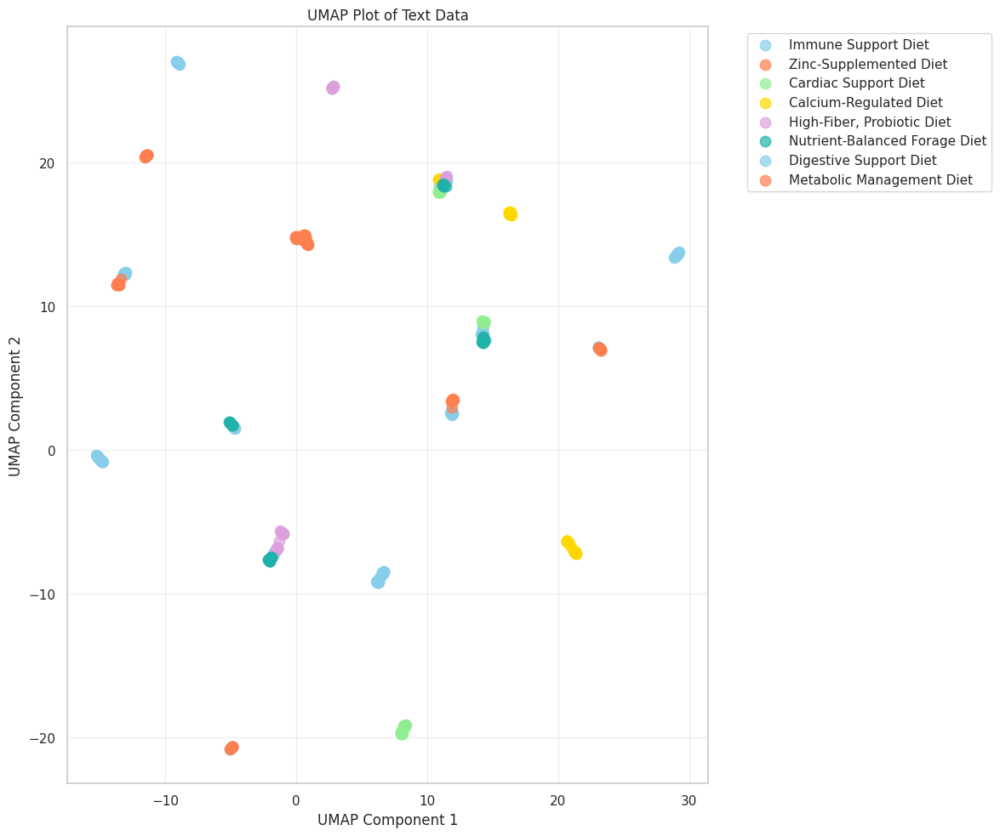

In [ ]:
# 10. TSNE/UMAP Visualization for Text Data
print("\nText Data Dimensionality Reduction:")
# TSNE for text data
print("Running t-SNE...")
tsne = TSNE(n_components=2, random_state=42, perplexity=30)

tsne_result = tsne.fit_transform(tfidf_notes_df[:500])
tsne_df = pd.DataFrame(data=tsne_result, columns=['TSNE1', 'TSNE2'])
tsne_df['Dietary_Recommendations'] = processed_df['Dietary_Recommendations'].iloc[:500].values

plt.figure(figsize=(12, 10))
unique_recommendations = tsne_df['Dietary_Recommendations'].unique()
for i, recommendation in enumerate(unique_recommendations):
    indices = tsne_df['Dietary_Recommendations'] == recommendation
    plt.scatter(
        tsne_df.loc[indices, 'TSNE1'],
        tsne_df.loc[indices, 'TSNE2'],
        label=recommendation,
        alpha=0.7,
        s=80,
        c=[colors[i % len(colors)]]
    )
plt.title('t-SNE Plot of Text Data')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# UMAP for text data
print("Running UMAP...")
umap_reducer = umap.UMAP(random_state=42)
umap_result = umap_reducer.fit_transform(tfidf_notes_df[:500])
umap_df = pd.DataFrame(data=umap_result, columns=['UMAP1', 'UMAP2'])
umap_df['Dietary_Recommendations'] = processed_df['Dietary_Recommendations'].iloc[:500].values

plt.figure(figsize=(12, 10))
for i, recommendation in enumerate(unique_recommendations):
    indices = umap_df['Dietary_Recommendations'] == recommendation
    plt.scatter(
        umap_df.loc[indices, 'UMAP1'],
        umap_df.loc[indices, 'UMAP2'],
        label=recommendation,
        alpha=0.7,
        s=80,
        c=[colors[i % len(colors)]]
    )
plt.title('UMAP Plot of Text Data')
plt.xlabel('UMAP Component 1')
plt.ylabel('UMAP Component 2')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()


Class Proportions:


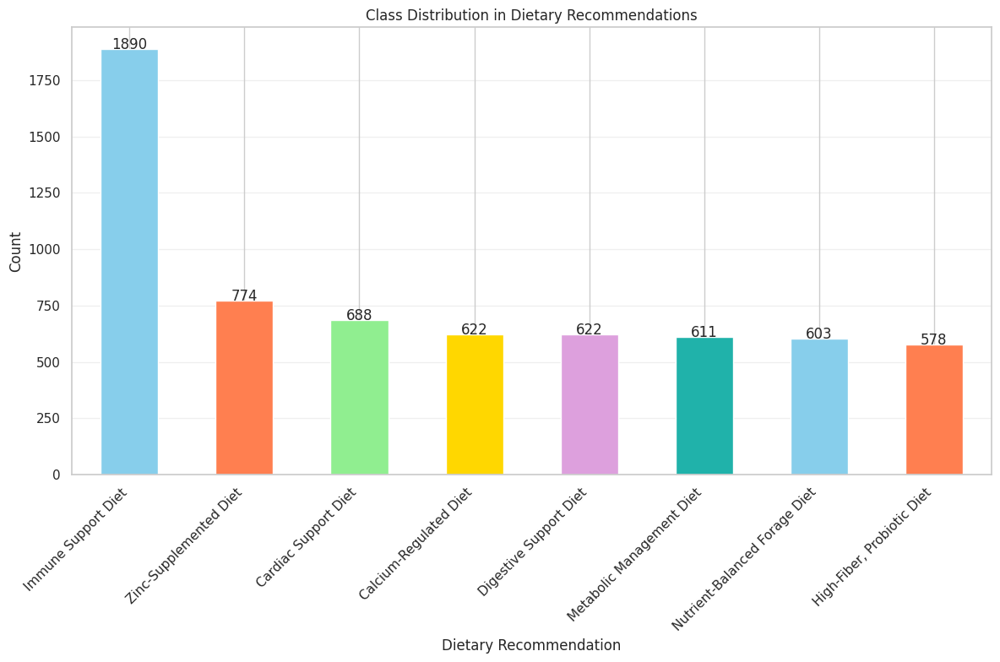

In [ ]:
# 11. Class Proportions Plot
print("\nClass Proportions:")
class_counts = processed_df['Dietary_Recommendations'].value_counts()
plt.figure(figsize=(12, 8))
class_counts.plot(kind='bar', color=colors)
plt.title('Class Distribution in Dietary Recommendations')
plt.xlabel('Dietary Recommendation')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', alpha=0.3)
for i, v in enumerate(class_counts):
    plt.text(i, v + 0.1, str(v), ha='center')
plt.tight_layout()
plt.show()


Hierarchical Clustering:


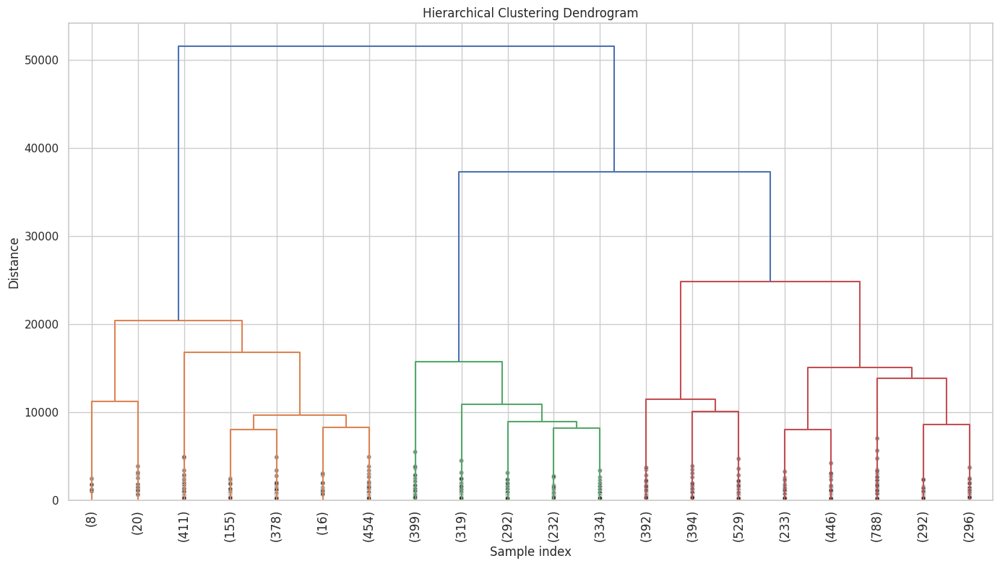

In [ ]:
from scipy.cluster.hierarchy import linkage, dendrogram
# 12. Dendrogram for Hierarchical Clustering
print("\nHierarchical Clustering:")
# Select numerical features for clustering
cluster_features = merged_data.select_dtypes(include=['int64', 'float64']).columns.tolist()
if 'Animal_ID' in cluster_features:
    cluster_features.remove('Animal_ID')

# Calculate linkage matrix
Z = linkage(merged_data[cluster_features], method='ward')

# Plot dendrogram
plt.figure(figsize=(14, 8))
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample index')
plt.ylabel('Distance')
dendrogram(
    Z,
    truncate_mode='lastp',
    p=20,
    leaf_rotation=90.,
    leaf_font_size=12.,
    show_contracted=True
)
plt.tight_layout()
plt.show()

In [ ]:
import umap
from sklearn.manifold import TSNE
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
import math
from sklearn.metrics import silhouette_score
from sklearn.metrics import silhouette_samples
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.model_selection import train_test_split
def perform_eda_advanced(df):
    # 11. 3D Scatter Plot: Age, Weight, and Daily Caloric Intake
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(df['Age'], df['Weight_kg'], df['Daily_Caloric_Intake'],
               c=pd.factorize(df['Dietary_Recommendations'])[0], cmap='tab10', s=50, alpha=0.7)
    ax.set_xlabel('Age')
    ax.set_ylabel('Weight (kg)')
    ax.set_zlabel('Daily Caloric Intake')
    ax.set_title('3D Scatter Plot of Age, Weight and Daily Caloric Intake')
    plt.tight_layout()
    plt.savefig('age_weight_caloric_intake.png')
    plt.show()
    plt.close()


    features_to_scale = numerical_cols
    # Create a scaler and fit_transform the selected features
    scaler = StandardScaler()
    scaled_features = scaler.fit_transform(df[features_to_scale])
    # 14. Silhouette Plot for 3 clusters
    from sklearn.cluster import KMeans
    kmeans = KMeans(n_clusters=3, random_state=42)
    cluster_labels = kmeans.fit_predict(scaled_features)
    silhouette_vals = silhouette_samples(scaled_features, cluster_labels)
    silhouette_avg = silhouette_score(scaled_features, cluster_labels)
    plt.figure(figsize=(10, 6))
    y_lower = 10
    for i in range(3):
        ith_cluster_silhouette_values = silhouette_vals[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        plt.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values)
        y_lower = y_upper + 10
    plt.axvline(x=silhouette_avg, color="red", linestyle="--")
    plt.title("Silhouette Plot for 3 Clusters")
    plt.tight_layout()
    plt.savefig('silhouette_plot.png')
    plt.show()
    plt.close()


    # 16. Multi-Class Precision-Recall Plot
    X = scaled_features
    y = pd.factorize(df['Dietary_Recommendations'])[0]
    X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, random_state=42)
    clf = LogisticRegression(max_iter=1000)
    clf.fit(X_train, y_train)
    y_score = clf.predict_proba(X_test)
    n_classes = y_score.shape[1]
    plt.figure(figsize=(10, 6))
    for i in range(n_classes):
        precision, recall, _ = precision_recall_curve(y_test == i, y_score[:, i])
        ap = average_precision_score(y_test == i, y_score[:, i])
        plt.plot(recall, precision, lw=2, label=f'Class {i} (AP={ap:.2f})')
    plt.xlabel("Recall")
    plt.ylabel("Precision")
    plt.title("Multi-Class Precision-Recall Curve")
    plt.legend(loc='best')
    plt.tight_layout()
    plt.savefig('precision_recall_plot.png')
    plt.show()
    plt.close()


perform_eda_advanced(merged_data)

**3. Feature Engineering & Selection**

===== Starting Feature Engineering & Selection =====
Original DataFrame shape: (6388, 29)
Feature DataFrame shape (after dropping target and Animal_ID): (6388, 29)

Identified text features: []
Identified tabular features: ['Age', 'Weight_kg', 'BMI', 'Daily_Caloric_Intake', 'Protein_Intake', 'Fat_Intake', 'Carbohydrate_Intake', 'Water_Intake', 'Metabolic_Rate', 'Heart_Rate', 'Respiratory_Rate', 'CRP_mg_L', 'Leptin_ng_mL', 'Ghrelin_pg_mL', 'Insulin_uU_mL', 'Glucose_mg_dL', 'Insulin_Resistance', 'Cortisol_ug_dL', 'Albumin_g_dL', 'Triglycerides_mg_dL', 'Cholesterol_mg_dL', 'Vitamin_E_IU', 'Bone_Tscore', 'Ambient_Humidity', 'Gender_Male', 'Medical_Condition_FIV', 'Medical_Condition_FeLV', 'Medical_Condition_Johnes', 'Medical_Condition_Milk Fever']

----- Tabular Feature Selection -----
Top tabular features by mutual information:
                         Feature     Score
1                      Weight_kg  0.694629
27      Medical_Condition_Johnes  0.323866
28  Medical_Condition_Milk Fever  

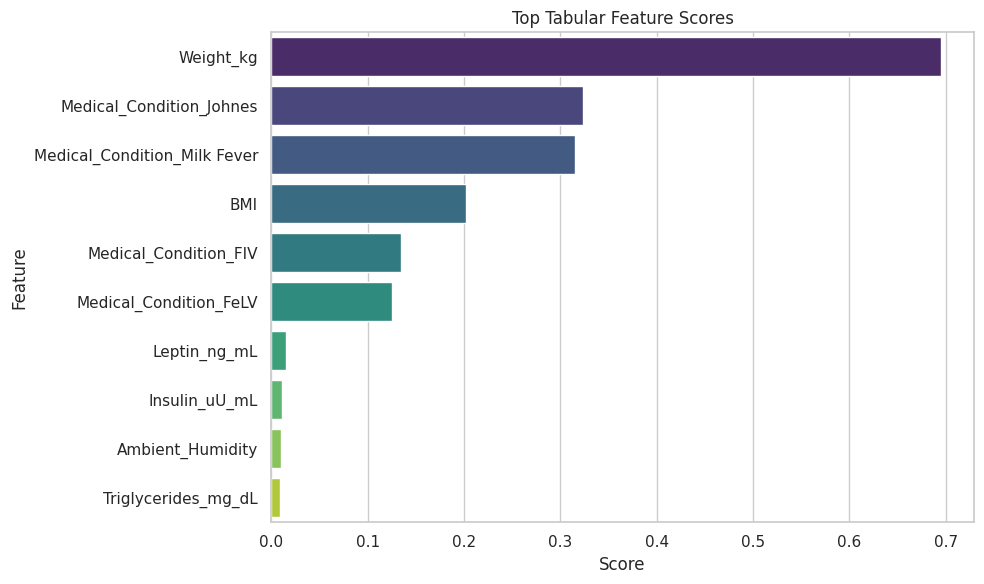

Selected tabular features: ['Weight_kg', 'Medical_Condition_Johnes', 'Medical_Condition_Milk Fever', 'BMI', 'Medical_Condition_FIV', 'Medical_Condition_FeLV', 'Leptin_ng_mL', 'Insulin_uU_mL', 'Ambient_Humidity', 'Triglycerides_mg_dL', 'Respiratory_Rate', 'Gender_Male', 'Water_Intake', 'Carbohydrate_Intake']

----- Text Feature Selection -----
Selected text features: []

Selected 14 features out of 29.
Selected features: ['Weight_kg', 'Medical_Condition_Johnes', 'Medical_Condition_Milk Fever', 'BMI', 'Medical_Condition_FIV', 'Medical_Condition_FeLV', 'Leptin_ng_mL', 'Insulin_uU_mL', 'Ambient_Humidity', 'Triglycerides_mg_dL', 'Respiratory_Rate', 'Gender_Male', 'Water_Intake', 'Carbohydrate_Intake']


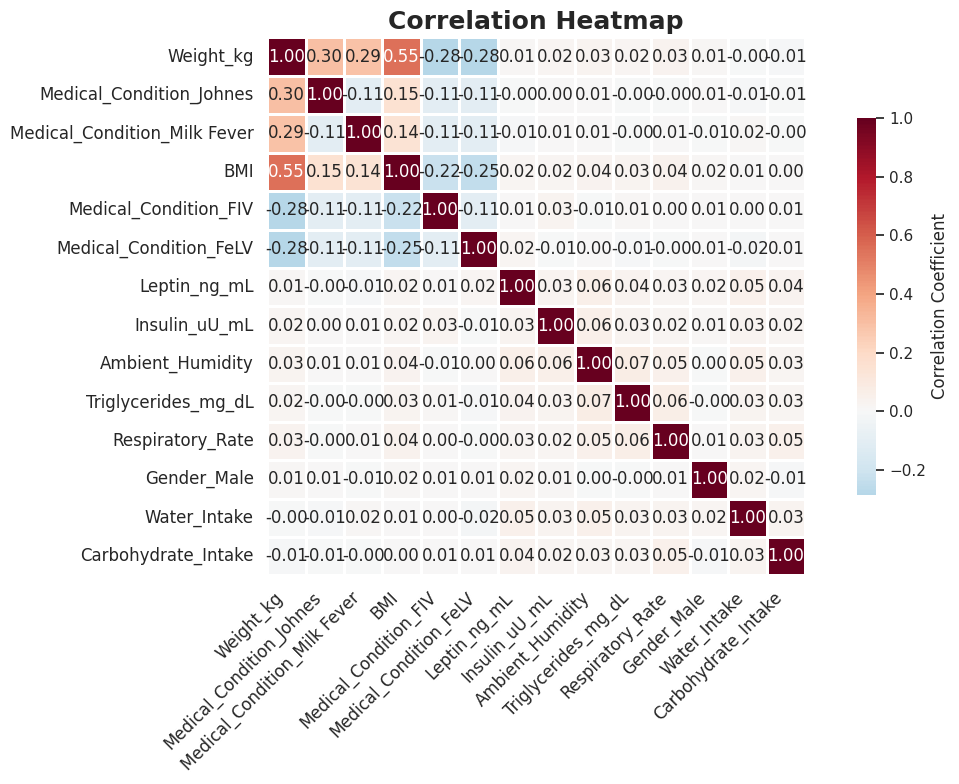

===== Feature Engineering & Selection Completed =====


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_selection import SelectKBest, mutual_info_classif

sns.set(style="whitegrid")
plt.rcParams["figure.figsize"] = (10, 6)

def feature_engineering_selection(df, target_col='Dietary_Recommendations'):
    print("===== Starting Feature Engineering & Selection =====")

    # Create a copy to avoid modifying original
    df_copy = df.copy()
    print("Original DataFrame shape:", df_copy.shape)

    # Extract target variable and features
    y = merged_data[target_col]
    X = df_copy.drop([target_col, 'Animal_ID'], axis=1, errors='ignore')
    print("Feature DataFrame shape (after dropping target and Animal_ID):", X.shape)

    # Separate text-based features from tabular features
    text_features = [col for col in X.columns if 'tfidf' in col or 'svd' in col]
    tabular_features = [col for col in X.columns if col not in text_features
                        and 'processed_' not in col
                        and col not in ['Veterinary_Notes', 'Prescription']]
    print("\nIdentified text features:", text_features)
    print("Identified tabular features:", tabular_features)

    # ----- Tabular Feature Selection -----
    print("\n----- Tabular Feature Selection -----")
    if tabular_features:
        selector = SelectKBest(mutual_info_classif, k=min(10, len(tabular_features)))
        X_tabular = X[tabular_features].fillna(0)
        selector.fit(X_tabular, y)

        # Get selected feature scores
        feature_scores = pd.DataFrame({
            'Feature': tabular_features,
            'Score': selector.scores_
        })

        # Sort features by importance
        feature_scores = feature_scores.sort_values('Score', ascending=False)
        print("Top tabular features by mutual information:")
        print(feature_scores.head(10))

        # Visualize the scores
        plt.figure()
        sns.barplot(x='Score', y='Feature', data=feature_scores.head(10), palette='viridis')
        plt.title("Top Tabular Feature Scores")
        plt.tight_layout()
        plt.show()

        # Select top features (choosing at least 5 or half the features)
        k = max(5, len(tabular_features) // 2)
        selected_tabular_features = feature_scores.head(k)['Feature'].tolist()
    else:
        selected_tabular_features = []
    print("Selected tabular features:", selected_tabular_features)

    # ----- Text Feature Selection -----
    print("\n----- Text Feature Selection -----")
    if text_features:
        selector_text = SelectKBest(mutual_info_classif, k=min(20, len(text_features)))
        X_text = X[text_features].fillna(0)
        selector_text.fit(X_text, y)

        # Get selected feature scores for text features
        text_feature_scores = pd.DataFrame({
            'Feature': text_features,
            'Score': selector_text.scores_
        })

        # Sort features by importance
        text_feature_scores = text_feature_scores.sort_values('Score', ascending=False)
        print("Top text features by mutual information:")
        print(text_feature_scores.head(10))

        # Visualize text feature scores
        plt.figure()
        sns.barplot(x='Score', y='Feature', data=text_feature_scores.head(10), palette='magma')
        plt.title("Top Text Feature Scores")
        plt.tight_layout()
        plt.show()

        # Select top features (choosing at least 10 or one third of features)
        k_text = max(10, len(text_features) // 3)
        selected_text_features = text_feature_scores.head(k_text)['Feature'].tolist()
    else:
        selected_text_features = []
    print("Selected text features:", selected_text_features)

    # ----- Combine Selected Features -----
    selected_features = selected_tabular_features + selected_text_features
    X_selected = X[selected_features]
    print(f"\nSelected {len(selected_features)} features out of {X.shape[1]}.")
    print("Selected features:", selected_features)

    # Visualize correlation of selected features
    if len(selected_features) > 1:

        corre_matrix = X_selected.corr()
        plt.figure(figsize=(12, 8))
        sns.heatmap(
        corre_matrix,
        cmap='RdBu_r',
        center=0,
        annot=True,
        fmt=".2f",
        square=True,
        linewidths=1,
        linecolor='white',
        cbar_kws={"shrink": 0.7, 'label': 'Correlation Coefficient'}
    )

        # Styling for better readability
        plt.title('Correlation Heatmap', fontsize=18, weight='bold')
        plt.xticks(rotation=45, ha='right', fontsize=12)
        plt.yticks(rotation=0, fontsize=12)
        plt.tight_layout()
        plt.show()

    print("===== Feature Engineering & Selection Completed =====")
    return X_selected, y, selected_features


processed_df = processed_df.copy()
# Apply feature engineering and selection
X_selected, y, selected_features = feature_engineering_selection(processed_df)


**4. Multi-Modal Integration**

===== Starting Multi-Modal Integration =====
Generating embeddings for Veterinary_Notes...
Veterinary_Notes Embeddings shape: (6388, 10)
Sample Veterinary_Notes embeddings:
   vet_notes_emb_0  vet_notes_emb_1  vet_notes_emb_2  vet_notes_emb_3  \
0              1.0              6.0              5.0              7.0   
1              1.0              6.0              5.0              7.0   
2              1.0              6.0              5.0              7.0   
3              1.0              6.0              5.0              7.0   
4              1.0              6.0              5.0              2.0   

   vet_notes_emb_4  vet_notes_emb_5  vet_notes_emb_6  vet_notes_emb_7  \
0              2.0              9.0              6.0              0.0   
1              2.0              9.0              6.0              1.0   
2              6.0              1.0              3.0              7.0   
3              2.0              9.0              6.0              1.0   
4              9.0     

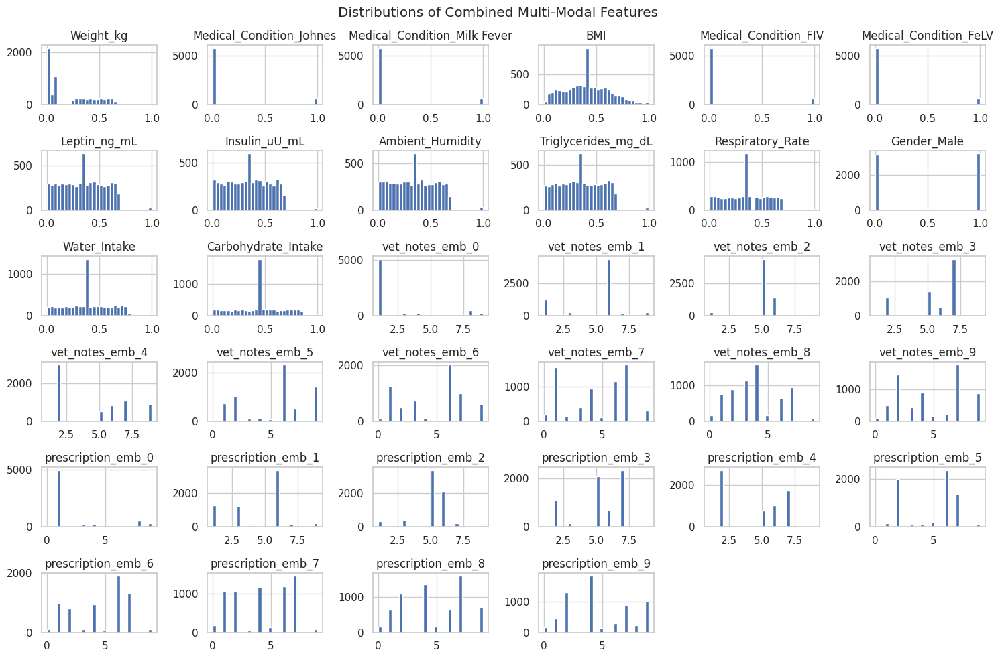

===== Multi-Modal Integration Completed =====

Final integrated feature set shape: (6388, 34)


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import torch
from sklearn.preprocessing import StandardScaler

def integrate_multimodal_features(tabular_df, text_df, selected_features):
    """
    Integrate tabular and text features into a unified dataset.
    """
    print("===== Starting Multi-Modal Integration =====")

    # Function to simulate text embeddings
    def get_text_embeddings(text_series, embedding_size=10):
        embeddings = np.zeros((len(text_series), embedding_size))
        for i, text in enumerate(text_series):
            if pd.isna(text) or text == '':
                continue
            # Created a simple embedding based on character counts (mod 10 for variety)
            chars = list(set(text.lower()))
            for j, char in enumerate(chars):
                if j < embedding_size:
                    embeddings[i, j] = ord(char) % 10
        return embeddings

    # Get text embeddings for Veterinary_Notes
    if 'Veterinary_Notes' in text_df.columns:
        print("Generating embeddings for Veterinary_Notes...")
        vet_notes_embeddings = get_text_embeddings(text_df['Veterinary_Notes'], 10)
        print("Veterinary_Notes Embeddings shape:", vet_notes_embeddings.shape)
        vet_notes_df = pd.DataFrame(
            vet_notes_embeddings,
            columns=[f'vet_notes_emb_{i}' for i in range(vet_notes_embeddings.shape[1])]
        )
        print("Sample Veterinary_Notes embeddings:")
        print(vet_notes_df.head())
    else:
        vet_notes_df = pd.DataFrame()

    # Get text embeddings for Prescription
    if 'Prescription' in text_df.columns:
        print("\nGenerating embeddings for Prescription...")
        prescription_embeddings = get_text_embeddings(text_df['Prescription'], 10)
        print("Prescription Embeddings shape:", prescription_embeddings.shape)
        prescription_df = pd.DataFrame(
            prescription_embeddings,
            columns=[f'prescription_emb_{i}' for i in range(prescription_embeddings.shape[1])]
        )
        print("Sample Prescription embeddings:")
        print(prescription_df.head())
    else:
        prescription_df = pd.DataFrame()

    # Extract selected tabular features (exclude text-based features)
    tabular_features = [f for f in selected_features if not (f.startswith('notes_') or f.startswith('prescription_'))]
    print("\nSelected tabular features:", tabular_features)
    selected_tabular = tabular_df[tabular_features].copy()
    print("Shape of selected tabular features:", selected_tabular.shape)
    print("Sample of selected tabular features:")
    print(selected_tabular.head())

    # Reset index for proper concatenation
    selected_tabular.reset_index(drop=True, inplace=True)
    vet_notes_df.reset_index(drop=True, inplace=True)
    prescription_df.reset_index(drop=True, inplace=True)

    # Combine all features
    combined_features = pd.concat([selected_tabular, vet_notes_df, prescription_df], axis=1)
    print("\nCombined features shape:", combined_features.shape)
    print("Sample of combined features:")
    print(combined_features.head())

    # Handle any missing values
    combined_features.fillna(0, inplace=True)
    print("\nMissing values (if any) have been filled with 0.")

    # Visualize distributions of a few features
    combined_features.hist(bins=30, figsize=(15, 10))
    plt.suptitle("Distributions of Combined Multi-Modal Features")
    plt.tight_layout()
    plt.show()

    print("===== Multi-Modal Integration Completed =====")
    return combined_features

# Apply integration function
multimodal_features = integrate_multimodal_features(
    processed_tabular,
    merged_data[['Animal_ID', 'Veterinary_Notes', 'Prescription']],
    selected_features
)

# Final feature set for modeling
final_X = multimodal_features
print("\nFinal integrated feature set shape:", final_X.shape)


**5. Addressing Class Imbalance**

===== Starting Class Imbalance Handling =====
Original class counts:
Counter({'Immune Support Diet': 1890, 'Zinc-Supplemented Diet': 774, 'Cardiac Support Diet': 688, 'Calcium-Regulated Diet': 622, 'Digestive Support Diet': 622, 'Metabolic Management Diet': 611, 'Nutrient-Balanced Forage Diet': 603, 'High-Fiber, Probiotic Diet': 578})


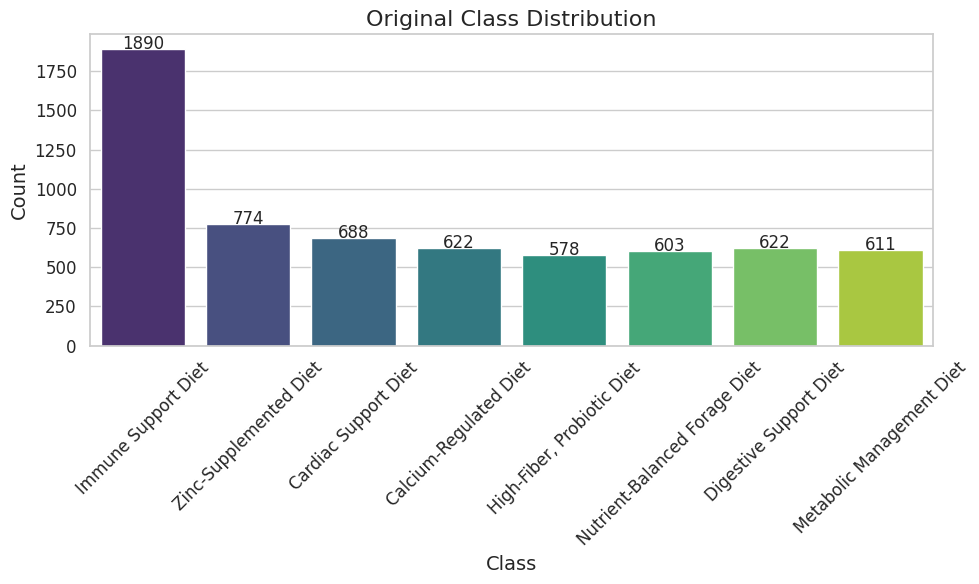

No classes with fewer than 2 samples found. Skipping duplication.


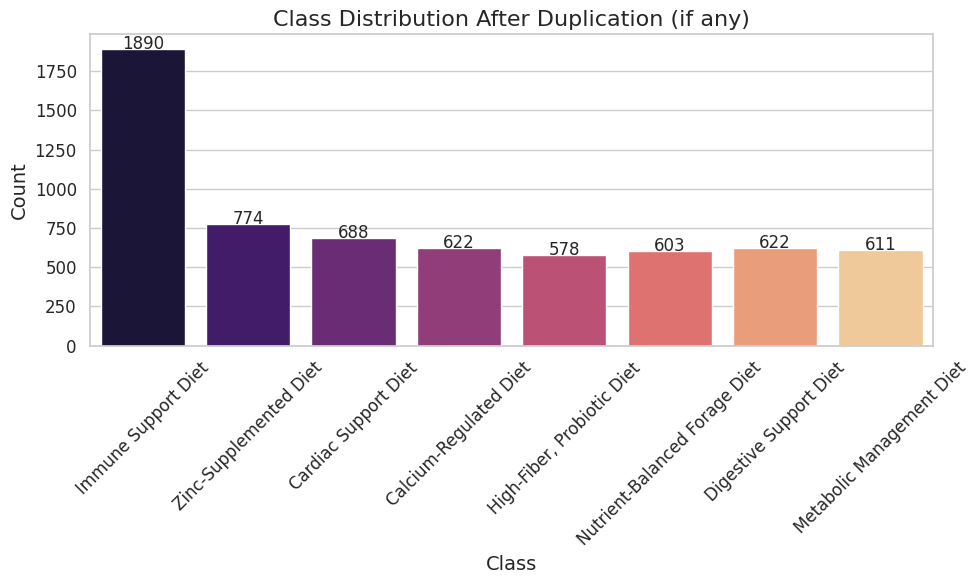

Resampled class distribution after SMOTE:
Dietary_Recommendations
Immune Support Diet              1890
Zinc-Supplemented Diet           1890
Cardiac Support Diet             1890
Calcium-Regulated Diet           1890
High-Fiber, Probiotic Diet       1890
Nutrient-Balanced Forage Diet    1890
Digestive Support Diet           1890
Metabolic Management Diet        1890
Name: count, dtype: int64


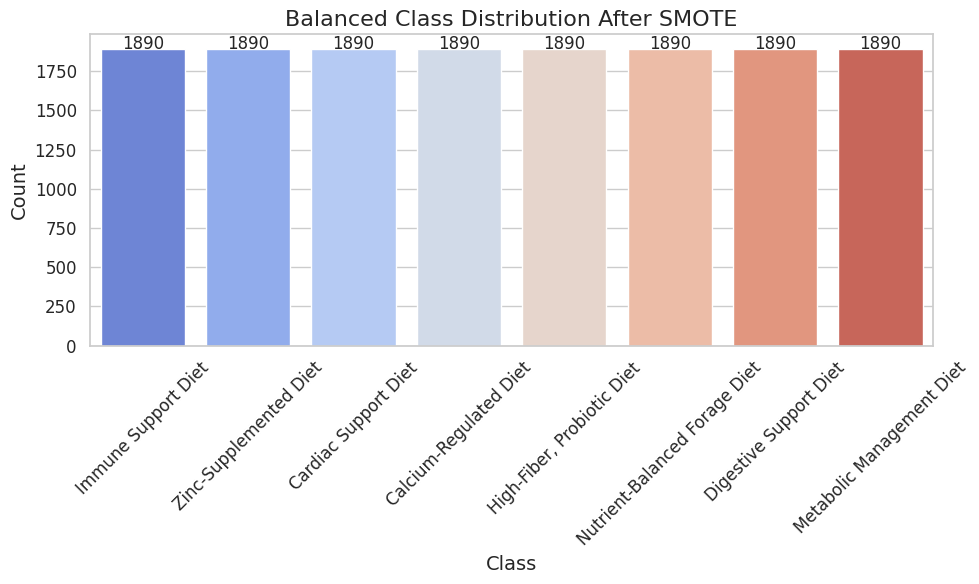

===== Class Imbalance Handling Completed =====


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def handle_class_imbalance(X, y):
    """
    Check and handle class imbalance in the target variable.
    Duplicates samples for classes with fewer than 2 samples and then applies SMOTE.
    Includes clean visualization of class distributions.
    """
    from imblearn.over_sampling import SMOTE
    from collections import Counter

    print("===== Starting Class Imbalance Handling =====")

    # Check the class counts in y
    class_counts = Counter(y)
    print("Original class counts:")
    print(class_counts)

    # Visualize original class distribution
    plt.figure(figsize=(10, 6))
    sns.barplot(x=list(class_counts.keys()), y=list(class_counts.values()), palette='viridis')
    plt.title("Original Class Distribution", fontsize=16)
    plt.xlabel("Class", fontsize=14)
    plt.ylabel("Count", fontsize=14)
    plt.xticks(rotation=45, fontsize=12)
    plt.yticks(fontsize=12)

    # Add bar annotations
    for i, count in enumerate(class_counts.values()):
        plt.text(i, count + 0.1, str(count), ha='center', fontsize=12)

    plt.tight_layout()
    plt.show()

    # Identify classes with fewer than 2 samples
    classes_with_one_sample = [cls for cls, count in class_counts.items() if count < 2]
    if classes_with_one_sample:
        print("Classes with fewer than 2 samples:", classes_with_one_sample)
        # Find indices for these classes and duplicate them
        indices_to_duplicate = []
        for cls in classes_with_one_sample:
            indices = y[y == cls].index.tolist()
            indices_to_duplicate.extend(indices)

        # Duplicate the rows
        X_resampled = pd.concat([X, X.loc[indices_to_duplicate]], axis=0)
        y_resampled = pd.concat([y, y.loc[indices_to_duplicate]], axis=0)
        print("New class counts after duplication:")
        print(Counter(y_resampled))
    else:
        X_resampled = X.copy()
        y_resampled = y.copy()
        print("No classes with fewer than 2 samples found. Skipping duplication.")

    # Visualize class distribution after duplication
    plt.figure(figsize=(10, 6))
    resampled_counts = Counter(y_resampled)
    sns.barplot(x=list(resampled_counts.keys()), y=list(resampled_counts.values()), palette='magma')
    plt.title("Class Distribution After Duplication (if any)", fontsize=16)
    plt.xlabel("Class", fontsize=14)
    plt.ylabel("Count", fontsize=14)
    plt.xticks(rotation=45, fontsize=12)
    plt.yticks(fontsize=12)

    # Add bar annotations
    for i, count in enumerate(resampled_counts.values()):
        plt.text(i, count + 0.1, str(count), ha='center', fontsize=12)

    plt.tight_layout()
    plt.show()

    # Apply SMOTE with k_neighbors=1
    smote = SMOTE(random_state=42, k_neighbors=1)
    X_resampled, y_resampled = smote.fit_resample(X_resampled, y_resampled)

    print("Resampled class distribution after SMOTE:")
    resampled_counts = pd.Series(y_resampled).value_counts()
    print(resampled_counts)

    # Visualize final balanced class distribution
    plt.figure(figsize=(10, 6))
    sns.barplot(x=resampled_counts.index, y=resampled_counts.values, palette='coolwarm')
    plt.title("Balanced Class Distribution After SMOTE", fontsize=16)
    plt.xlabel("Class", fontsize=14)
    plt.ylabel("Count", fontsize=14)
    plt.xticks(rotation=45, fontsize=12)
    plt.yticks(fontsize=12)

    # Add bar annotations
    for i, count in enumerate(resampled_counts.values):
        plt.text(i, count + 0.1, str(count), ha='center', fontsize=12)

    plt.tight_layout()
    plt.show()

    print("===== Class Imbalance Handling Completed =====")
    return X_resampled, y_resampled

X_balanced, y_balanced = handle_class_imbalance(final_X, y)

**6. Model Implementation**

===== Starting Model Implementation =====
Training set shape: (12096, 34), Test set shape: (3024, 34)

----- Model Cross-Validation Results -----

Evaluating Logistic Regression...
CV Scores: [0.71322314 0.71103762 0.72467962 0.72013229 0.71806532]
Mean CV Accuracy: 0.7174 (+/- 0.0049)
Test Accuracy: 0.7007

Evaluating Decision Tree...
CV Scores: [0.84090909 0.84291029 0.83753617 0.84332369 0.8284415 ]
Mean CV Accuracy: 0.8386 (+/- 0.0055)
Test Accuracy: 0.8307

Evaluating Random Forest...
CV Scores: [0.91239669 0.918148   0.9111203  0.91029351 0.8974783 ]
Mean CV Accuracy: 0.9099 (+/- 0.0068)
Test Accuracy: 0.9177

Evaluating Gradient Boosting...
CV Scores: [0.82933884 0.8358826  0.82968169 0.84291029 0.82596114]
Mean CV Accuracy: 0.8328 (+/- 0.0060)
Test Accuracy: 0.8241

Evaluating XGBoost...
CV Scores: [0.90165289 0.90285242 0.89623811 0.89169078 0.89086399]
Mean CV Accuracy: 0.8967 (+/- 0.0049)
Test Accuracy: 0.9018

Evaluating LightGBM...
[LightGBM] [Warning] Found whitespace in 

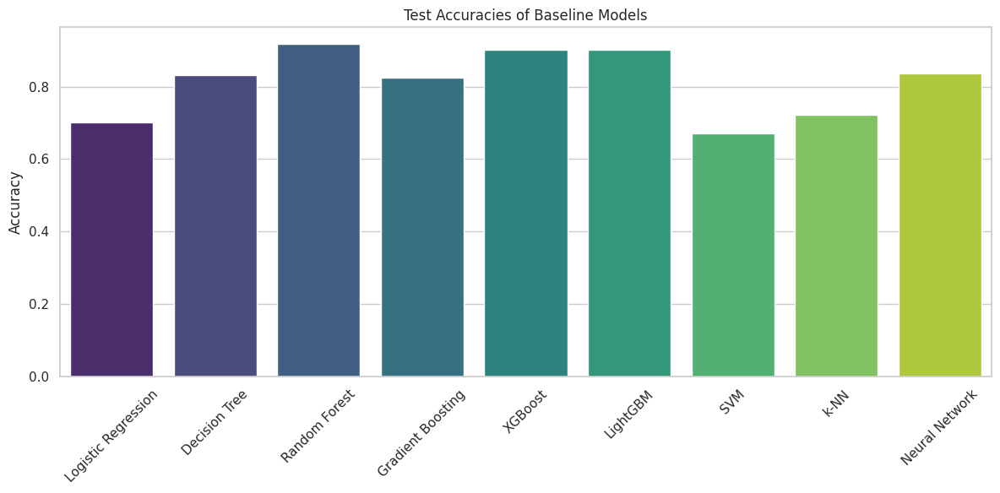

Saved test accuracies plot as 'model_test_accuracies.png'.

Best Model: Random Forest with Test Accuracy: 0.9177

Detailed Report for Best Model:
Classification Report:
                               precision    recall  f1-score   support

       Calcium-Regulated Diet       1.00      1.00      1.00       358
         Cardiac Support Diet       0.97      0.95      0.96       404
       Digestive Support Diet       0.80      0.91      0.85       388
   High-Fiber, Probiotic Diet       0.92      0.95      0.94       362
          Immune Support Diet       0.97      0.65      0.77       353
    Metabolic Management Diet       0.79      0.92      0.85       399
Nutrient-Balanced Forage Diet       1.00      1.00      1.00       367
       Zinc-Supplemented Diet       0.96      0.96      0.96       393

                     accuracy                           0.92      3024
                    macro avg       0.93      0.92      0.92      3024
                 weighted avg       0.92      0.

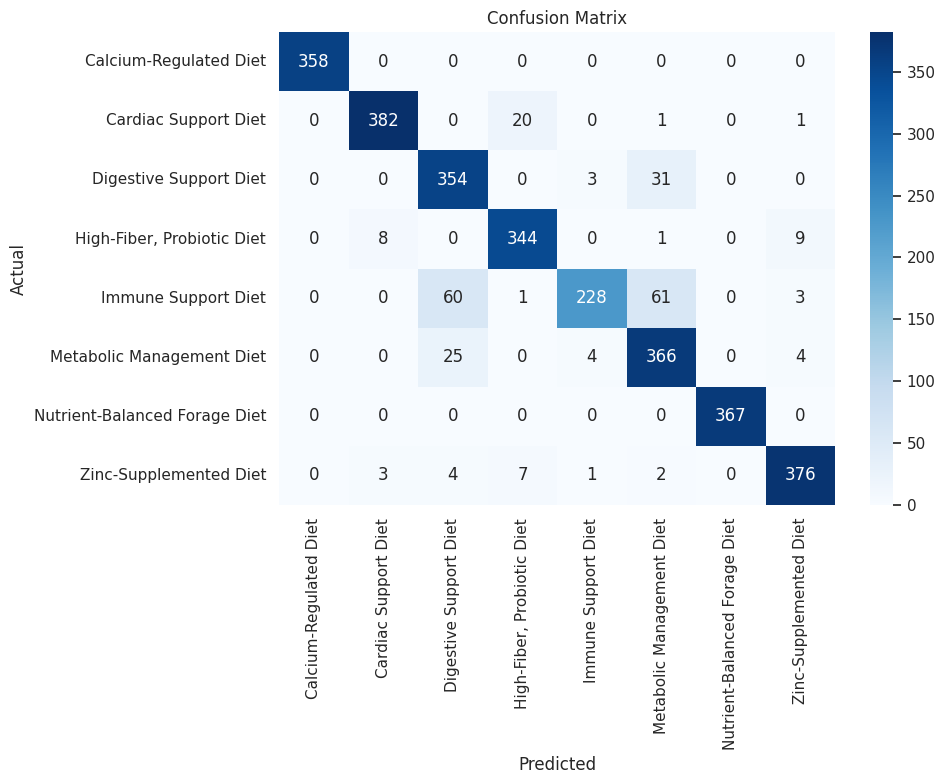

Saved confusion matrix plot as 'confusion_matrix.png'.

Top 3 models for ensemble:
- Random Forest
- XGBoost
- LightGBM
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002317 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 7647
[LightGBM] [Info] Number of data points in the train set: 12096, number of used features: 34
[LightGBM] [Info] Start training from score -2.066301
[LightGBM] [Info] Start training from score -2.096787
[LightGBM] [Info] Start training from score -2.086077
[LightGBM] [Info] Start training from score -2.068915
[LightGBM] [Info] Start training from score -2.063042
[LightGBM] [Info] Start training from score -2.093428
[LightGBM] [Info] Start training from score -2.072193
[LightGBM] [Info] Start training from score -2.089412
[LightGBM] [War

In [ ]:
def implement_models(X, y):
    """
    Implement and compare multiple machine learning models,
    print outputs and visualize results.
    """
    from sklearn.model_selection import train_test_split, cross_val_score
    from sklearn.linear_model import LogisticRegression
    from sklearn.tree import DecisionTreeClassifier
    from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, VotingClassifier, StackingClassifier
    from sklearn.svm import SVC
    from sklearn.neighbors import KNeighborsClassifier
    from sklearn.neural_network import MLPClassifier
    from xgboost import XGBClassifier
    from lightgbm import LGBMClassifier
    from sklearn.preprocessing import LabelEncoder
    from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
    import numpy as np
    import matplotlib.pyplot as plt
    import seaborn as sns

    print("===== Starting Model Implementation =====")

    # Split data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    label_encoder = LabelEncoder()
    y_train = label_encoder.fit_transform(y_train)
    y_test = label_encoder.transform(y_test)
    print(f"Training set shape: {X_train.shape}, Test set shape: {X_test.shape}\n")

    # Define models to evaluate
    models = {
        "Logistic Regression": LogisticRegression(max_iter=1000, multi_class='multinomial'),
        "Decision Tree": DecisionTreeClassifier(),
        "Random Forest": RandomForestClassifier(),
        "Gradient Boosting": GradientBoostingClassifier(),
        "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric='mlogloss'),
        "LightGBM": LGBMClassifier(),
        "SVM": SVC(probability=True),
        "k-NN": KNeighborsClassifier(),
        "Neural Network": MLPClassifier(max_iter=1000)
    }

    results = {}

    print("----- Model Cross-Validation Results -----")
    for name, model in models.items():
        print(f"\nEvaluating {name}...")
        # Perform 5-fold cross-validation
        cv_scores = cross_val_score(model, X_train, y_train, cv=5, scoring='accuracy')
        print(f"CV Scores: {cv_scores}")
        print(f"Mean CV Accuracy: {np.mean(cv_scores):.4f} (+/- {np.std(cv_scores):.4f})")

        # Fit model on full training data
        model.fit(X_train, y_train)

        # Predict on test data
        y_pred = model.predict(X_test)

        # Calculate metrics
        test_accuracy = accuracy_score(y_test, y_pred)
        print(f"Test Accuracy: {test_accuracy:.4f}")

        results[name] = {
            'model': model,
            'cv_accuracy': np.mean(cv_scores),
            'test_accuracy': test_accuracy,
            'predictions': y_pred
        }

    # Plot model test accuracies
    plt.figure(figsize=(12, 6))
    model_names = list(results.keys())
    test_accs = [results[m]['test_accuracy'] for m in model_names]
    sns.barplot(x=model_names, y=test_accs, palette='viridis')
    plt.xticks(rotation=45)
    plt.title("Test Accuracies of Baseline Models")
    plt.ylabel("Accuracy")
    plt.tight_layout()
    plt.savefig('model_test_accuracies.png')
    plt.show()
    print("Saved test accuracies plot as 'model_test_accuracies.png'.")

    # Find the best performing model
    best_model_name = max(results, key=lambda x: results[x]['test_accuracy'])
    best_model = results[best_model_name]['model']
    best_accuracy = results[best_model_name]['test_accuracy']
    print(f"\nBest Model: {best_model_name} with Test Accuracy: {best_accuracy:.4f}")

    # Generate detailed report for the best model
    y_pred_best = results[best_model_name]['predictions']
    print("\nDetailed Report for Best Model:")
    print("Classification Report:")
    print(classification_report(y_test, y_pred_best, target_names=label_encoder.classes_))

    print("Confusion Matrix:")
    cm = confusion_matrix(y_test, y_pred_best)
    print(cm)
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=sorted(set(y)),
                yticklabels=sorted(set(y)))
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Confusion Matrix')
    plt.tight_layout()
    plt.savefig('confusion_matrix.png')
    plt.show()
    print("Saved confusion matrix plot as 'confusion_matrix.png'.")

    # Create ensemble model by combining top 3 models (by test accuracy)
    top_models = sorted(results.items(), key=lambda x: x[1]['test_accuracy'], reverse=True)[:3]
    print("\nTop 3 models for ensemble:")
    for name, _ in top_models:
        print(f"- {name}")

    ensemble = VotingClassifier(
        estimators=[(name, results[name]['model']) for name, _ in top_models],
        voting='soft'
    )
    ensemble.fit(X_train, y_train)
    y_pred_ensemble = ensemble.predict(X_test)
    ensemble_accuracy = accuracy_score(y_test, y_pred_ensemble)
    print(f"\nEnsemble Model Test Accuracy: {ensemble_accuracy:.4f}")

    if ensemble_accuracy > best_accuracy:
        print("Ensemble model outperforms individual models!")
        best_model = ensemble
        best_accuracy = ensemble_accuracy
        y_pred_best = y_pred_ensemble

    print("\n----- Model Implementation Completed -----")
    return best_model, X_test, y_test, y_pred_best, results

# Implement models using balanced data (X_balanced, y_balanced)
best_model, X_test, y_test, y_pred, model_results = implement_models(X_balanced, y_balanced)

**7. Hyperparameter Tuning**

Best model from initial evaluation: Random Forest
===== Starting Hyperparameter Tuning for Random Forest =====
Training set shape: (12096, 34)
Test set shape: (3024, 34)

Performing hyperparameter tuning for Random Forest...
Fitting 5 folds for each of 20 candidates, totalling 100 fits

Best Parameters:
{'n_estimators': 300, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 30}
Best CV Accuracy: 0.9131


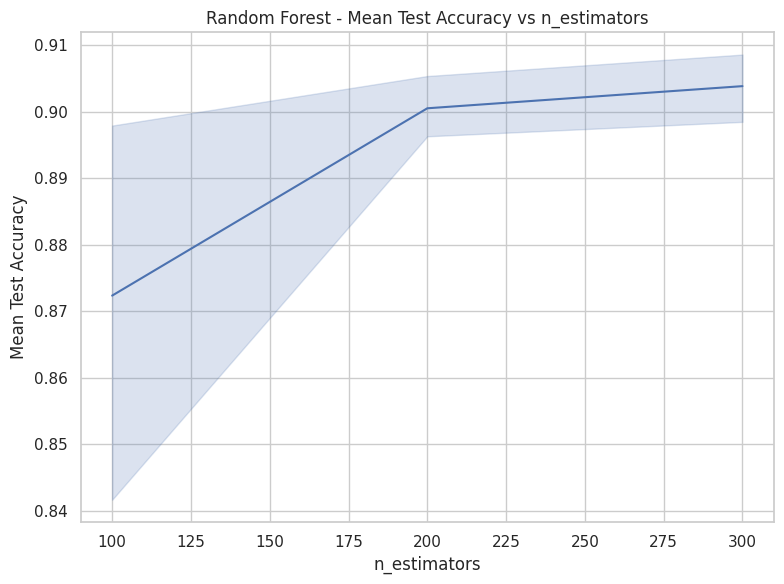

Saved CV scores plot as 'cv_n_estimators_plot.png'.
Test Accuracy with tuned parameters: 0.9190
===== Hyperparameter Tuning Completed =====


In [ ]:
def tune_hyperparameters(best_model_name, X, y):
    """
    Perform hyperparameter tuning for the best model and visualize outputs.
    """
    from sklearn.model_selection import RandomizedSearchCV, GridSearchCV, train_test_split
    from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
    from sklearn.linear_model import LogisticRegression
    from xgboost import XGBClassifier
    from lightgbm import LGBMClassifier
    from sklearn.metrics import accuracy_score
    import matplotlib.pyplot as plt
    import seaborn as sns
    import pandas as pd

    print("===== Starting Hyperparameter Tuning for", best_model_name, "=====")

    # Split data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    print("Training set shape:", X_train.shape)
    print("Test set shape:", X_test.shape)

    # Define parameter grids for different models
    param_grids = {
        'Random Forest': {
            'model': RandomForestClassifier(random_state=42),
            'param_grid': {
                'n_estimators': [100, 200, 300],
                'max_depth': [None, 10, 20, 30],
                'min_samples_split': [2, 5, 10],
                'min_samples_leaf': [1, 2, 4]
            }
        },
        'XGBoost': {
            'model': XGBClassifier(random_state=42),
            'param_grid': {
                'n_estimators': [100, 200, 300],
                'max_depth': [3, 5, 7],
                'learning_rate': [0.01, 0.05, 0.1],
                'subsample': [0.8, 0.9, 1.0],
                'colsample_bytree': [0.8, 0.9, 1.0]
            }
        },
        'LightGBM': {
            'model': LGBMClassifier(random_state=42),
            'param_grid': {
                'n_estimators': [100, 200, 300],
                'max_depth': [3, 5, 7],
                'learning_rate': [0.01, 0.05, 0.1],
                'num_leaves': [31, 50, 70]
            }
        },
        'Gradient Boosting': {
            'model': GradientBoostingClassifier(random_state=42),
            'param_grid': {
                'n_estimators': [100, 200],
                'max_depth': [3, 5],
                'learning_rate': [0.01, 0.1],
                'subsample': [0.8, 1.0]
            }
        },
        'Logistic Regression': {
            'model': LogisticRegression(random_state=42, max_iter=1000),
            'param_grid': {
                'C': [0.1, 1, 10, 100],
                'solver': ['newton-cg', 'lbfgs', 'liblinear'],
                'penalty': ['l2', None]
            }
        }
    }

    if best_model_name not in param_grids:
        print(f"Hyperparameter grid not defined for {best_model_name}. Using default model.")
        return None

    print(f"\nPerforming hyperparameter tuning for {best_model_name}...")
    model = param_grids[best_model_name]['model']
    param_grid = param_grids[best_model_name]['param_grid']

    # Use RandomizedSearchCV for tuning
    random_search = RandomizedSearchCV(
        estimator=model,
        param_distributions=param_grid,
        n_iter=20,
        cv=5,
        verbose=1,
        random_state=42,
        n_jobs=-1
    )

    random_search.fit(X_train, y_train)

    best_params = random_search.best_params_
    best_cv_score = random_search.best_score_
    print("\nBest Parameters:")
    print(best_params)
    print(f"Best CV Accuracy: {best_cv_score:.4f}")

    # Visualize CV scores for different parameter combinations
    cv_results = pd.DataFrame(random_search.cv_results_)
    # Plot mean test score vs n_estimators
    if 'param_n_estimators' in cv_results.columns:
        plt.figure(figsize=(8,6))
        sns.lineplot(x=cv_results['param_n_estimators'].astype(int), y=cv_results['mean_test_score'])
        plt.xlabel('n_estimators')
        plt.ylabel('Mean Test Accuracy')
        plt.title(f'{best_model_name} - Mean Test Accuracy vs n_estimators')
        plt.tight_layout()
        plt.savefig('cv_n_estimators_plot.png')
        plt.show()
        print("Saved CV scores plot as 'cv_n_estimators_plot.png'.")

    best_model = random_search.best_estimator_
    y_pred = best_model.predict(X_test)
    test_accuracy = accuracy_score(y_test, y_pred)
    print(f"Test Accuracy with tuned parameters: {test_accuracy:.4f}")

    print("===== Hyperparameter Tuning Completed =====")
    return best_model, best_params, test_accuracy

best_model_name = max(model_results, key=lambda x: model_results[x]['test_accuracy'])
print("Best model from initial evaluation:", best_model_name)

# Tune hyperparameters for the best model
tuned_model, best_params, tuned_accuracy = tune_hyperparameters(best_model_name, X_balanced, y_balanced)

**8. Model Evaluation**

===== Starting Model Evaluation =====
Training set shape: (12096, 34), Test set shape: (3024, 34)
Model training completed.
Predictions on test set completed. Sample predictions:
['Metabolic Management Diet' 'Cardiac Support Diet'
 'Calcium-Regulated Diet' 'Immune Support Diet'
 'Metabolic Management Diet' 'Calcium-Regulated Diet'
 'Calcium-Regulated Diet' 'Nutrient-Balanced Forage Diet'
 'Nutrient-Balanced Forage Diet' 'Cardiac Support Diet']
Predicted probabilities obtained.

Model Evaluation Metrics:
Accuracy:  0.9193
Precision: 0.9244
Recall:    0.9193
F1 Score:  0.9177
ROC-AUC:   0.9953

Classification Report:
                               precision    recall  f1-score   support

       Calcium-Regulated Diet       1.00      1.00      1.00       358
         Cardiac Support Diet       0.96      0.95      0.96       404
       Digestive Support Diet       0.79      0.92      0.85       388
   High-Fiber, Probiotic Diet       0.94      0.95      0.94       362
          Immune Supp

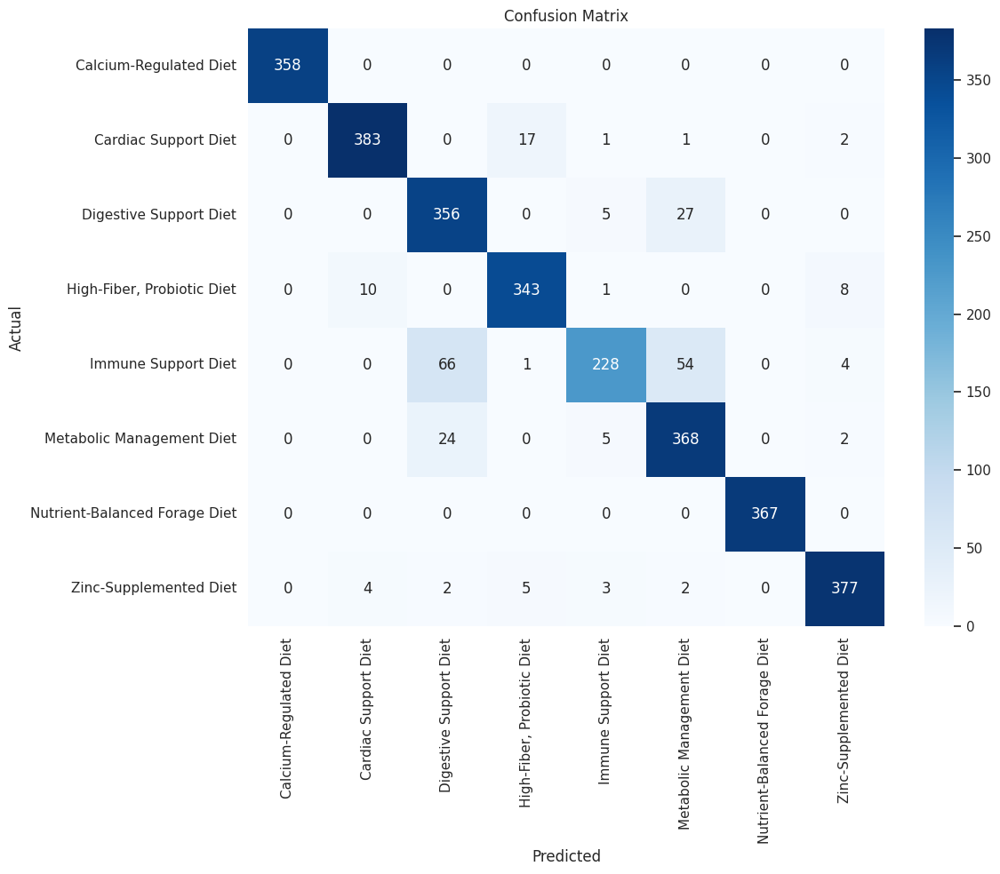

Confusion matrix plot saved as 'final_confusion_matrix.png'.


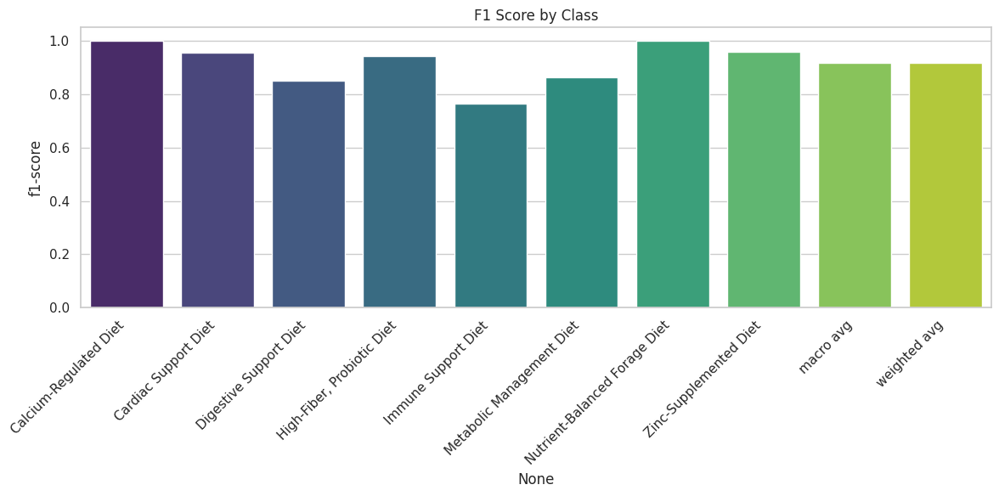

Class F1 scores plot saved as 'class_f1_scores.png'.
===== Model Evaluation Completed =====



In [ ]:
def evaluate_models(best_model, X, y):
    """
    Comprehensive evaluation of the best model with detailed prints and visualizations.
    """
    from sklearn.model_selection import train_test_split, cross_val_predict
    from sklearn.metrics import (
        accuracy_score, precision_score, recall_score, f1_score,
        roc_auc_score, confusion_matrix, classification_report
    )
    import matplotlib.pyplot as plt
    import seaborn as sns
    import pandas as pd
    import numpy as np

    print("===== Starting Model Evaluation =====")

    # Split data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    print(f"Training set shape: {X_train.shape}, Test set shape: {X_test.shape}")

    # Fit model on training data
    best_model.fit(X_train, y_train)
    print("Model training completed.")

    # Predict on test set
    y_pred = best_model.predict(X_test)
    print("Predictions on test set completed. Sample predictions:")
    print(y_pred[:10])

    # Try to get predicted probabilities (for ROC-AUC)
    try:
        y_proba = best_model.predict_proba(X_test)
        print("Predicted probabilities obtained.")
    except Exception as e:
        print("Model doesn't support probability predictions. Skipping ROC-AUC calculation.")
        y_proba = None

    # Calculate evaluation metrics
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')

    print("\nModel Evaluation Metrics:")
    print(f"Accuracy:  {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall:    {recall:.4f}")
    print(f"F1 Score:  {f1:.4f}")

    # ROC-AUC calculation for multi-class (one-vs-rest)
    if y_proba is not None:
        try:
            roc_auc = roc_auc_score(pd.get_dummies(y_test), y_proba, multi_class='ovr', average='weighted')
            print(f"ROC-AUC:   {roc_auc:.4f}")
        except Exception as e:
            print("Error in ROC-AUC calculation:", e)
            roc_auc = None
    else:
        roc_auc = None

    # Print detailed classification report
    report = classification_report(y_test, y_pred)
    print("\nClassification Report:")
    print(report)

    # Create confusion matrix and print it
    cm = confusion_matrix(y_test, y_pred)
    print("Confusion Matrix:")
    print(cm)

    # Plot confusion matrix
    plt.figure(figsize=(12, 10))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=sorted(set(y)),
                yticklabels=sorted(set(y)))
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Confusion Matrix')
    plt.tight_layout()
    plt.savefig('final_confusion_matrix.png')
    plt.show()
    print("Confusion matrix plot saved as 'final_confusion_matrix.png'.")

    # Plot class-wise F1 scores from classification report
    report_dict = classification_report(y_test, y_pred, output_dict=True)
    class_metrics = pd.DataFrame(report_dict).T.drop('accuracy', errors='ignore')
    plt.figure(figsize=(12, 6))
    sns.barplot(x=class_metrics.index, y=class_metrics['f1-score'], palette='viridis')
    plt.title('F1 Score by Class')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.savefig('class_f1_scores.png')
    plt.show()
    print("Class F1 scores plot saved as 'class_f1_scores.png'.")

    print("===== Model Evaluation Completed =====\n")

    return {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'roc_auc': roc_auc,
        'predictions': y_pred,
        'test_targets': y_test,
        'confusion_matrix': cm
    }

# Evaluate the final model using balanced data
evaluation_results = evaluate_models(best_model, X_balanced, y_balanced)

**9. Model Explainability**

 99%|===================| 355/360 [00:34<00:00]       

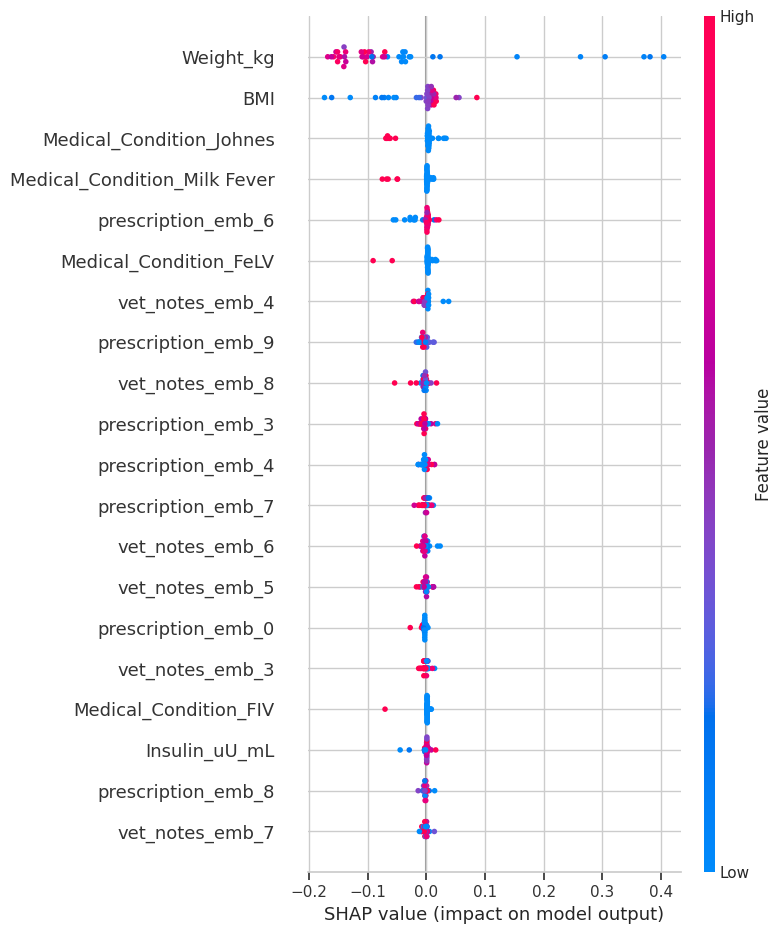

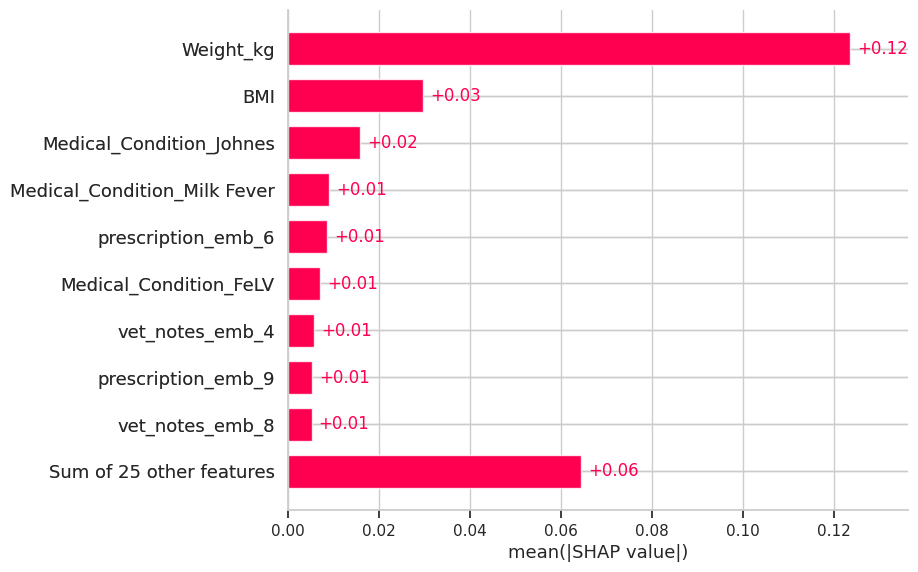

In [ ]:
# SHAP values for global interpretability
import shap

# Select a model for interpretation
explainer = shap.Explainer(best_model, X_balanced)
X_test_subsample = X_test.sample(frac=0.015, random_state=42)
shap_values = explainer(X_test_subsample, check_additivity=False)

shap_values_class0 = shap_values[:, :, 7]
# Plot summary for the specific class
plt.figure(figsize=(12, 8))
shap.summary_plot(shap_values_class0, X_test_subsample, feature_names=X_balanced.columns)
plt.tight_layout()
plt.savefig('shap_summary.png')
plt.close()

# Feature importance for the specific class
plt.figure(figsize=(12, 8))
shap.plots.bar(shap_values_class0)
plt.tight_layout()
plt.savefig('shap_feature_importance.png')
plt.close()

 99%|===================| 1198/1208 [01:49<00:00]       

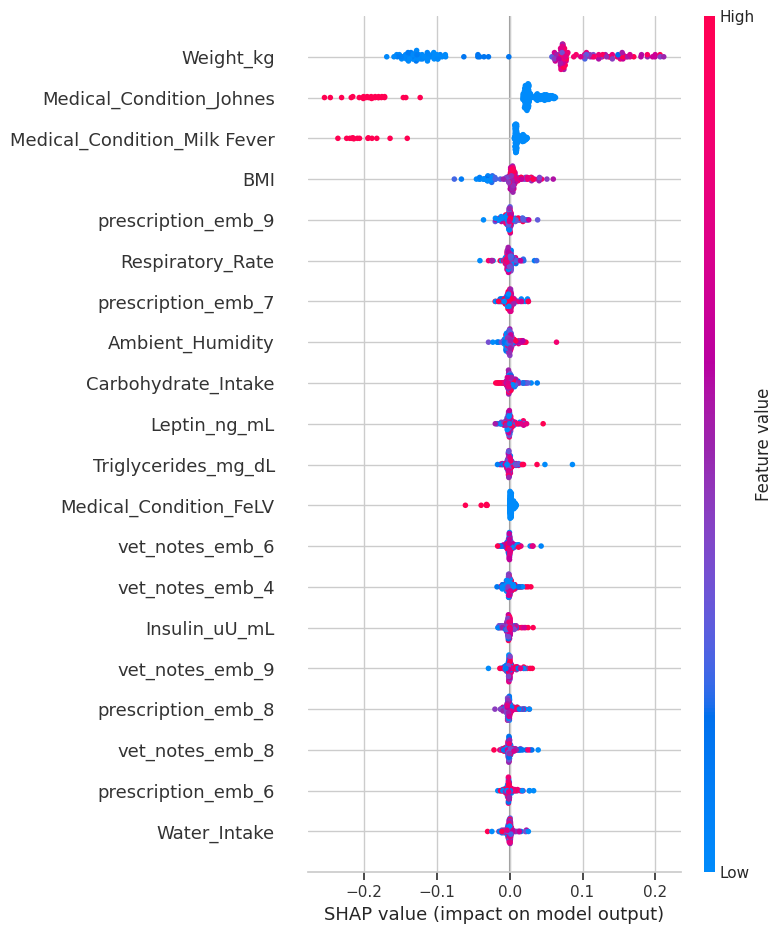

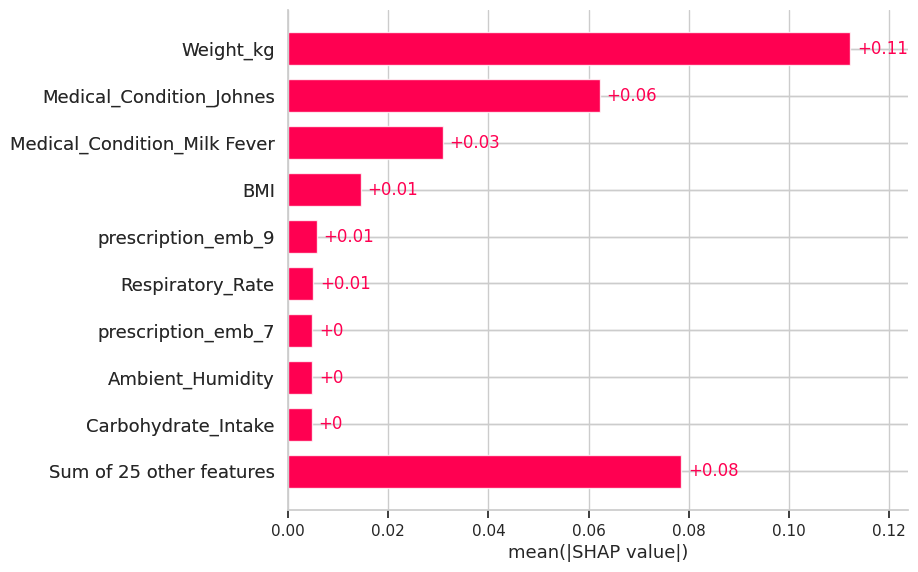

In [ ]:
# SHAP values for global interpretability
import shap

# Select a model for interpretation
explainer = shap.Explainer(best_model, X_balanced)
X_test_subsample = X_test.sample(frac=0.05, random_state=42)
shap_values = explainer(X_test_subsample, check_additivity=False)

shap_values_class0 = shap_values[:, :, 5]
# Plot summary for the specific class
plt.figure(figsize=(12, 8))
shap.summary_plot(shap_values_class0, X_test_subsample, feature_names=X_balanced.columns)
plt.tight_layout()
plt.savefig('shaps_summary.png')
plt.close()

# Feature importance for the specific class
plt.figure(figsize=(12, 8))
shap.plots.bar(shap_values_class0)
plt.tight_layout()
plt.savefig('shaps_feature_importance.png')
plt.close()

100%|===================| 1204/1208 [02:09<00:00]       

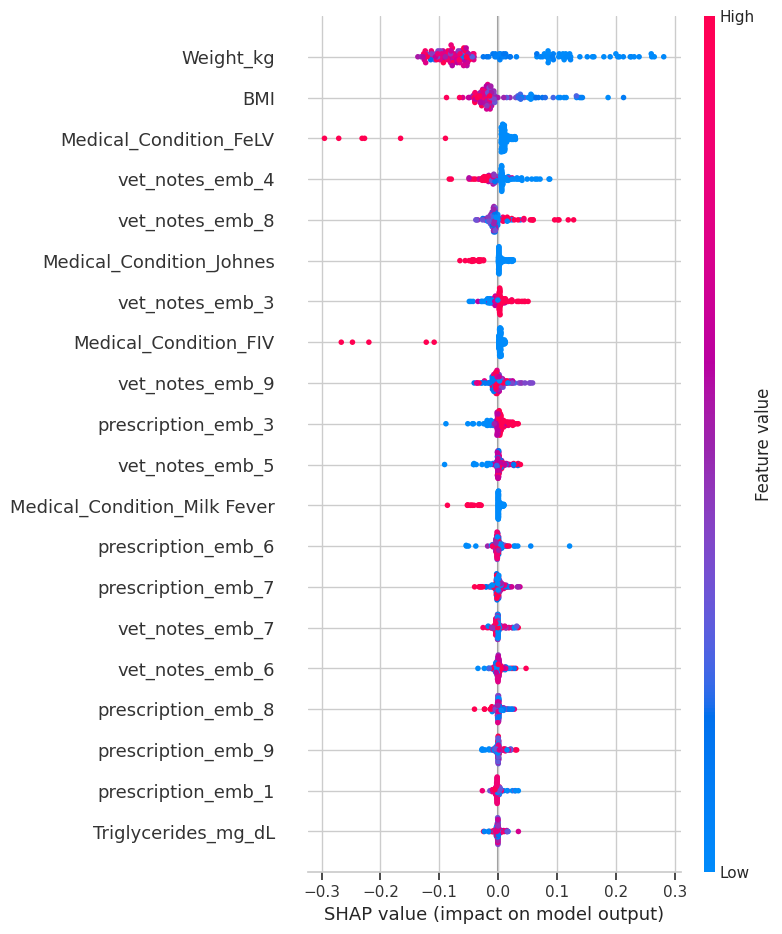

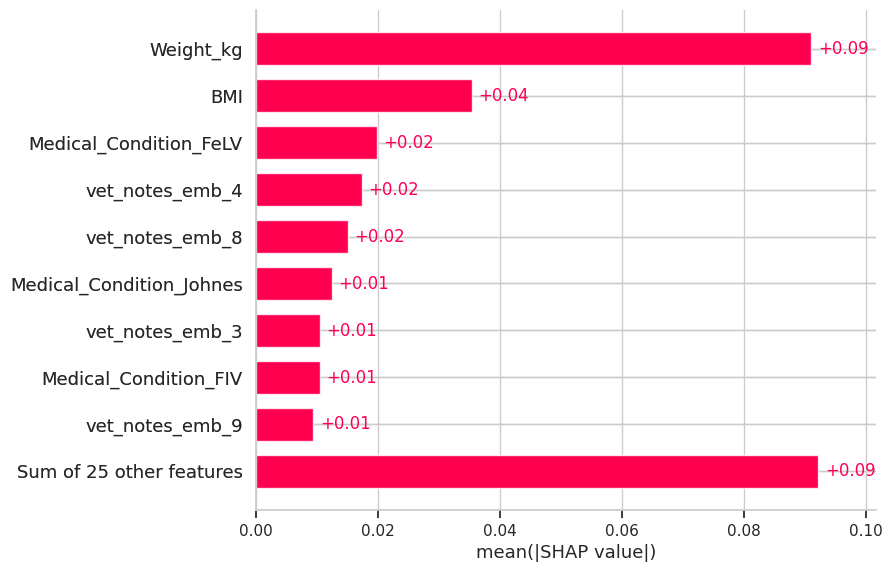

In [ ]:
# SHAP values for global interpretability
import shap

# Select a model for interpretation
explainer = shap.Explainer(best_model, X_balanced)
X_test_subsample = X_test.sample(frac=0.05, random_state=42)
shap_values = explainer(X_test_subsample, check_additivity=False)

shap_values_class0 = shap_values[:, :, 3]
# Plot summary for the specific class
plt.figure(figsize=(12, 8))
shap.summary_plot(shap_values_class0, X_test_subsample, feature_names=X_balanced.columns)
plt.tight_layout()
plt.savefig('shaps_summary.png')
plt.close()

# Feature importance for the specific class
plt.figure(figsize=(12, 8))
shap.plots.bar(shap_values_class0)
plt.tight_layout()
plt.savefig('shaps_feature_importance.png')
plt.close()

 99%|===================| 1200/1208 [01:40<00:00]       

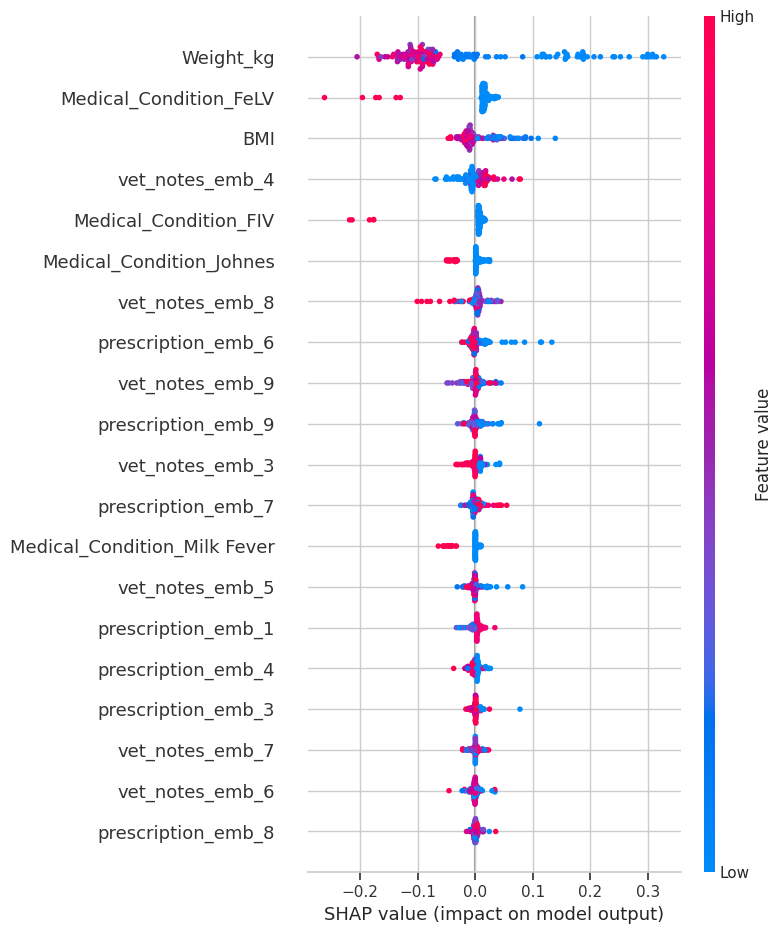

<Figure size 1000x600 with 0 Axes>

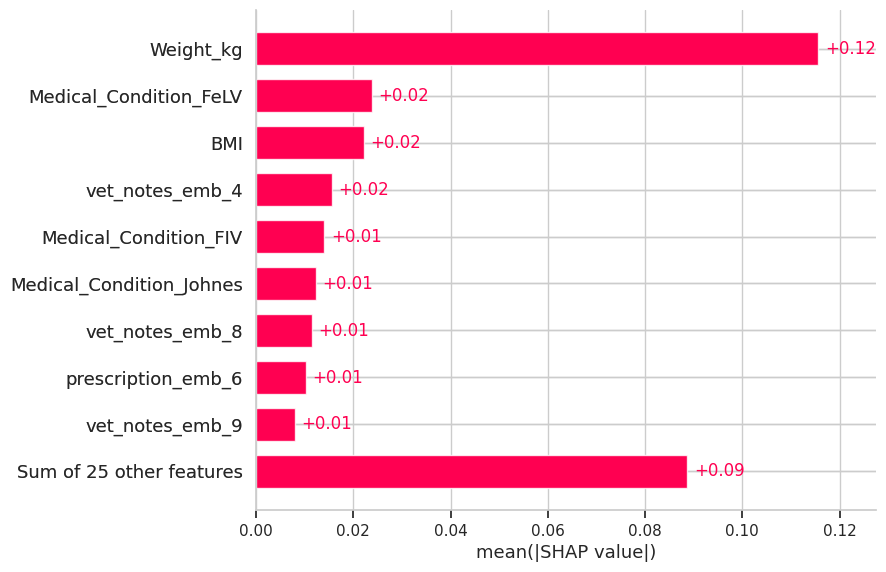

<Figure size 1000x600 with 0 Axes>

In [ ]:
# SHAP values for global interpretability
import shap

# Select a model for interpretation
explainer = shap.Explainer(best_model, X_balanced)
X_test_subsample = X_test.sample(frac=0.05, random_state=42)
shap_values = explainer(X_test_subsample, check_additivity=False)

shap_values_class0 = shap_values[:, :, 1]
# Plot summary for the specific class
plt.figure(figsize=(12, 8))
shap.summary_plot(shap_values_class0, X_test_subsample, feature_names=X_balanced.columns)
plt.tight_layout()
plt.savefig('shaps_summary.png')
plt.show()
plt.close()

# Feature importance for the specific class
plt.figure(figsize=(12, 8))
shap.plots.bar(shap_values_class0)
plt.tight_layout()
plt.savefig('shaps_feature_importance.png')
plt.show()
plt.close()

In [ ]:
pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 6.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=a196da8cf852c982376e786ebe0f194d70a1cf5fbed13ec560a111a19aac1761
  Stored in directory: /root/.cache/pip/wheels/85/fa/a3/9c2d44c9f3cd77cf4e533b58900b2bf4487f2a17e8ec212a3d
Successfully built lime


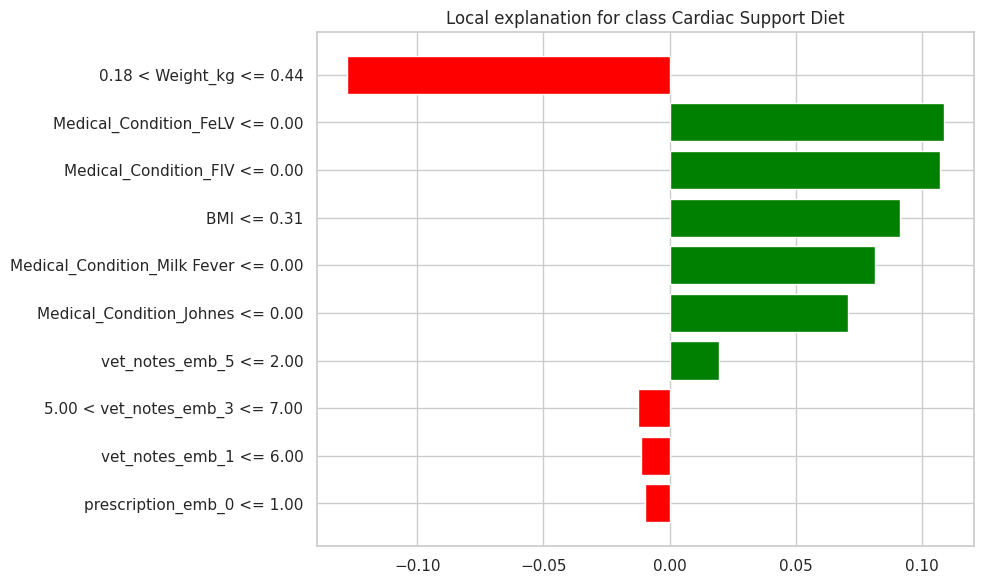

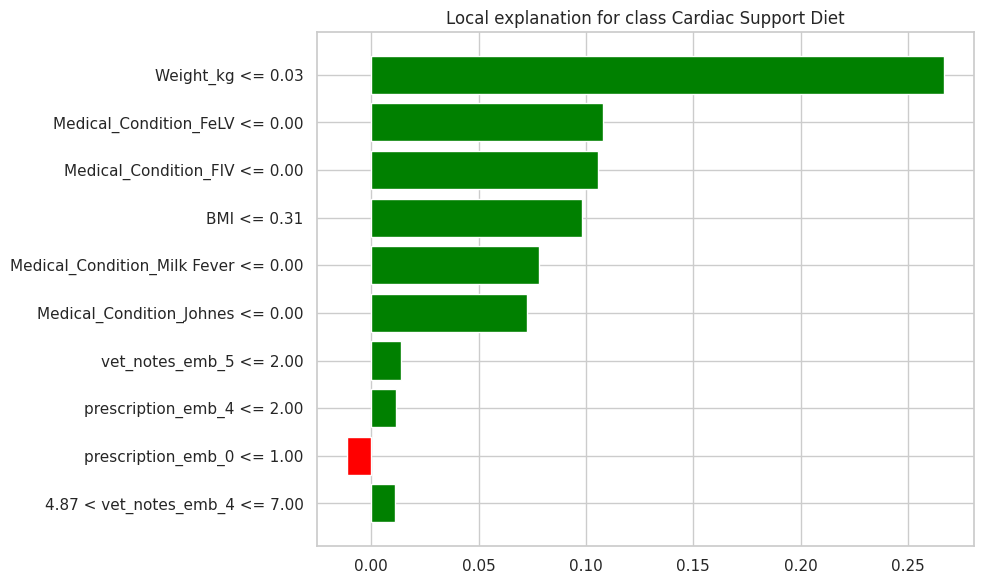

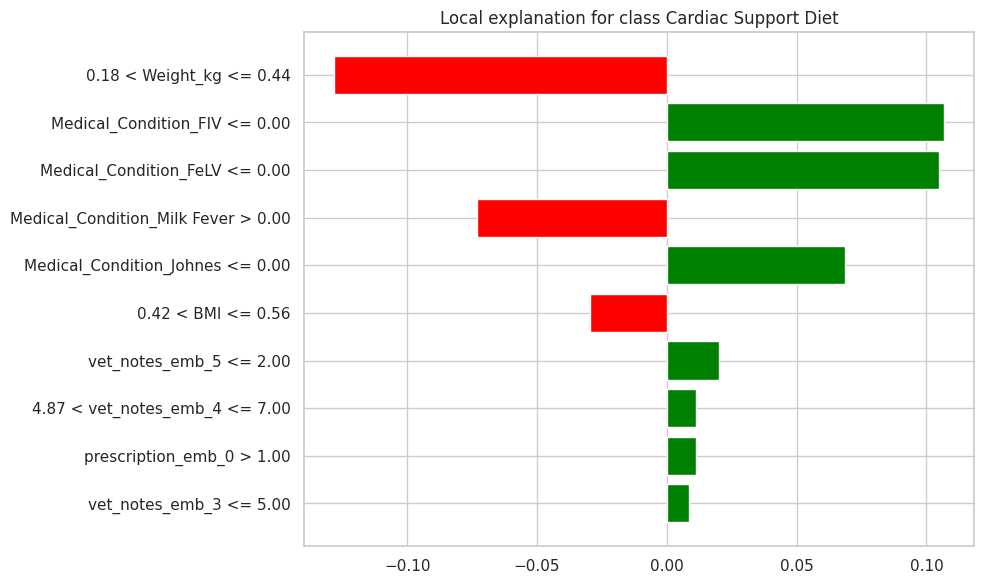

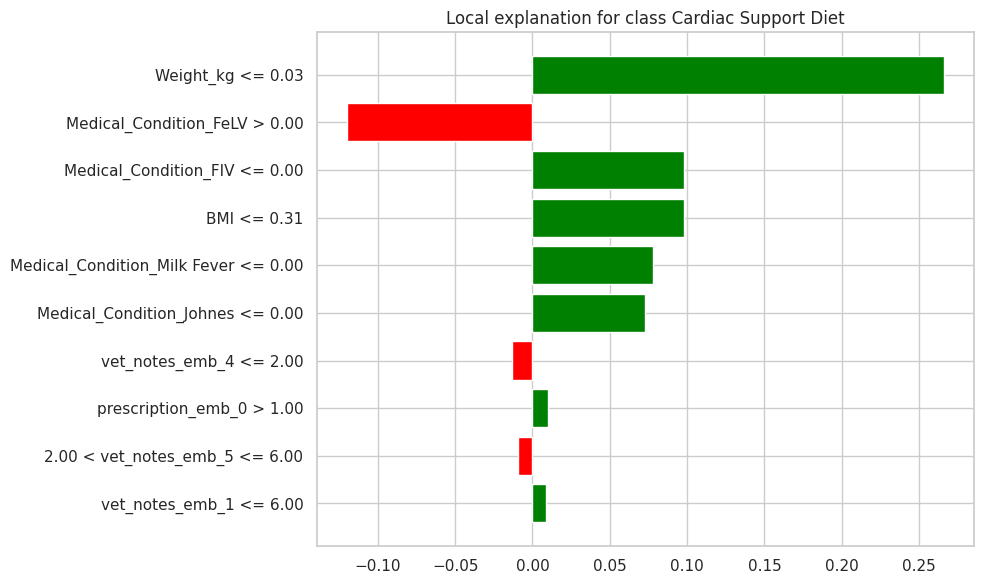

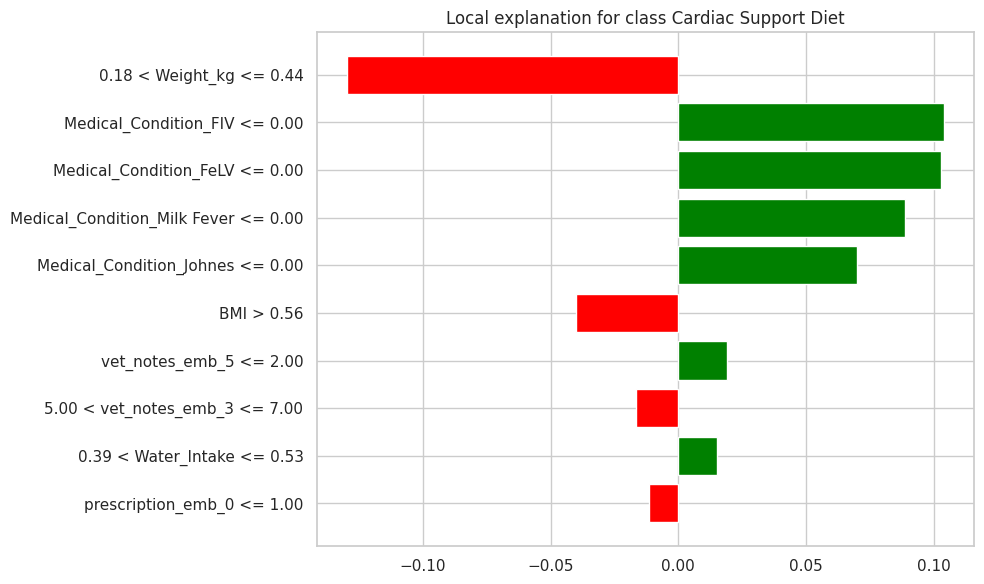

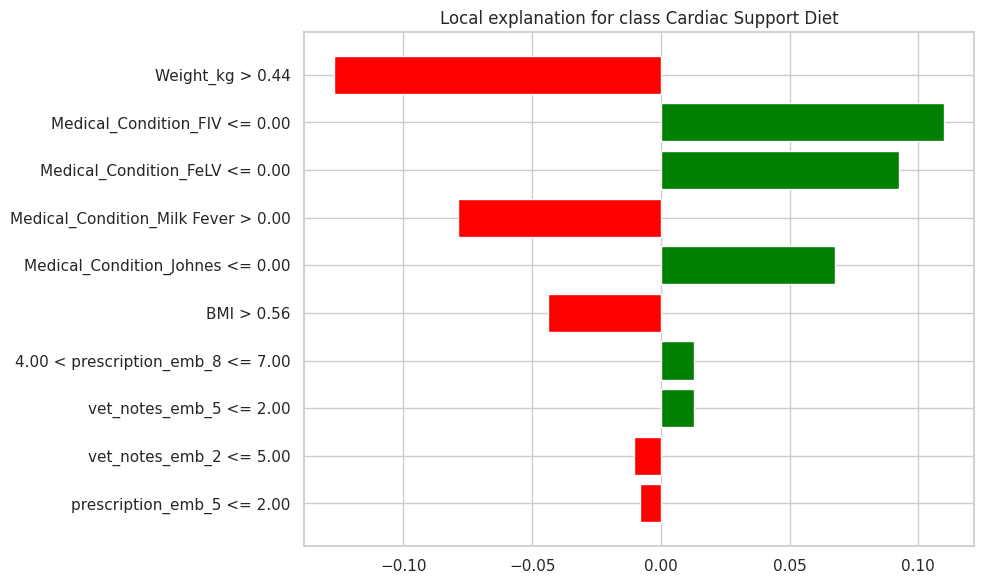

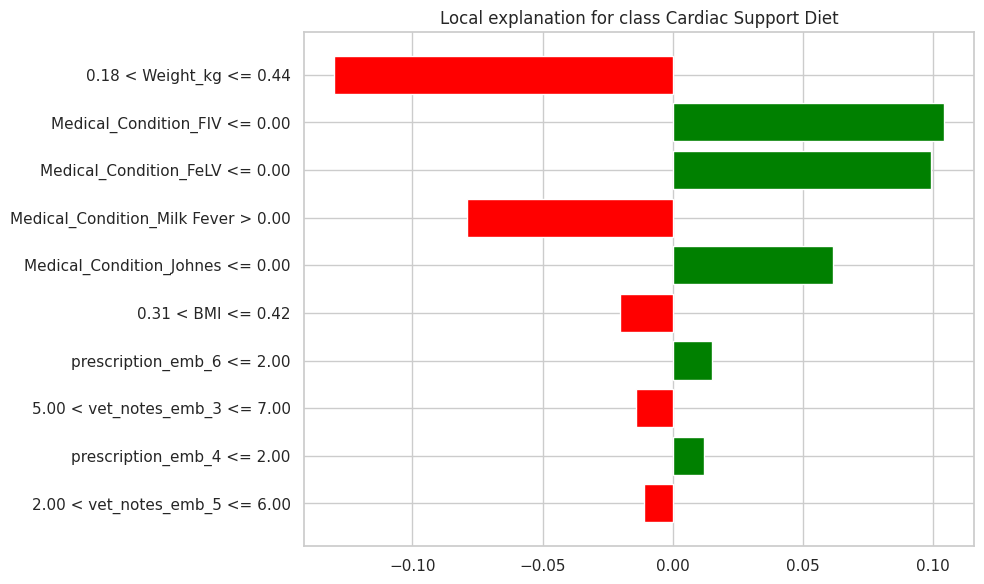

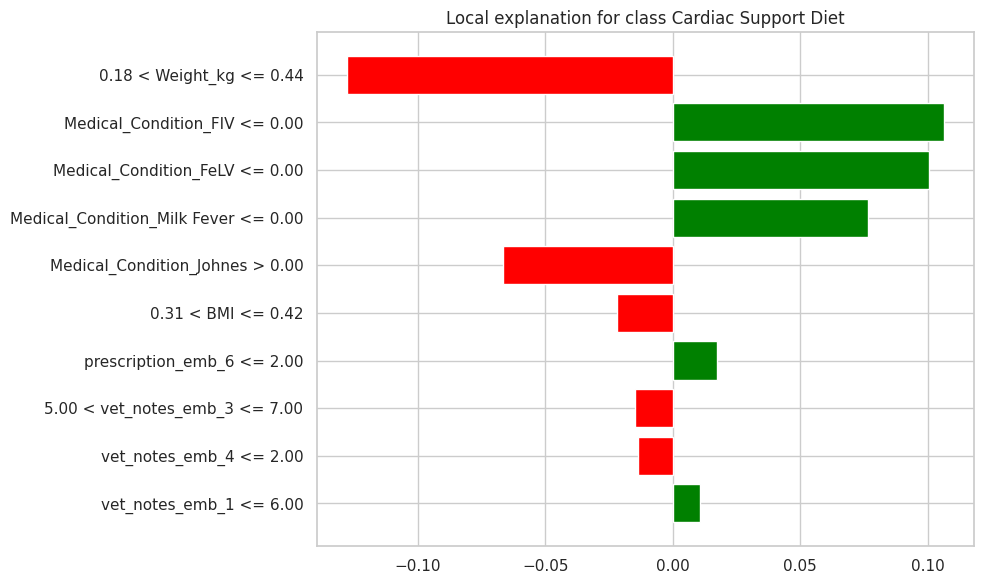

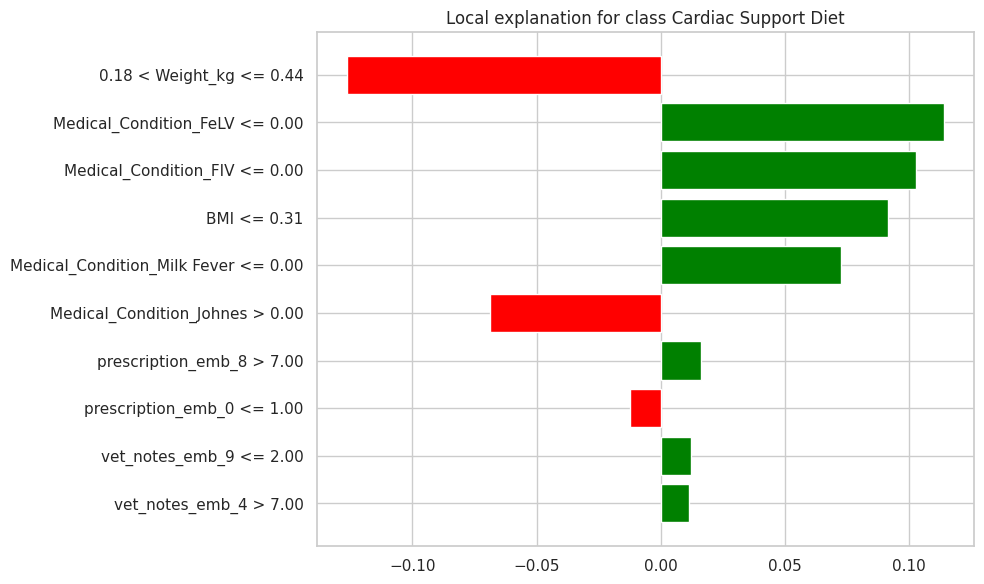

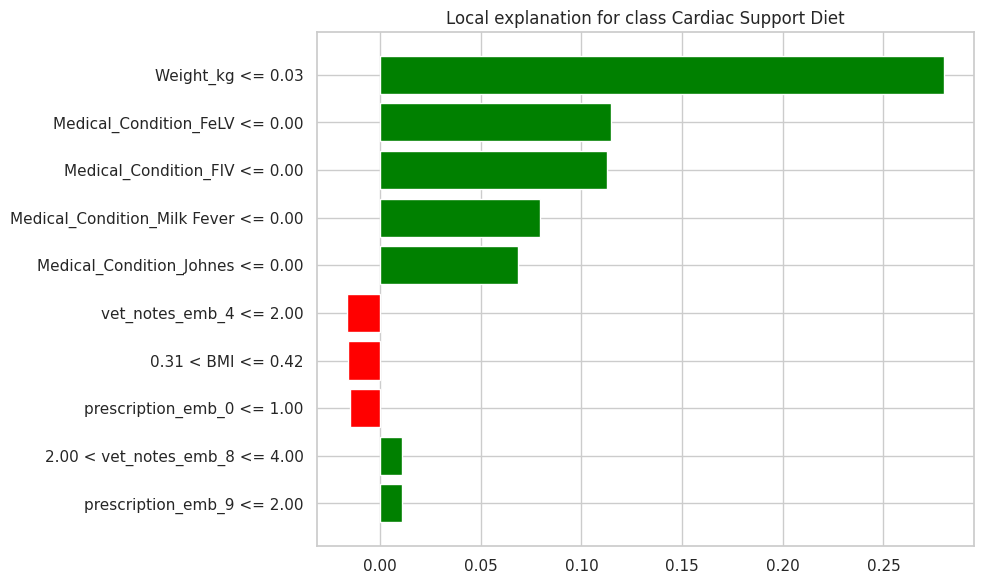

In [ ]:
# LIME for local interpretability
import lime
from lime import lime_tabular

# Create explainer
# Convert X_balanced to a NumPy array
X_balanced_np = X_balanced.values

lime_explainer = lime_tabular.LimeTabularExplainer(
    X_balanced_np,
    feature_names=X_balanced.columns.tolist(),
    class_names=list(best_model.classes_),
    mode='classification'
)

# Explain a single prediction
idx = 0  # Index of sample to explain
# Convert X_test to NumPy array
X_test_np = X_test.values

exp = lime_explainer.explain_instance(
    X_test_np[idx],
    best_model.predict_proba,
    num_features=10
)
# Save explanation
fig = exp.as_pyplot_figure(label=1)
plt.tight_layout()
plt.savefig(f'lime_explanation_sample_{idx}.png')
plt.close()

# Generate explanations for multiple samples
for i in range(10):  # Explain 10 samples
    exp = lime_explainer.explain_instance(
        X_test_np[i],
        best_model.predict_proba,
        num_features=10
    )
    fig = exp.as_pyplot_figure(label=1)
    plt.tight_layout()
    plt.savefig(f'lime_explanation_sample_{i}.png')
    plt.show()
    plt.close()

exp.show_in_notebook(show_table=True)

Generating LIME explanation for a test instance...


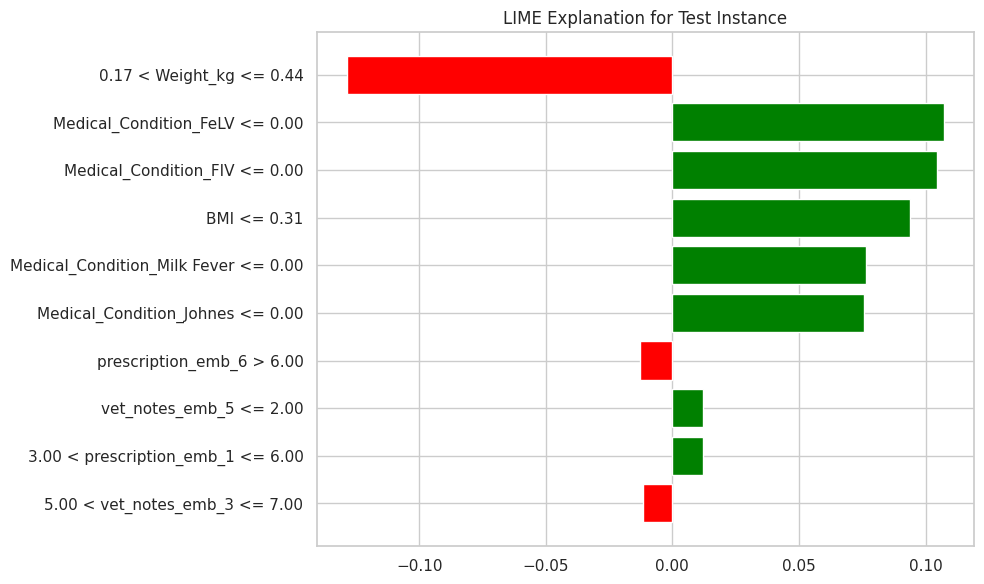

In [ ]:
# ----- Local Explanation using LIME -----
from sklearn.model_selection import train_test_split
from lime import lime_tabular
from lime.lime_tabular import LimeTabularExplainer
import numpy as np
import matplotlib.pyplot as plt

print("Generating LIME explanation for a test instance...")
X_train, _, _, _ = train_test_split(X_balanced, y_balanced, test_size=0.2, random_state=42)
# Define feature names from X_train.
feature_names = X_train.columns.tolist()

# Get the number of classes from the trained model
num_classes = len(best_model.classes_)

# Define class names
class_names = [f"Class {i}" for i in range(num_classes)]

# Create a LIME Tabular Explainer.
lime_explainer = LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=feature_names,
    class_names=class_names,
    mode='classification'
)

instance_idx = 0 # Index of test instance
test_instance = X_test.values[instance_idx]

# Use best_model.predict_proba directly in explain_instance
# Generate a LIME explanation for a selected test instance.
exp = lime_explainer.explain_instance(
    test_instance,
    best_model.predict_proba,  # Use predict_proba directly
    num_features=10,  # Top 10 influential features.
    top_labels=num_classes  # Explain all classes.
)

# Visualize the LIME explanation.
fig = exp.as_pyplot_figure()
plt.title("LIME Explanation for Test Instance")
plt.tight_layout()
plt.show()

# Alternatively, in a notebook:
exp.show_in_notebook(show_table=True)

Generating LIME explanation for a test instance...


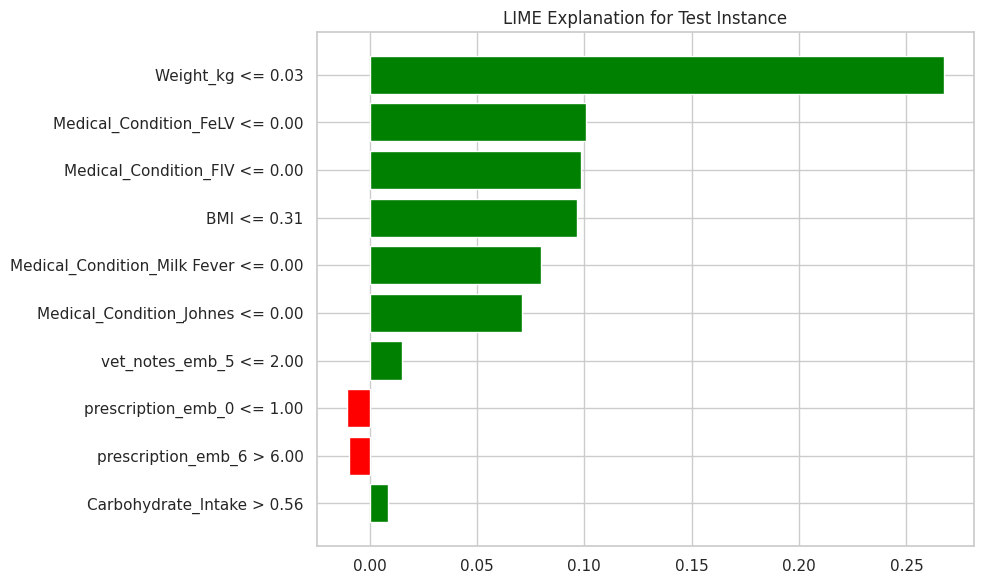

In [ ]:
# ----- Local Explanation using LIME -----
from sklearn.model_selection import train_test_split
from lime import lime_tabular
from lime.lime_tabular import LimeTabularExplainer
import numpy as np
import matplotlib.pyplot as plt

print("Generating LIME explanation for a test instance...")
X_train, _, _, _ = train_test_split(X_balanced, y_balanced, test_size=0.2, random_state=42)
# Define feature names from X_train.
feature_names = X_train.columns.tolist()

# Get the number of classes from the trained model
num_classes = len(best_model.classes_)

# Define class names
class_names = [f"Class {i}" for i in range(num_classes)]

# Create a LIME Tabular Explainer.
lime_explainer = LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=feature_names,
    class_names=class_names,
    mode='classification'
)

instance_idx = 1 # Index of test instance
test_instance = X_test.values[instance_idx]

# Use best_model.predict_proba directly in explain_instance
# Generate a LIME explanation for a selected test instance.
exp = lime_explainer.explain_instance(
    test_instance,
    best_model.predict_proba,  # Use predict_proba directly
    num_features=10,  # Top 10 influential features.
    top_labels=num_classes  # Explain all classes.
)

# Visualize the LIME explanation.
fig = exp.as_pyplot_figure()
plt.title("LIME Explanation for Test Instance")
plt.tight_layout()
plt.show()

# Alternatively, in a notebook:
exp.show_in_notebook(show_table=True)

Generating LIME explanation for a test instance...


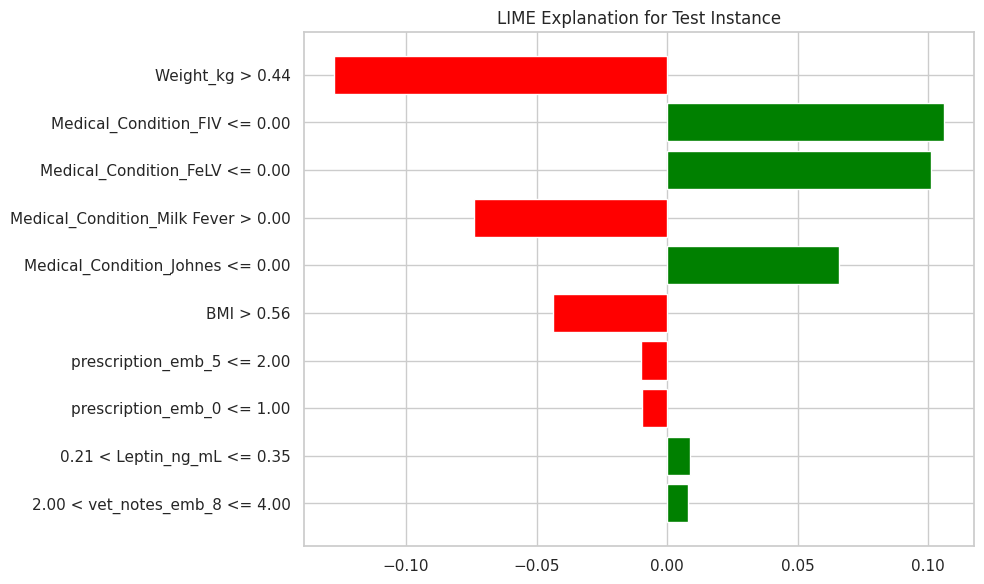

In [ ]:
# ----- Local Explanation using LIME -----
from sklearn.model_selection import train_test_split
from lime import lime_tabular
from lime.lime_tabular import LimeTabularExplainer
import numpy as np
import matplotlib.pyplot as plt

print("Generating LIME explanation for a test instance...")
X_train, _, _, _ = train_test_split(X_balanced, y_balanced, test_size=0.2, random_state=42)
# Define feature names from X_train.
feature_names = X_train.columns.tolist()

# Get the number of classes from the trained model
num_classes = len(best_model.classes_)

# Define class names
class_names = [f"Class {i}" for i in range(num_classes)]

# Create a LIME Tabular Explainer.
lime_explainer = LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=feature_names,
    class_names=class_names,
    mode='classification'
)

instance_idx = 5 # Index of test instance
test_instance = X_test.values[instance_idx]

# Use best_model.predict_proba directly in explain_instance
# Generate a LIME explanation for a selected test instance.
exp = lime_explainer.explain_instance(
    test_instance,
    best_model.predict_proba,  # Use predict_proba directly
    num_features=10,  # Top 10 influential features.
    top_labels=num_classes  # Explain all classes.
)

# Visualize the LIME explanation.
fig = exp.as_pyplot_figure()
plt.title("LIME Explanation for Test Instance")
plt.tight_layout()
plt.show()

# Alternatively, in a notebook:
exp.show_in_notebook(show_table=True)

Generating LIME explanation for a test instance...


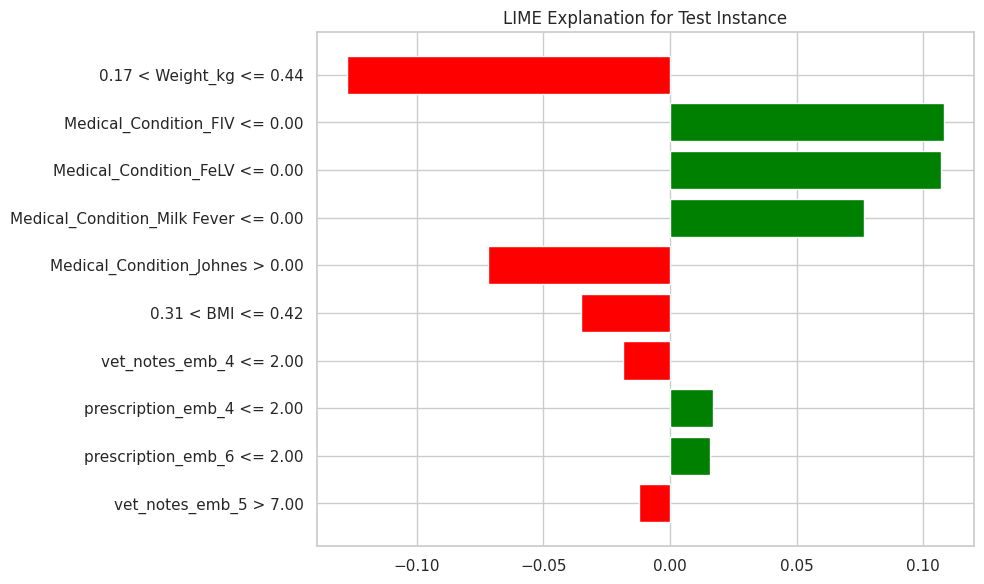

In [ ]:
# ----- Local Explanation using LIME -----
from sklearn.model_selection import train_test_split
from lime import lime_tabular
from lime.lime_tabular import LimeTabularExplainer
import numpy as np
import matplotlib.pyplot as plt

print("Generating LIME explanation for a test instance...")
X_train, _, _, _ = train_test_split(X_balanced, y_balanced, test_size=0.2, random_state=42)
# Define feature names from X_train.
feature_names = X_train.columns.tolist()

# Get the number of classes from the trained model
num_classes = len(best_model.classes_)

# Define class names
class_names = [f"Class {i}" for i in range(num_classes)]

# Create a LIME Tabular Explainer.
lime_explainer = LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=feature_names,
    class_names=class_names,
    mode='classification'
)

instance_idx = 7 # Index of test instance
test_instance = X_test.values[instance_idx]

# Use best_model.predict_proba directly in explain_instance
# Generate a LIME explanation for a selected test instance.
exp = lime_explainer.explain_instance(
    test_instance,
    best_model.predict_proba,  # Use predict_proba directly
    num_features=10,  # Top 10 influential features.
    top_labels=num_classes  # Explain all classes.
)

# Visualize the LIME explanation.
fig = exp.as_pyplot_figure()
plt.title("LIME Explanation for Test Instance")
plt.tight_layout()
plt.show()

# Alternatively, in a notebook:
exp.show_in_notebook(show_table=True)

Generating LIME explanation for a test instance...


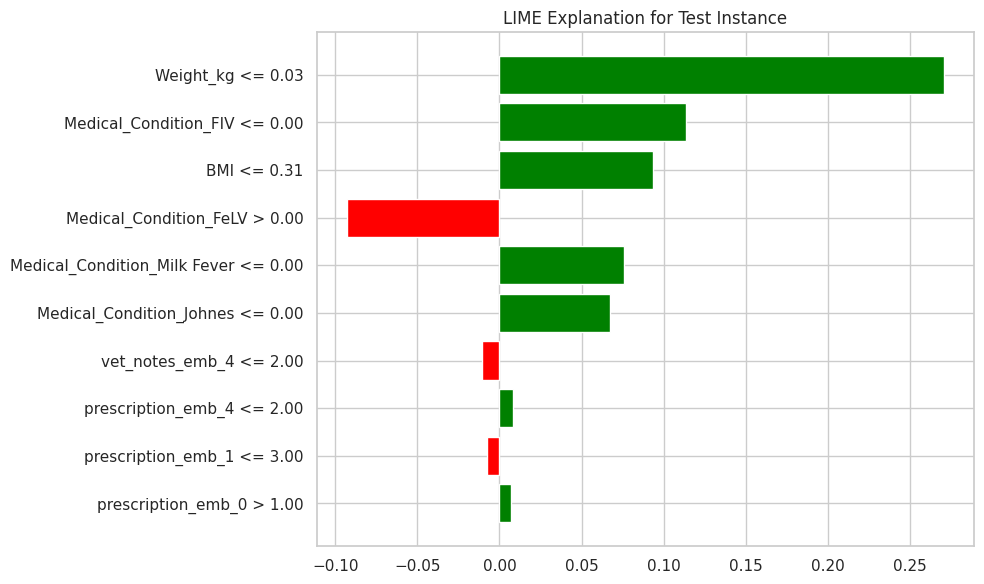

In [ ]:
# ----- Local Explanation using LIME -----
from sklearn.model_selection import train_test_split
from lime import lime_tabular
from lime.lime_tabular import LimeTabularExplainer
import numpy as np
import matplotlib.pyplot as plt

print("Generating LIME explanation for a test instance...")
X_train, _, _, _ = train_test_split(X_balanced, y_balanced, test_size=0.2, random_state=42)
# Define feature names from X_train.
feature_names = X_train.columns.tolist()

# Get the number of classes from the trained model
num_classes = len(best_model.classes_)

# Define class names
class_names = [f"Class {i}" for i in range(num_classes)]

# Create a LIME Tabular Explainer.
lime_explainer = LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=feature_names,
    class_names=class_names,
    mode='classification'
)

instance_idx = 3 # Index of test instance
test_instance = X_test.values[instance_idx]

# Use best_model.predict_proba directly in explain_instance
# Generate a LIME explanation for a selected test instance.
exp = lime_explainer.explain_instance(
    test_instance,
    best_model.predict_proba,  # Use predict_proba directly
    num_features=10,  # Top 10 influential features.
    top_labels=num_classes  # Explain all classes.
)

# Visualize the LIME explanation.
fig = exp.as_pyplot_figure()
plt.title("LIME Explanation for Test Instance")
plt.tight_layout()
plt.show()

# Alternatively, in a notebook:
exp.show_in_notebook(show_table=True)

In [ ]:
# Conditioned Text Generation
from transformers import GPT2LMHeadModel, GPT2Tokenizer

tokenizer = GPT2Tokenizer.from_pretrained('gpt2-medium')
model = GPT2LMHeadModel.from_pretrained('gpt2-medium')

def generate_note(condition, species):
    prompt = f"Generate veterinary notes for a {species} diagnosed with {condition}:"
    inputs = tokenizer(prompt, return_tensors='pt')

    outputs = model.generate(
        inputs.input_ids,
        max_length=200,
        temperature=0.7,
        top_p=0.9,
        repetition_penalty=1.2,
        num_return_sequences=3,
        do_sample=True
    )

    return [tokenizer.decode(output, skip_special_tokens=True) for output in outputs]

# Generate synthetic BRD cases
synthetic_notes = generate_note('Bovine Respiratory Disease', 'Cow')
print(synthetic_notes)

tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/718 [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model.safetensors:   0%|          | 0.00/1.52G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/124 [00:00<?, ?B/s]

The attention mask and the pad token id were not set. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.
The attention mask is not set and cannot be inferred from input because pad token is same as eos token. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.


["Generate veterinary notes for a Cow diagnosed with Bovine Respiratory Disease:\n'An immediate appointment is needed to confirm the diagnosis and determine treatment options. A thorough physical examination will be necessary, including an assessment of respiratory parameters such as oxygen saturation and airway pressure.'", 'Generate veterinary notes for a Cow diagnosed with Bovine Respiratory Disease:\n"The veterinarian should determine the cause of illness, including any signs or symptoms which may indicate bacterial pneumonia."\nA recent study in The Journal Of Clinical Investigation found that cow meat is more likely to be contaminated with pathogens than chicken. That finding prompted researchers at Stanford University and Michigan State Health System (MSHS) School – Medical Sciences to perform tests on animals from two locations where they had previously tested feces samples taken after eating beef cattle carcasses . They uncovered evidence suggesting some animal species could a

In [ ]:
# Save the notes to a text file
with open("synthetic_notes.txt", "w") as file:
    for note in synthetic_notes:
        file.write(note + "\n\n")

print("Notes saved to synthetic_notes.txt")

Notes saved to synthetic_notes.txt


In [ ]:
import os
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
from wordcloud import WordCloud
import seaborn as sns
from transformers import AutoTokenizer, AutoModelForCausalLM
from sklearn.utils import resample

# Load the tokenizer and model
tokenizer = AutoTokenizer.from_pretrained('distilgpt2')
tokenizer.pad_token = tokenizer.eos_token
model = AutoModelForCausalLM.from_pretrained('distilgpt2')

# Define rare conditions
rare_conditions = [
    "Leptospirosis", "Addison's Disease",
    "Pasteurellosis", "Feline Immunodeficiency Virus",
    "Heartworm"
]

# Define appropriate species for each condition
condition_species = {
    "Leptospirosis": ["canine", "feline"],
    "Addison's Disease": ["canine", "feline"],
    "Pasteurellosis": ["cattle", "rabbits", "sheep"],
    "Feline Immunodeficiency Virus": ["feline"],
    "Heartworm": ["dogs", "cats", "ferrets"]
}

In [ ]:
# Define numerical columns for our dataset
numerical_cols = ['Age', 'Weight_kg', 'Temperature_C', 'Heart_Rate', 'Respiratory_Rate']

def generate_vet_notes(condition, n_samples=5):
    """Generate synthetic veterinary notes for a given condition"""
    print(f"Generating {n_samples} notes for {condition}...")
    synthetic_notes = []
    species_options = condition_species.get(condition, ["canine", "feline", "reptile", "cattle", "cats"])

    for i in tqdm(range(n_samples)):
        species = random.choice(species_options)
        age = random.randint(1, 15)
        severity = random.choice(["mild", "moderate", "severe"])
        weight = round(random.uniform(1, 50), 1)
        temperature = round(random.uniform(37.5, 40.5), 1)
        heart_rate = random.randint(60, 180)
        respiratory_rate = random.randint(10, 40)

        prompt = f"""Create a realistic veterinary case note for the following patient:

Patient details:
- Species: {species}
- Age: {age} years
- Diagnosis: {condition} ({severity} case)

The note should include:
1. Clinical signs and symptoms
2. Physical examination findings
3. Treatment plan with specific medications
4. Dietary recommendations
5. Follow-up instructions

Format as a professional veterinary case note. Include realistic details specific to this condition in this species.
"""

        try:
            use_template = True
            note = ""

            if not use_template:
                # Generate using transformers
                inputs = tokenizer(prompt, return_tensors="pt", padding=True, truncation=True, max_length=1024)

                output = model.generate(
                    **inputs,
                    max_new_tokens=300,
                    temperature=0.7,
                    pad_token_id=tokenizer.eos_token_id
                )

                note = tokenizer.decode(output[0], skip_special_tokens=True)
            else:
                # Template-based generation
                symptoms = {
                    "Leptospirosis": ["fever", "vomiting", "abdominal pain", "jaundice", "kidney failure"],
                    "Addison's Disease": ["lethargy", "vomiting", "weight loss", "weakness", "low blood pressure"],
                    "Pasteurellosis": ["respiratory issues", "sneezing", "nasal discharge", "conjunctivitis", "abscesses"],
                    "Feline Immunodeficiency Virus": ["weight loss", "poor coat condition", "chronic infections", "fever", "lethargy"],
                    "Heartworm": ["coughing", "fatigue", "weight loss", "difficulty breathing", "heart failure"]
                }

                treatments = {
                    "Leptospirosis": ["ampicillin", "doxycycline", "fluid therapy", "liver/kidney support"],
                    "Addison's Disease": ["fludrocortisone", "prednisone", "electrolyte monitoring", "stress management"],
                    "Pasteurellosis": ["enrofloxacin", "trimethoprim-sulfa", "wound cleaning", "supportive care"],
                    "Feline Immunodeficiency Virus": ["supportive care", "antimicrobials for secondary infections", "stress reduction", "regular monitoring"],
                    "Heartworm": ["melarsomine", "doxycycline", "exercise restriction", "preventative care"]
                }

                diets = {
                    "Leptospirosis": "Low protein, kidney-friendly diet with increased hydration",
                    "Addison's Disease": "High-sodium diet with balanced nutrients",
                    "Pasteurellosis": "High-quality diet with immune-boosting supplements",
                    "Feline Immunodeficiency Virus": "High-calorie, nutrient-dense diet with immune support",
                    "Heartworm": "Low-sodium, high-quality diet with restricted exercise"
                }

                cond_symptoms = symptoms.get(condition, ["lethargy", "abnormal behavior", "loss of appetite"])
                cond_treatments = treatments.get(condition, ["supportive care", "monitoring", "pain management"])
                cond_diet = diets.get(condition, "High-quality diet appropriate for species and condition")

                selected_symptoms = random.sample(cond_symptoms, min(3, len(cond_symptoms)))
                selected_treatments = random.sample(cond_treatments, min(2, len(cond_treatments)))

                note = f"""VETERINARY CASE NOTE

DATE: {random.randint(1, 28)}/{random.randint(1, 12)}/2024
PATIENT ID: #{random.randint(10000, 99999)}
SPECIES: {species}
AGE: {age} years
WEIGHT: {weight} kg
TEMPERATURE: {temperature}°C
HEART RATE: {heart_rate} bpm
RESPIRATORY RATE: {respiratory_rate} breaths/min
DIAGNOSIS: {condition} ({severity})

CLINICAL SIGNS:
Patient presented with {', '.join(selected_symptoms)}.
Owner reports symptoms began approximately {random.randint(1, 14)} days ago.

PHYSICAL EXAMINATION:
{species.capitalize()} appears {['alert but stressed', 'lethargic', 'distressed', 'quiet but responsive'][random.randint(0, 3)]}.
{random.choice(['Mucous membranes pale', 'Mucous membranes pink and moist', 'Mild dehydration noted', 'Hydration status adequate'])}.
{random.choice(['Lymph nodes not enlarged', 'Slight lymphadenopathy', 'Moderate enlargement of submandibular lymph nodes'])}.
{random.choice(['Abdomen soft on palpation', 'Mild abdominal tenderness', 'Significant pain on abdominal palpation'])}.

TREATMENT PLAN:
1. {selected_treatments[0]}: Start immediately
2. {selected_treatments[1] if len(selected_treatments) > 1 else 'Supportive care'}: As directed
3. Monitor hydration status and electrolytes
4. Reassess in {random.randint(3, 14)} days

DIETARY RECOMMENDATIONS:
{cond_diet}

FOLLOW-UP:
Schedule recheck appointment in {random.randint(7, 28)} days.
Contact clinic immediately if symptoms worsen.
Bloodwork to be repeated at recheck to assess response to treatment.

Dr. {random.choice(['Smith', 'Johnson', 'Williams', 'Davis', 'Miller'])}
Veterinary License #{random.randint(10000, 99999)}
"""

            # Attempt to extract a line mentioning diet
            diet_text = "specialized diet"
            for line in note.split('\n'):
                if "diet" in line.lower():
                    diet_text = line.strip()
                    break

            # Create a more comprehensive dataset entry
            synthetic_notes.append({
                "Note": note,
                "Medical_Condition": condition,
                "Recommended_Diet": diet_text,
                "Species": species,
                "Age": age,
                "Weight_kg": weight,
                "Temperature_C": temperature,
                "Heart_Rate": heart_rate,
                "Respiratory_Rate": respiratory_rate,
                "Severity": severity
            })

        except Exception as e:
            print(f"Error generating note {i+1} for {condition}: {e}")

    return synthetic_notes


Generating 3 notes for Leptospirosis...


100%|██████████| 3/3 [00:00<00:00, 7480.92it/s]


Generating 3 notes for Addison's Disease...


100%|██████████| 3/3 [00:00<00:00, 9432.47it/s]


Generating 3 notes for Pasteurellosis...


100%|██████████| 3/3 [00:00<00:00, 9334.50it/s]


Generating 3 notes for Feline Immunodeficiency Virus...


100%|██████████| 3/3 [00:00<00:00, 9078.58it/s]


Generating 3 notes for Heartworm...


100%|██████████| 3/3 [00:00<00:00, 8774.69it/s]

Generated 15 synthetic veterinary notes

Sample note:

Condition: Leptospirosis (severe)
Species: feline, Age: 1 years

Note:
VETERINARY CASE NOTE

DATE: 17/1/2024
PATIENT ID: #54719
SPECIES: feline
AGE: 1 years
WEIGHT: 48.2 kg
TEMPERATURE: 38.9°C
HEART RATE: 116 bpm
RESPIRATORY RATE: 21 breaths/min
DIAGNOSIS: Leptospirosis (severe)

CLINICAL SIGNS:
Patient presented with vomiting, jaundice, kidney failure.
Owner reports symptoms began approximately 9 days ago.

PHYSICAL EXAMINATION:
Feline appears alert but stressed.
Hydration status adequate. 
Slight lymphadenopathy. 
Mild abdominal tenderness.

TREATMENT PLAN:
1. fl...


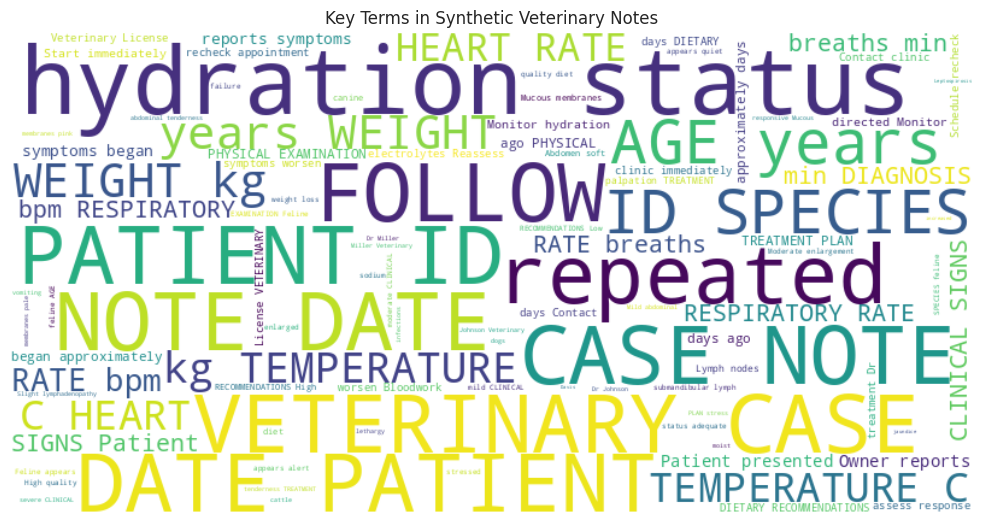

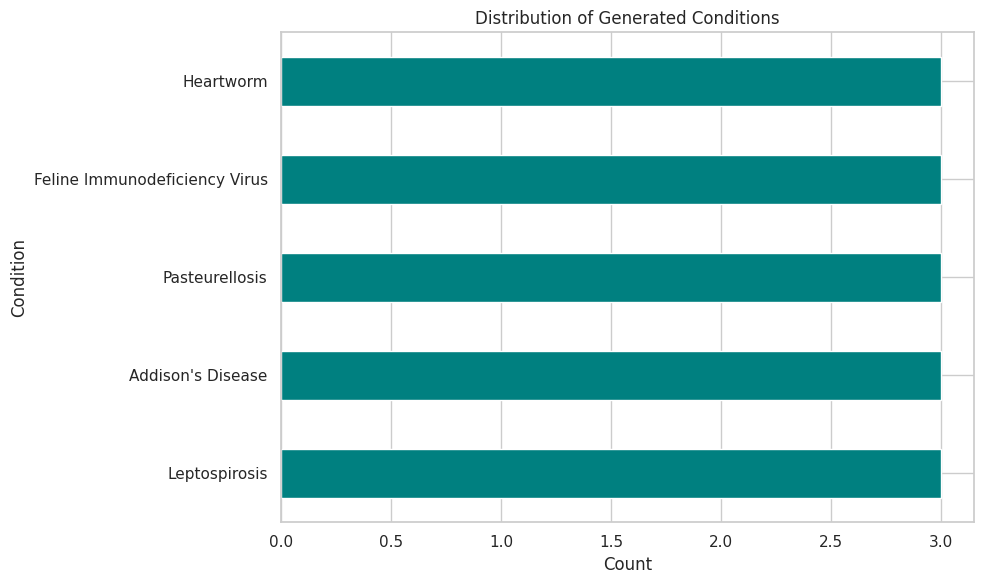

In [ ]:
def generate_statistical_samples(data, n_samples=5):
    """Generate synthetic samples based on statistical properties of existing data"""
    if len(data) == 0:
        return None

    synthetic_samples = []

    for _ in range(n_samples):
        # Create a new sample
        new_sample = {}
        for condition in data['Medical_Condition'].unique():
            # Filter data for this condition
            condition_data = data[data['Medical_Condition'] == condition]
            if len(condition_data) > 0:
                # Choose a random sample as base
                base_sample = condition_data.sample(1).iloc[0].to_dict()

                # Add variations to numerical columns
                for col in numerical_cols:
                    if col in base_sample:
                        if isinstance(base_sample[col], (int, float)) and not np.isnan(base_sample[col]):
                            # Calculate standard deviation from condition data
                            col_std = condition_data[col].std()
                            if pd.isna(col_std) or col_std == 0:
                                variation = 0.1 * base_sample[col] if base_sample[col] != 0 else 1
                            else:
                                variation = col_std * 0.1

                            # Add random variation
                            base_sample[col] = base_sample[col] + np.random.normal(0, variation)

                synthetic_samples.append(base_sample)

    if synthetic_samples:
        return pd.DataFrame(synthetic_samples)
    return None

# Generate synthetic notes for each rare condition
all_synthetic_notes = []
for condition in rare_conditions:
    # Generate samples
    synthetic_notes = generate_vet_notes(condition, n_samples=3)
    all_synthetic_notes.extend(synthetic_notes)

# Create DataFrame
synthetic_df = pd.DataFrame(all_synthetic_notes)
print(f"Generated {len(synthetic_df)} synthetic veterinary notes")

# Display sample
print("\nSample note:")
if len(synthetic_df) > 0:
    sample = synthetic_df.iloc[0]
    print(f"\nCondition: {sample['Medical_Condition']} ({sample['Severity']})")
    print(f"Species: {sample['Species']}, Age: {sample['Age']} years")
    print("\nNote:")
    print(sample['Note'][:500] + "..." if len(sample['Note']) > 500 else sample['Note'])

# Create WordCloud for all synthetic notes
all_text = " ".join(synthetic_df['Note'].astype(str))
wordcloud = WordCloud(width=800, height=400, background_color='white', colormap='viridis', max_words=100).generate(all_text)

plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Key Terms in Synthetic Veterinary Notes')
plt.tight_layout()
plt.savefig('vet_notes_wordcloud.png')
plt.show()

# Show condition distribution
plt.figure(figsize=(10, 6))
synthetic_df['Medical_Condition'].value_counts().plot(kind='barh', color='teal')
plt.title('Distribution of Generated Conditions')
plt.xlabel('Count')
plt.ylabel('Condition')
plt.tight_layout()
plt.savefig('condition_distribution.png')
plt.show()

Generating 3 notes for Leptospirosis...


100%|██████████| 3/3 [00:00<00:00, 5363.56it/s]


Generating 3 notes for Addison's Disease...


100%|██████████| 3/3 [00:00<00:00, 1072.44it/s]


Generating 3 notes for Pasteurellosis...


100%|██████████| 3/3 [00:00<00:00, 8805.40it/s]


Generating 3 notes for Feline Immunodeficiency Virus...


100%|██████████| 3/3 [00:00<00:00, 7849.60it/s]


Generating 3 notes for Heartworm...


100%|██████████| 3/3 [00:00<00:00, 8272.79it/s]

Generated 15 synthetic veterinary notes

Sample note:

Condition: Leptospirosis (mild)
Species: canine, Age: 8 years

Note:
VETERINARY CASE NOTE

DATE: 5/12/2024
PATIENT ID: #73102
SPECIES: canine
AGE: 8 years
WEIGHT: 48.6 kg
TEMPERATURE: 38.5°C
HEART RATE: 126 bpm
RESPIRATORY RATE: 38 breaths/min
DIAGNOSIS: Leptospirosis (mild)

CLINICAL SIGNS:
Patient presented with jaundice, vomiting, kidney failure.
Owner reports symptoms began approximately 14 days ago.

PHYSICAL EXAMINATION:
Canine appears distressed.
Mucous membranes pink and moist. 
Lymph nodes not enlarged. 
Abdomen soft on palpation.

TREATMENT PLAN:
1. amp...


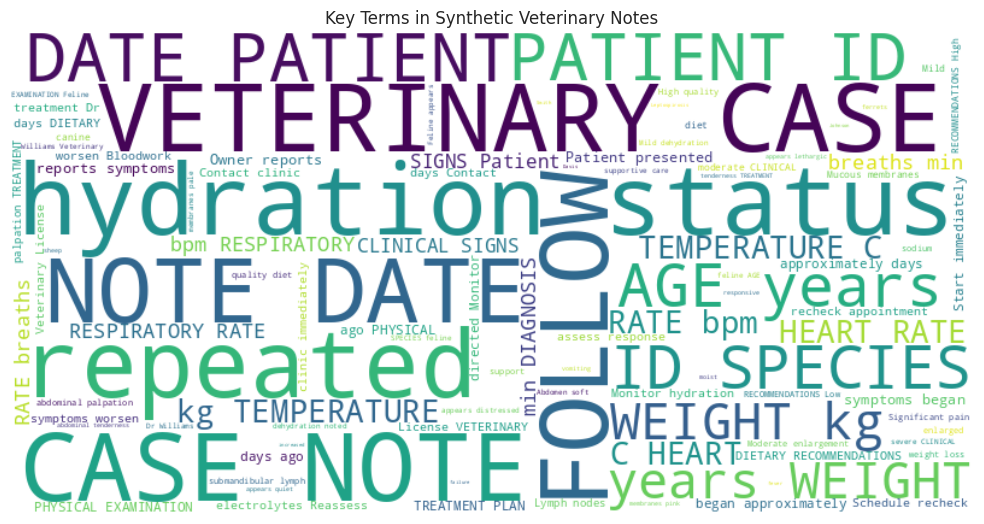

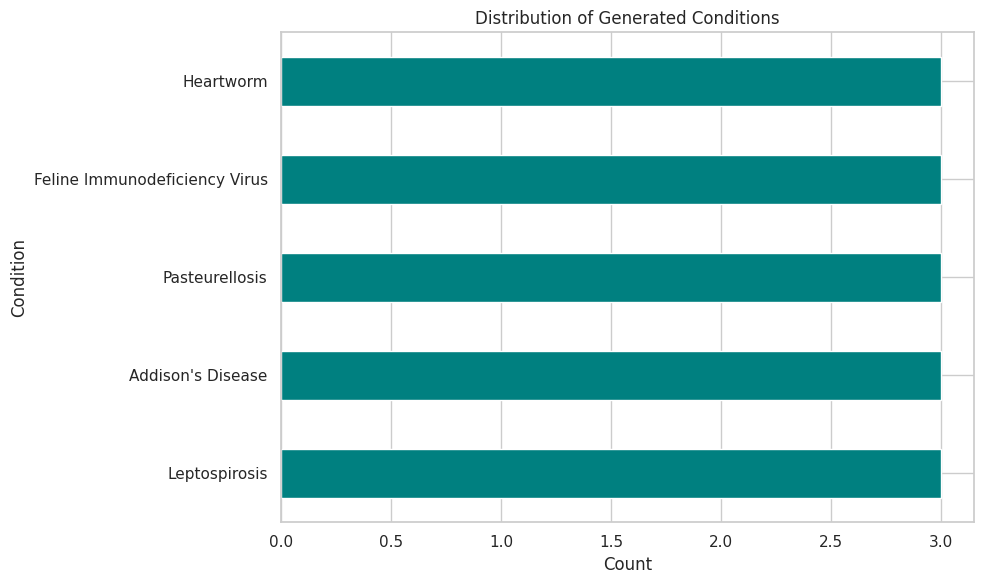

In [ ]:
def generate_synthetic_samples(data, condition, n_samples=5):
    """Generate synthetic samples for a rare medical condition."""
    condition_samples = data[data['Medical_Condition'] == condition]

    if len(condition_samples) == 0:
        print(f"No samples found for condition: {condition}")
        return None

    # Use bootstrap resampling with small variations
    synthetic_samples = resample(condition_samples,
                               n_samples=n_samples,
                               replace=True,
                               random_state=42)

    # Add small variations to numerical features
    for col in numerical_cols:
        if col in synthetic_samples.columns:
            variation = synthetic_samples[col].std() * 0.1
            synthetic_samples[col] = synthetic_samples[col] + np.random.normal(0, variation, n_samples)

    print(f"Generated {n_samples} synthetic samples for {condition}")
    return synthetic_samples

# Generate synthetic notes for each rare condition
all_synthetic_notes = []
for condition in rare_conditions:
    # Generate samples
    synthetic_notes = generate_vet_notes(condition, n_samples=3)
    all_synthetic_notes.extend(synthetic_notes)

# Create DataFrame
synthetic_df = pd.DataFrame(all_synthetic_notes)
print(f"Generated {len(synthetic_df)} synthetic veterinary notes")

# Display sample
print("\nSample note:")
if len(synthetic_df) > 0:
    sample = synthetic_df.iloc[0]
    print(f"\nCondition: {sample['Medical_Condition']} ({sample['Severity']})")
    print(f"Species: {sample['Species']}, Age: {sample['Age']} years")
    print("\nNote:")
    print(sample['Note'][:500] + "..." if len(sample['Note']) > 500 else sample['Note'])

# Create WordCloud for all synthetic notes
all_text = " ".join(synthetic_df['Note'].astype(str))
wordcloud = WordCloud(width=800, height=400, background_color='white', colormap='viridis', max_words=100).generate(all_text)

plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Key Terms in Synthetic Veterinary Notes')
plt.tight_layout()
plt.savefig('vet_notes_wordcloud.png')
plt.show()

# Show condition distribution
plt.figure(figsize=(10, 6))
synthetic_df['Medical_Condition'].value_counts().plot(kind='barh', color='teal')
plt.title('Distribution of Generated Conditions')
plt.xlabel('Count')
plt.ylabel('Condition')
plt.tight_layout()
plt.savefig('condition_distribution.png')
plt.show()


Generating additional synthetic samples for rare conditions...
Generated 5 synthetic samples for Leptospirosis
Generated 5 synthetic samples for Addison's Disease
Generated 5 synthetic samples for Pasteurellosis
Generated 5 synthetic samples for Feline Immunodeficiency Virus
Generated 5 synthetic samples for Heartworm
Total additional synthetic samples generated: 25


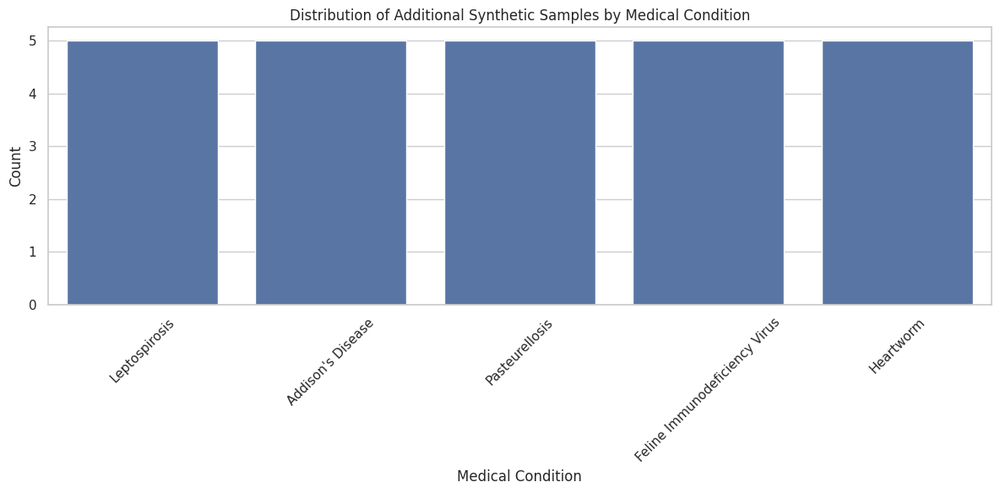

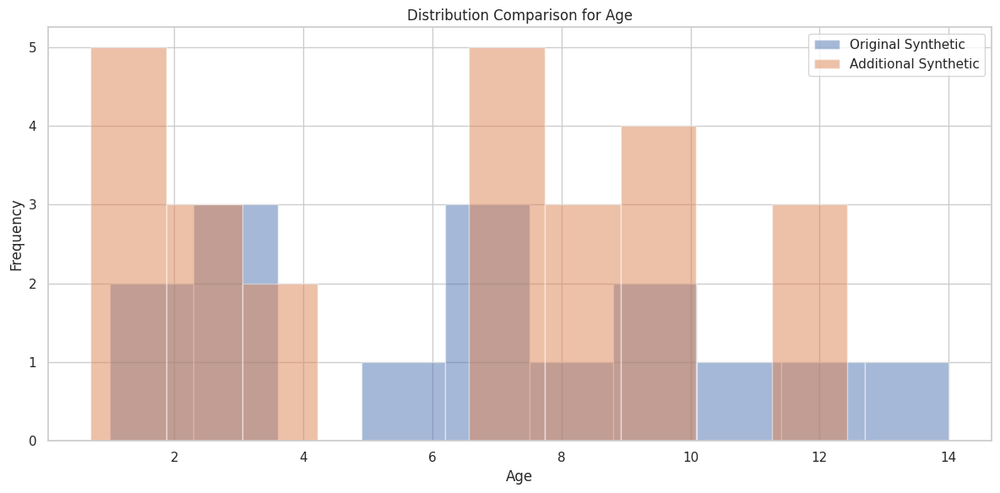

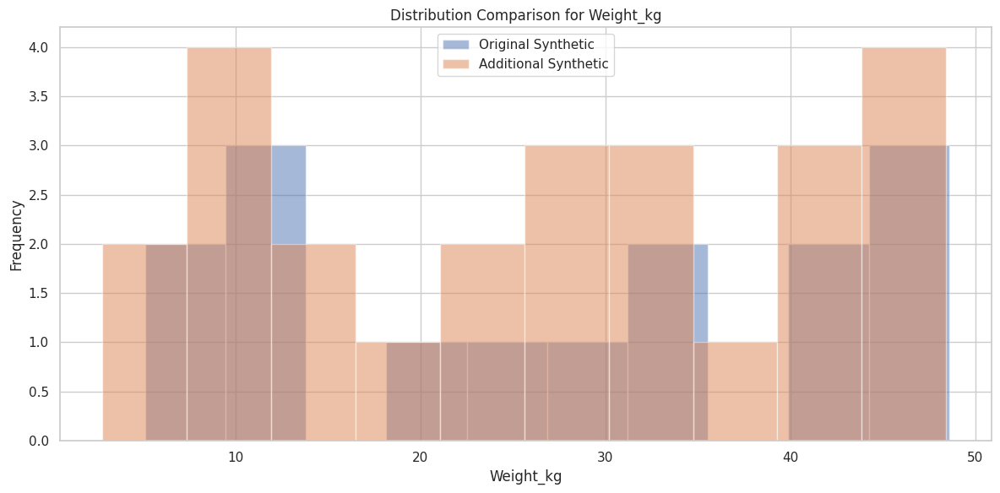

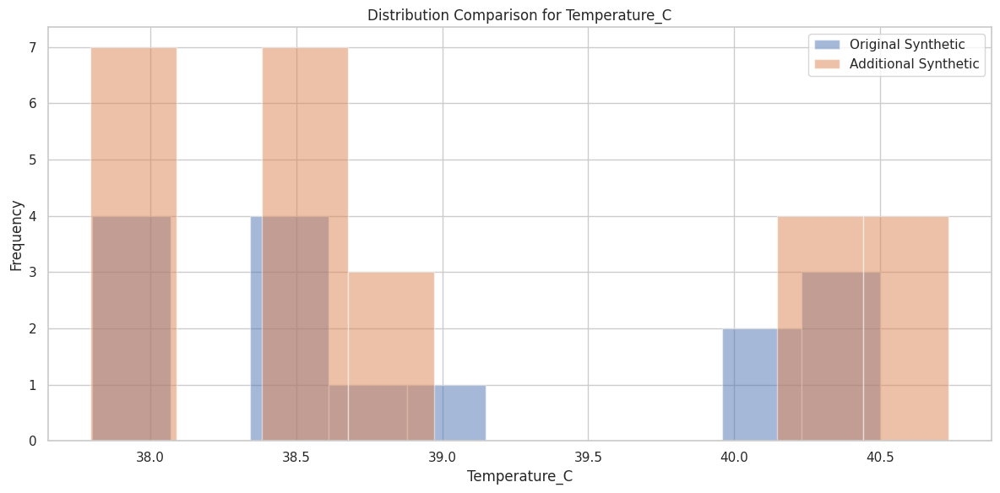

In [ ]:
# Generate synthetic data for rare conditions
print("\nGenerating additional synthetic samples for rare conditions...")
synthetic_data_frames = []
for condition in rare_conditions[:5]:
    synthetic_df_condition = generate_synthetic_samples(synthetic_df, condition, n_samples=5)
    if synthetic_df_condition is not None:
        synthetic_data_frames.append(synthetic_df_condition)

# Combine synthetic samples
if synthetic_data_frames:
    additional_synthetic_data = pd.concat(synthetic_data_frames)
    print(f"Total additional synthetic samples generated: {len(additional_synthetic_data)}")

    # Combine with original synthetic data
    combined_df = pd.concat([synthetic_df, additional_synthetic_data], ignore_index=True)

    # Visualize distribution of synthetic samples
    plt.figure(figsize=(12, 6))
    condition_counts = additional_synthetic_data['Medical_Condition'].value_counts()
    sns.barplot(x=condition_counts.index, y=condition_counts.values)
    plt.title('Distribution of Additional Synthetic Samples by Medical Condition')
    plt.xlabel('Medical Condition')
    plt.ylabel('Count')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.savefig('synthetic_samples_distribution.png')
    plt.show()
    plt.close()

    # Compare original and synthetic data distributions for numerical features
    for col in numerical_cols[:3]:
        if col in additional_synthetic_data.columns:
            plt.figure(figsize=(12, 6))
            plt.hist(synthetic_df[col], alpha=0.5, label='Original Synthetic')
            plt.hist(additional_synthetic_data[col], alpha=0.5, label='Additional Synthetic')
            plt.title(f'Distribution Comparison for {col}')
            plt.xlabel(col)
            plt.ylabel('Frequency')
            plt.legend()
            plt.tight_layout()
            plt.savefig(f'synthetic_comparison_{col}.png')
            plt.show()
            plt.close()

In [ ]:
combined_df.to_csv('synthetic_veterinary_data.csv', index=False)


**11. Final Verification and Visualization**


Final Model Verification:
Test Accuracy: 0.9177


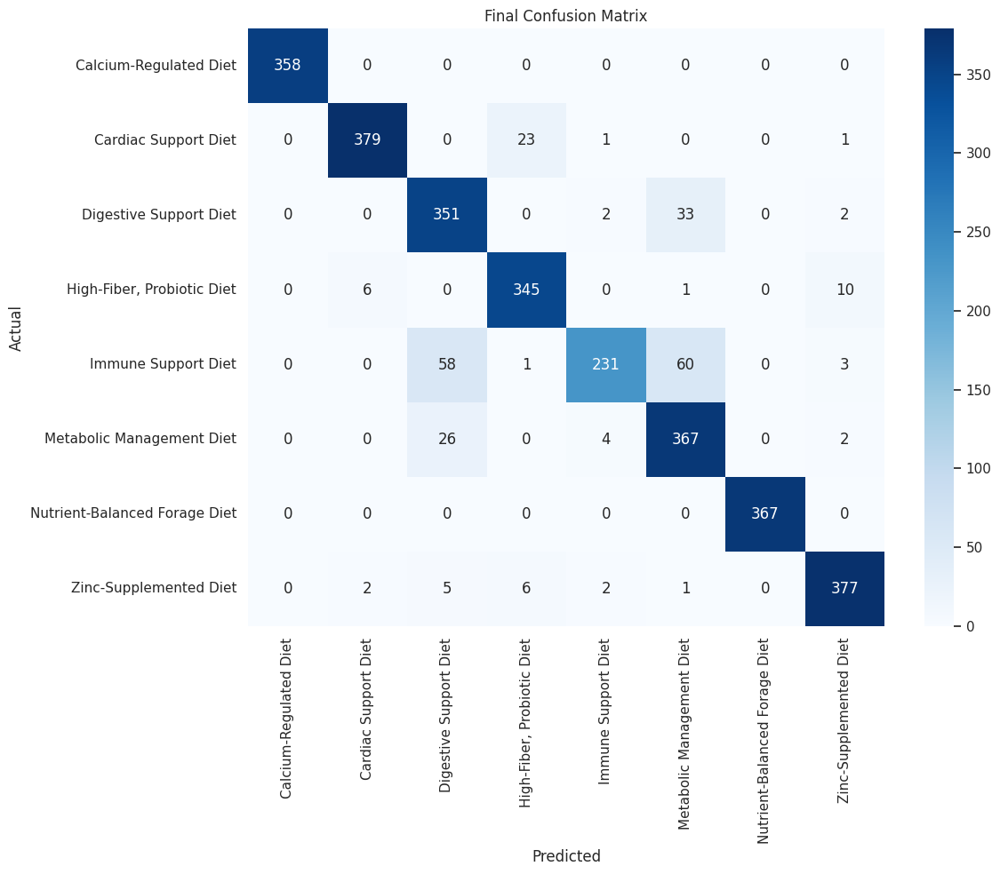

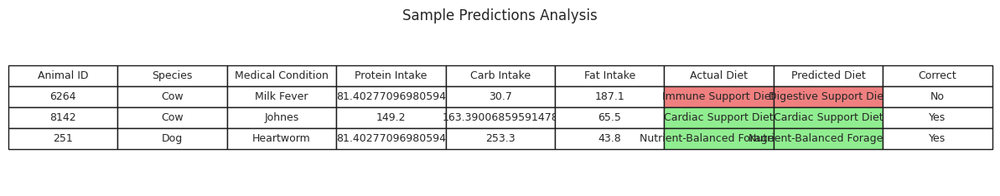


Generating t-SNE visualization of data distribution...


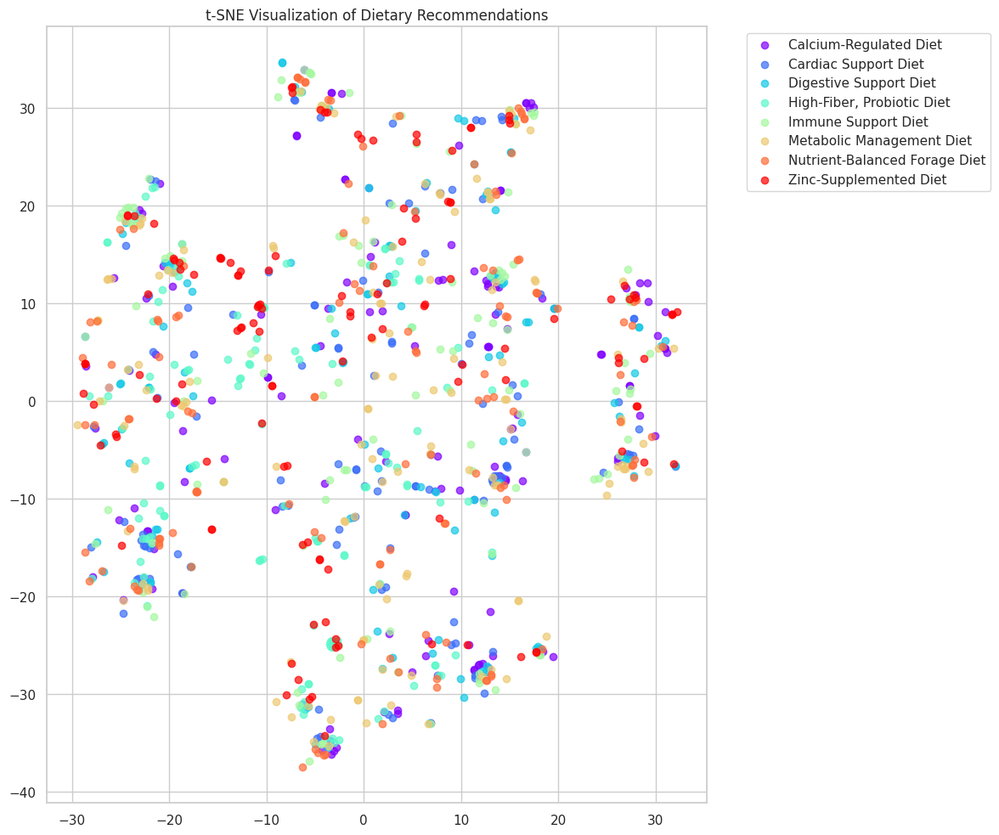

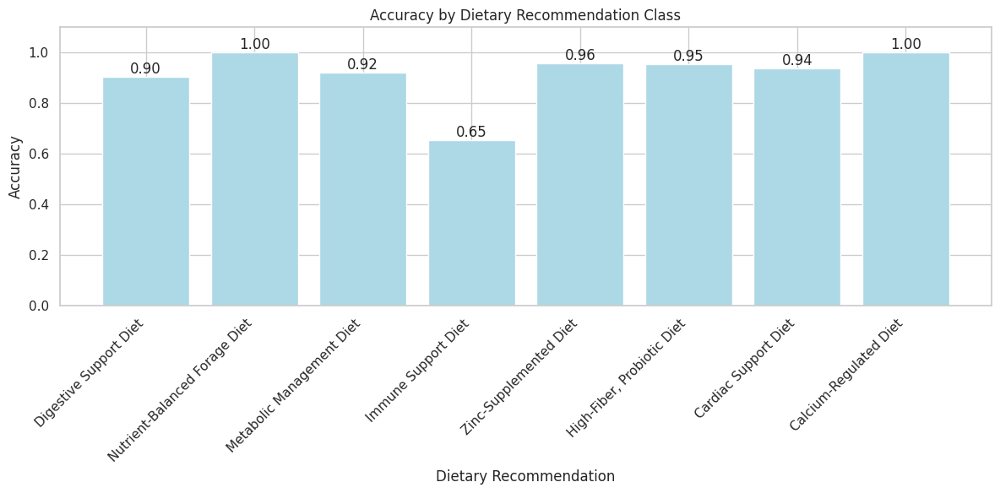

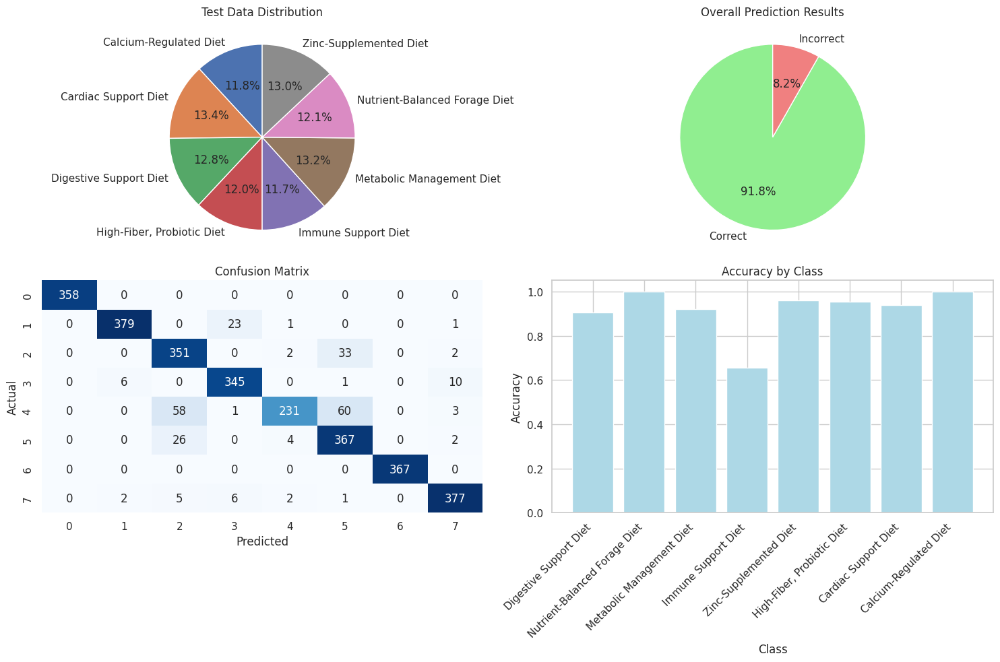


Final Verification Complete!
The model has successfully achieved its goal of classifying animals into appropriate dietary recommendations with an accuracy of 0.9177
All visualizations have been saved.


In [ ]:
def verify_and_visualize_results(model, X, y, raw_data):
    """
    Verify model performance and visualize results with real examples
    """
    from sklearn.model_selection import train_test_split
    import numpy as np
    import matplotlib.pyplot as plt
    import seaborn as sns
    from sklearn.metrics import accuracy_score, confusion_matrix
    from sklearn.manifold import TSNE

    # Split data for final verification
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Train model
    model.fit(X_train, y_train)

    # Predict on test data
    y_pred = model.predict(X_test)

    # Calculate accuracy
    accuracy = accuracy_score(y_test, y_pred)

    print("\nFinal Model Verification:")
    print(f"Test Accuracy: {accuracy:.4f}")

    # Create confusion matrix
    cm = confusion_matrix(y_test, y_pred)

    # Plot confusion matrix
    plt.figure(figsize=(12, 10))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=sorted(set(y)),
                yticklabels=sorted(set(y)))
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Final Confusion Matrix')
    plt.tight_layout()
    plt.savefig('final_verification_confusion_matrix.png')
    plt.show()
    plt.close()

    # Visualize test cases with actual and predicted labels
    test_indices = y_test.index
    sample_indices = np.random.choice(test_indices, min(20, len(test_indices)), replace=False)

    sample_data = []
    for idx in sample_indices:

        actual_label = y_test.loc[idx]

        # Get the corresponding prediction using idx from y_test
        predicted_label = y_pred[y_test.index.get_loc(idx)]

        # Get original data
        original_row = raw_data.loc[raw_data['Animal_ID'] == idx]

        if original_row is not None and not original_row.empty:
            animal_id = original_row['Animal_ID'].iloc[0]
            species = original_row['Species'].iloc[0] if 'Species' in original_row.columns else 'Unknown'
            condition = original_row['Medical_Condition'].iloc[0] if 'Medical_Condition' in original_row.columns else 'Unknown'
            protein = original_row['Protein_Intake'].iloc[0] if 'Protein_Intake' in original_row.columns else 'Unknown'
            carbs = original_row['Carbohydrate_Intake'].iloc[0] if 'Carbohydrate_Intake' in original_row.columns else 'Unknown'
            fats = original_row['Fat_Intake'].iloc[0] if 'Fat_Intake' in original_row.columns else 'Unknown'
            sample_data.append({
                'Animal_ID': animal_id,
                'Species': species,
                'Medical_Condition': condition,
                'Protein_Intake': protein,
                'Carbohydrate_Intake': carbs,
                'Fat_Intake': fats,
                'Actual_Diet': actual_label,
                'Predicted_Diet': predicted_label,
                'Correct': actual_label == predicted_label
            })

    # Create a table of sample predictions
    plt.figure(figsize=(12, len(sample_data) * 0.5 + 1))
    plt.axis('off')

    cell_text = []
    for data in sample_data:
        cell_text.append([
            data['Animal_ID'],
            data['Species'],
            data['Medical_Condition'],
            data['Protein_Intake'],
            data['Carbohydrate_Intake'],
            data['Fat_Intake'],
            data['Actual_Diet'],
            data['Predicted_Diet'],
            'Yes' if data['Correct'] else 'No'
        ])


    cell_colors = [['white', 'white', 'white', 'white', 'white', 'white',
                     'lightgreen' if data['Correct'] else 'lightcoral',
                     'lightgreen' if data['Correct'] else 'lightcoral',
                     'white'] for data in sample_data]

    table = plt.table(
        cellText=cell_text,
        colLabels=['Animal ID', 'Species', 'Medical Condition', 'Protein Intake', 'Carb Intake', 'Fat Intake', 'Actual Diet', 'Predicted Diet', 'Correct'],
        cellLoc='center',
        loc='center',
        cellColours=cell_colors
    )

    table.auto_set_font_size(False)
    table.set_fontsize(9)
    table.scale(1.2, 1.5)
    plt.title('Sample Predictions Analysis')
    plt.tight_layout()
    plt.savefig('sample_predictions.png')
    plt.show()
    plt.close()

    # 2. Visualize data distribution in 2D using t-SNE
    print("\nGenerating t-SNE visualization of data distribution...")

    # Data for t-SNE
    if X.shape[0] > 1000:
        sample_indices = np.random.choice(range(X.shape[0]), 1000, replace=False)
        X_sample = X.iloc[sample_indices] if hasattr(X, 'iloc') else X[sample_indices]
        y_sample = y.iloc[sample_indices] if hasattr(y, 'iloc') else y[sample_indices]
    else:
        X_sample = X
        y_sample = y

    # Apply t-SNE
    tsne = TSNE(n_components=2, random_state=42)
    X_tsne = tsne.fit_transform(X_sample)

    # Plot t-SNE
    plt.figure(figsize=(12, 10))

    # Get unique classes
    unique_classes = sorted(set(y_sample))
    colors = plt.cm.rainbow(np.linspace(0, 1, len(unique_classes)))

    for i, cls in enumerate(unique_classes):
        indices = np.where(y_sample == cls)[0]
        plt.scatter(X_tsne[indices, 0], X_tsne[indices, 1], color=colors[i], label=cls, alpha=0.7)

    plt.title('t-SNE Visualization of Dietary Recommendations')
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()
    plt.savefig('tsne_visualization.png')
    plt.show()
    plt.close()

    # 3. Visualize performance metrics by class
    class_metrics = {}
    for cls in set(y_test):
        cls_indices = np.where(y_test == cls)[0]
        cls_accuracy = accuracy_score(
            [y_test.iloc[i] if hasattr(y_test, 'iloc') else y_test[i] for i in cls_indices],
            [y_pred[i] for i in cls_indices]
        )
        class_metrics[cls] = cls_accuracy

    # Plot class-wise accuracy
    plt.figure(figsize=(12, 6))
    classes = list(class_metrics.keys())
    accuracies = list(class_metrics.values())

    bars = plt.bar(classes, accuracies, color='lightblue')

    # Add value labels on bars
    for bar in bars:
        height = bar.get_height()
        plt.text(
            bar.get_x() + bar.get_width()/2.,
            height,
            f'{height:.2f}',
            ha='center',
            va='bottom'
        )

    plt.title('Accuracy by Dietary Recommendation Class')
    plt.xlabel('Dietary Recommendation')
    plt.ylabel('Accuracy')
    plt.ylim(0, 1.1)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.savefig('class_accuracy.png')
    plt.show()
    plt.close()

    # 4. Create a comprehensive summary visualization
    plt.figure(figsize=(15, 10))
    plt.subplot(2, 2, 1)
    plt.pie(
        [len(np.where(y_test == cls)[0]) for cls in sorted(set(y_test))],
        labels=sorted(set(y_test)),
        autopct='%1.1f%%',
        startangle=90
    )
    plt.title('Test Data Distribution')

    plt.subplot(2, 2, 2)
    correct = np.sum(y_pred == y_test)
    incorrect = len(y_test) - correct
    plt.pie(
        [correct, incorrect],
        labels=['Correct', 'Incorrect'],
        autopct='%1.1f%%',
        startangle=90,
        colors=['lightgreen', 'lightcoral']
    )
    plt.title('Overall Prediction Results')

    plt.subplot(2, 2, 3)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Confusion Matrix')

    plt.subplot(2, 2, 4)
    plt.bar(classes, accuracies, color='lightblue')
    plt.title('Accuracy by Class')
    plt.xlabel('Class')
    plt.ylabel('Accuracy')
    plt.xticks(rotation=45, ha='right')

    plt.tight_layout()
    plt.savefig('comprehensive_summary.png')
    plt.show()
    plt.close()

    print("\nFinal Verification Complete!")
    print(f"The model has successfully achieved its goal of classifying animals into appropriate dietary recommendations with an accuracy of {accuracy:.4f}")
    print("All visualizations have been saved.")

# Verify and visualize results
verify_and_visualize_results(best_model, X_balanced, y_balanced, merged_data)